# Regression-based macro trading signals

This notebook illustrates the points discussed in the post [“Regression-based macro trading signals”](https://research.macrosynergy.com/regression-signals/) on the Macrosynergy website. It demonstrates how regression models can formulate trading signals based on macro indicators using the [`macrosynergy.learning`](https://docs.macrosynergy.com/macrosynergy/learning/index.html) subpackage, together with the popular [`scikit-learn`](https://scikit-learn.org/stable/index.html) package. The post applies a variety of statistical regression models to construct macro trading signals across three different asset class datasets (5-year interest rate swaps, equity index futures, and FX forward contracts). It summarizes both theoretical basics and empirical findings in order to provide guidance on using a variety of regression methods for macro trading strategy development. 

    
The notebook is organized into four main sections:

- __Get Packages and JPMaQS Data:__ This section is dedicated to installing and importing the necessary Python packages for the analysis. It includes standard Python libraries like pandas and seaborn, as well as the `scikit-learn` package and the specialized `macrosynergy` package.

- __Transformations and Checks:__  In this part, the notebook conducts data calculations and transformations to derive relevant signals and targets for the analysis. This involves normalizing feature variables using z-scores and constructing simple linear composite indicators. The notebook tests three different strategies for the three major asset classes, and for each strategy, it considers a different set of plausible and speculative features. Every strategy calculates a conceptual risk parity signal, which is an unweighted average of plausible z-scored features for each strategy. These signals are assigned postfix `_AVGZ`

    - Duration strategy, with conceptual risk parity signal `DU_AVGZ`. Please see [The power of macro trends in rates markets](https://research.macrosynergy.com/the-power-of-macro-trends-in-rates-markets/) for the original version of this strategy
    - Equity strategy, with conceptual risk parity signal `EQ_AVGZ`. Please see [Equity trend following and macro headwinds](https://research.macrosynergy.com/equity-trend-following-and-macro-headwinds/) for the original version of this strategy
    - FX strategy, with conceptual risk parity signal `FX_AVGZ`. Please see [Pure macro FX strategies: the benefits of double diversification](https://research.macrosynergy.com/pure-macro-fx-strategies-the-benefits-of-double-diversification/) for the original version of this strategy


- __Predictions:__ The third part compares different regression-based signals with a natural benchmark, either a different regression-based signal or a conceptual risk parity signal, across rates, equity, and FX datasets. Signal comparison is done by three main criteria:
    - __Correlation coefficients__ of the relation between month-end signals and next month's target returns.
    - __Accuracy and balanced accuracy__ of month-end signal-based predictions of the direction of next month’s returns. 
    - __Sharpe and Sortino ratios of naïve PnLs__

- __Regression comparisons:__ This part of the notebook compares first the average performance of the optimized OLS model from the previous section (averaged across rates, equity and FX strategies) with conceptual risk parity signal performance (also averaged across the three main strategies). Furthermore, additional optimized regression-based signals are compared to relevant benchmark models. Explored models are tested across each strategy (rates, equity, and FX), and key comparison parameters are averaged across these strategies and summarized in respective tables. The tested regression techniques  include:

    - [Non-negative least squares](https://academy.macrosynergy.com/academy/Data%20science/Regression-based%20macro%20trading%20signals/_build/html/Regression-based%20macro%20trading%20signals.php#non-negative-least-squares)
    - [Elastic net](https://academy.macrosynergy.com/academy/Data%20science/Regression-based%20macro%20trading%20signals/_build/html/Regression-based%20macro%20trading%20signals.php#elastic-net)
    - [Time-weighted least squares](https://academy.macrosynergy.com/academy/Data%20science/Regression-based%20macro%20trading%20signals/_build/html/Regression-based%20macro%20trading%20signals.php#time-weighted-least-squares)
    - [Sign-weighted least squares](https://academy.macrosynergy.com/academy/Data%20science/Regression-based%20macro%20trading%20signals/_build/html/Regression-based%20macro%20trading%20signals.php#sign-weighted-least-squares)
    - [Least absolute deviations](https://academy.macrosynergy.com/academy/Data%20science/Regression-based%20macro%20trading%20signals/_build/html/Regression-based%20macro%20trading%20signals.php#least-absolute-deviations)
    - [KNN](https://academy.macrosynergy.com/academy/Data%20science/Regression-based%20macro%20trading%20signals/_build/html/Regression-based%20macro%20trading%20signals.php#knn)
    
A regression-based trading signal is a modified point-in-time regression forecast of returns. A regression model can employ several features (explanatory variables) and assign effective weights based on their past relations to target financial returns. The construction of point-in-time regression-based forecasts relies on a statistical learning process that generally involves three operations: 
1.	the sequential choice of an optimal regression model, based on past predictive performance, 
2.	a point-in-time estimation of its coefficients, and 
3.	the prediction of future returns based on that model.

This general method is attractive because regression is a well-understood way of relating explanatory/predictor variables (features) with dependent variables, here called target returns. 

**NOTE:** This notebook is memory-intensive and time-intensive.

## Get packages and JPMaQS data

This notebook primarily relies on the standard packages available in the Python data science stack. However, the `macrosynergy` package is additionally required for two purposes:

- Downloading JPMaQS data: The macrosynergy package facilitates the retrieval of JPMaQS data used in the notebook. For users using the free [Kaggle subset](https://www.kaggle.com/datasets/macrosynergy/fixed-income-returns-and-macro-trends), this part of the `macrosynergy` package is not required.

- For analyzing quantamental data and value propositions: The macrosynergy package provides functionality for performing quick analyses of quantamental data and exploring value propositions. The subpackage [macrosynergy.learning](https://docs.macrosynergy.com/macrosynergy/learning/index.html) integrates the `macrosynergy` package and associated JPMaQS data with the widely-used `scikit-learn` library and is used for sequential signal optimization. 

For detailed information and a comprehensive understanding of the macrosynergy package and its functionalities, please refer to the [“Introduction to Macrosynergy package”](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php) notebook on the Macrosynergy Quantamental Academy or visit the following [link](https://www.kaggle.com/code/macrosynergy/introduction-to-macrosynergy-package) on Kaggle.

In [1]:
# Run only if needed!
"""
# %%capture
! pip install macrosynergy --upgrade"""

'\n# %%capture\n! pip install macrosynergy --upgrade'

In [2]:
import os
import numpy as np
import pandas as pd

from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression, ElasticNet
from sklearn.neighbors import KNeighborsRegressor

from sklearn.metrics import (
    make_scorer,
    r2_score,
)

import macrosynergy.management as msm
import macrosynergy.panel as msp
import macrosynergy.pnl as msn
import macrosynergy.signal as mss
import macrosynergy.learning as msl
from macrosynergy.download import JPMaQSDownload

import warnings

warnings.simplefilter("ignore")

The JPMaQS indicators we consider are downloaded using the J.P. Morgan Dataquery API interface within the `macrosynergy` package. This is done by specifying ticker strings, formed by appending an indicator category code <category> to a currency area code <cross_section>. These constitute the main part of a full quantamental indicator ticker, taking the form `DB(JPMAQS,<cross_section>_<category>,<info>)`, where <info> denotes the time series of information for the given cross-section and category. The following types of information are available:

`value` giving the latest available values for the indicator
`eop_lag` referring to days elapsed since the end of the observation period
`mop_lag` referring to the number of days elapsed since the mean observation period
`grade` denoting a grade of the observation, giving a metric of real time information quality.

After instantiating the `JPMaQSDownload` class within the `macrosynergy.download` module, one can use the `download(tickers,start_date,metrics)` method to easily download the necessary data, where `tickers` is an array of ticker strings, `start_date` is the first collection date to be considered and `metrics` is an array comprising the times series information to be downloaded. For more information see [here](https://github.com/macrosynergy/macrosynergy/blob/develop/README.md) or use the free dataset on [Kaggle](https://www.kaggle.com/datasets/macrosynergy/fixed-income-returns-and-macro-trends). 

In the cell below, we specified cross-sections used for the analysis. For the abbreviations, please see [About Dataset](https://www.kaggle.com/datasets/macrosynergy/fixed-income-returns-and-macro-trends)

In [3]:
# Cross-sections of interest - duration

cids_dm = ["AUD", "CAD", "CHF", "EUR", "GBP", "JPY", "NOK", "NZD", "SEK", "USD"]
cids_em = [
    "CLP",
    "COP",
    "CZK",
    "HUF",
    "IDR",
    "ILS",
    "INR",
    "KRW",
    "MXN",
    "PLN",
    "THB",
    "TRY",
    "TWD",
    "ZAR",
]
cids_du = cids_dm + cids_em
cids_dux = list(set(cids_du) - set(["IDR", "NZD"]))
cids_xg2 = list(set(cids_dux) - set(["EUR", "USD"]))

# Cross-sections of interest - equity

cids_g3 = ["EUR", "JPY", "USD"]  # DM large currency areas
cids_dmes = ["AUD", "CAD", "CHF", "GBP", "SEK"]  # Smaller DM equity countries
cids_eq = cids_g3 + cids_dmes  # DM equity countries

# Cross-sections of interest - FX
cids_dmsc = ["AUD", "CAD", "CHF", "GBP", "NOK", "NZD", "SEK"]  # DM small currency areas
cids_latm = ["BRL", "COP", "CLP", "MXN", "PEN"]  # Latam
cids_emea = ["CZK", "HUF", "ILS", "PLN", "RON", "RUB", "TRY", "ZAR"]  # EMEA
cids_emas = ["IDR", "INR", "KRW", "MYR", "PHP", "SGD", "THB", "TWD"]  # EM Asia ex China

cids_dm = cids_g3 + cids_dmsc
cids_em = cids_latm + cids_emea + cids_emas
cids = cids_dm + cids_em

cids_nofx = [
    "EUR",
    "USD",
    "JPY",
    "THB",
    "SGD",
    "RUB",
]  # not small or suitable for this analysis for lack of data
cids_fx = list(set(cids) - set(cids_nofx))

cids_dmfx = list(set(cids_dm).intersection(cids_fx))
cids_emfx = list(set(cids_em).intersection(cids_fx))

cids_eur = ["CHF", "CZK", "HUF", "NOK", "PLN", "RON", "SEK"]  # trading against EUR
cids_eud = ["GBP", "TRY"]  # trading against EUR and USD
cids_usd = list(set(cids_fx) - set(cids_eur + cids_eud))  # trading against USD

In [4]:
# Quantamental categories of interest

infs = [
    "CPIH_SA_P1M1ML12",
    "CPIC_SJA_P6M6ML6AR",
    "INFTEFF_NSA",
    "WAGES_NSA_P1M1ML12_3MMA",
    "PPIH_NSA_P1M1ML12",
]
grow = [
    "PCREDITBN_SJA_P1M1ML12",
    "RGDP_SA_P1Q1QL4_20QMA",
    "RGDP_SA_P1Q1QL4_20QMM",
    "INTRGDP_NSA_P1M1ML12_3MMA",
    "INTRGDPv5Y_NSA_P1M1ML12_3MMA",
    "RGDPTECH_SA_P1M1ML12_3MMA",
    "RGDPTECHv5Y_SA_P1M1ML12_3MMA",
    "IP_SA_P1M1ML12_3MMA",
]
surv = [
    "MBCSCORE_SA_D3M3ML3",
    "MBCSCORE_SA_D1Q1QL1",
    "MBCSCORE_SA_D6M6ML6",
    "MBCSCORE_SA_D2Q2QL2",
]
labs = [
    "EMPL_NSA_P1M1ML12_3MMA",
    "EMPL_NSA_P1Q1QL4",
    "WFORCE_NSA_P1Y1YL1_5YMM",
    "UNEMPLRATE_NSA_3MMA_D1M1ML12",
    "UNEMPLRATE_NSA_D1Q1QL4",
    "UNEMPLRATE_SA_D3M3ML3",
    "UNEMPLRATE_SA_D1Q1QL1",
    "UNEMPLRATE_SA_3MMA",
    "UNEMPLRATE_SA_3MMAv5YMM",
]

xbls = [
    "MTBGDPRATIO_SA_3MMA_D1M1ML3",
    "CABGDPRATIO_SA_3MMA_D1M1ML3",
    "CABGDPRATIO_SA_1QMA_D1Q1QL1",
    "MTBGDPRATIO_SA_6MMA_D1M1ML6",
    "CABGDPRATIO_SA_6MMA_D1M1ML6",
    "CABGDPRATIO_SA_2QMA_D1Q1QL2",
    "MTBGDPRATIO_SA_3MMAv60MMA",
    "CABGDPRATIO_SA_3MMAv60MMA",
    "CABGDPRATIO_SA_1QMAv20QMA",
]
tots = [
    "CTOT_NSA_P1M12ML1",
    "CTOT_NSA_P1M1ML12",
    "CTOT_NSA_P1M60ML1",
    "MTOT_NSA_P1M12ML1",
    "MTOT_NSA_P1M1ML12",
    "MTOT_NSA_P1M60ML1",
]

main = infs + grow + surv + labs + xbls + tots


mkts = [
    "FXTARGETED_NSA",
    "FXUNTRADABLE_NSA",
]

rets = [
    "DU05YXR_VT10",
    "EQXR_VT10",
    "EQXR_NSA",
    "FXXR_VT10",
]

xcats = main + mkts + rets

# Resultant tickers for download

single_tix = ["USD_GB10YXR_NSA"]
tickers = [cid + "_" + xcat for cid in cids for xcat in xcats] + single_tix

The description of each JPMaQS category is available either on the Macrosynergy Macro Quantamental Academy, or on JPMorgan Markets (password protected). In particular, the set used for this notebook is using [Consumer price inflation trends](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Consumer%20price%20inflation%20trends.php), [Inflation targets](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Inflation%20targets.php), [Wage growth](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Wage%20growth.php?highlight=wages_nsa), [PPI Inflation](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Producer%20price%20inflation.php?highlight=ppih_nsa#standard-ppi-inflation),  [Intuitive growth estimates](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Intuitive%20GDP%20growth%20estimates.php), [Domestic credit ratios](https://academy.macrosynergy.com/academy/Themes/Macroeconomic%20balance%20sheets/_build/html/notebooks/Domestic%20credit%20ratios.php), [GDP growth](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/GDP%20growth.php?highlight=gdp%20growth), [Technical GDP growth estimates](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Technical%20GDP%20growth%20estimates.php#), [Industrial production trends](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Industrial%20production%20trends.php?highlight=ip_sa), [Private credit expansion](https://academy.macrosynergy.com/academy/Themes/Financial%20conditions/_build/html/notebooks/Private%20credit%20expansion.php), [Manufacturing confidence scores](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Manufacturing%20confidence%20scores.php), [Demographic trends](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Demographic%20trends.php), [Labor market dynamics](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Labor%20market%20dynamics.php), [External ratios trends](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/External%20ratios%20trends.php), [Terms-of-trade](https://academy.macrosynergy.com/academy/Themes/Financial%20conditions/_build/html/notebooks/Terms-of-trade.php), [Duration returns](https://academy.macrosynergy.com/academy/Themes/Generic%20returns/_build/html/notebooks/Duration%20returns.php), [Equity index future returns](https://academy.macrosynergy.com/academy/Themes/Generic%20returns/_build/html/notebooks/Equity%20index%20future%20returns.php), [FX forward returns](https://academy.macrosynergy.com/academy/Themes/Generic%20returns/_build/html/notebooks/FX%20forward%20returns.php), and [FX tradeability and flexibility](https://academy.macrosynergy.com/academy/Themes/Stylized%20trading%20factors/_build/html/notebooks/FX%20tradeability%20and%20flexibility.php)

In [5]:
# Download series from J.P. Morgan DataQuery by tickers

start_date = "2000-01-01"
end_date = None

# Retrieve credentials

oauth_id = os.getenv("DQ_CLIENT_ID")  # Replace with own client ID
oauth_secret = os.getenv("DQ_CLIENT_SECRET")  # Replace with own secret

# Download from DataQuery

with JPMaQSDownload(client_id=oauth_id, client_secret=oauth_secret) as downloader:
    df = downloader.download(
        tickers=tickers,
        start_date=start_date,
        end_date=end_date,
        metrics=["value"],
        suppress_warning=True,
        show_progress=True,
    )

dfx = df.copy()
dfx.info()

Timestamp UTC:  2024-12-03 16:32:42
Connection successful!


Requesting data: 100%|█████████████████████████████████████████████████████████████████| 73/73 [00:16<00:00,  4.48it/s]


Some expressions are missing from the downloaded data. Check logger output for complete list.
305 out of 1458 expressions are missing. To download the catalogue of all available expressions and filter the unavailable expressions, set `get_catalogue=True` in the call to `JPMaQSDownload.download()`.
Some dates are missing from the downloaded data. 
2 out of 6504 dates are missing.
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7161911 entries, 0 to 7161910
Data columns (total 4 columns):
 #   Column     Dtype         
---  ------     -----         
 0   real_date  datetime64[ns]
 1   cid        object        
 2   xcat       object        
 3   value      float64       
dtypes: datetime64[ns](1), float64(1), object(2)
memory usage: 218.6+ MB


## Availability

It is essential to assess data availability before conducting any analysis. It allows for the identification of any potential gaps or limitations in the dataset, which can impact the validity and reliability of the analysis, ensure that a sufficient number of observations for each selected category and cross-section is available, and determine the appropriate periods for analysis. 

For the purpose of the below presentation, we have renamed a collection of quarterly-frequency indicators to approximate monthly equivalents in order to have a full panel of similar measures across most countries. The two series' are not identical but are close substitutes.

### Rename quarterly indicators

In [6]:
dict_repl = {
    "EMPL_NSA_P1Q1QL4": "EMPL_NSA_P1M1ML12_3MMA",
    "WFORCE_NSA_P1Q1QL4_20QMM": "WFORCE_NSA_P1Y1YL1_5YMM",
    "UNEMPLRATE_NSA_D1Q1QL4": "UNEMPLRATE_NSA_3MMA_D1M1ML12",
    "WAGES_NSA_P1Q1QL4": "WAGES_NSA_P1M1ML12_3MMA",
    "UNEMPLRATE_SA_D1Q1QL1": "UNEMPLRATE_SA_D3M3ML3",
    "CABGDPRATIO_SA_1QMA_D1Q1QL1": "CABGDPRATIO_SA_3MMA_D1M1ML3",
    "CABGDPRATIO_SA_2QMA_D1Q1QL2": "CABGDPRATIO_SA_6MMA_D1M1ML6",
    "CABGDPRATIO_SA_1QMAv20QMA": "CABGDPRATIO_SA_3MMAv60MMA",
    "MBCSCORE_SA_D1Q1QL1": "MBCSCORE_SA_D3M3ML3",
    "MBCSCORE_SA_D2Q2QL2": "MBCSCORE_SA_D6M6ML6",
}

for key, value in dict_repl.items():
    dfx["xcat"] = dfx["xcat"].str.replace(key, value)

### Check panel history

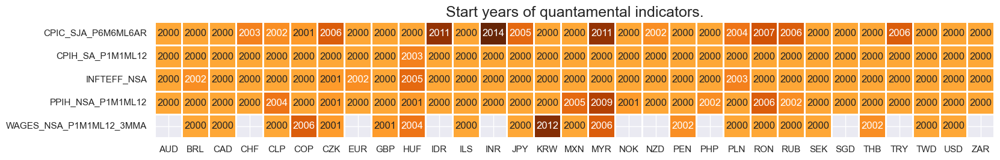

In [7]:
xcatx = infs
msm.check_availability(df=dfx, xcats=xcatx, cids=cids, missing_recent=False)

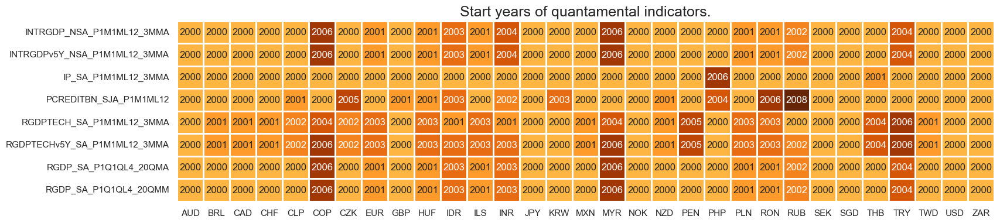

In [8]:
xcatx = grow
msm.check_availability(df=dfx, xcats=xcatx, cids=cids, missing_recent=False)

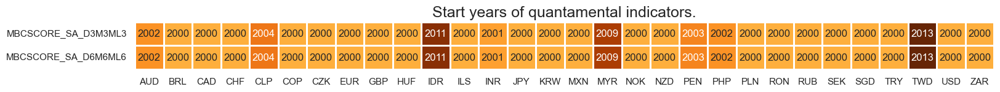

In [9]:
xcatx = surv
msm.check_availability(df=dfx, xcats=xcatx, cids=cids, missing_recent=False)

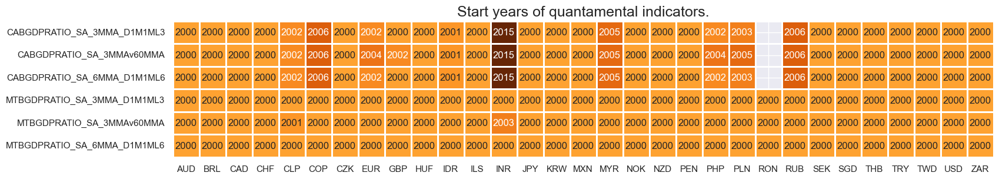

In [10]:
xcatx = xbls
msm.check_availability(df=dfx, xcats=xcatx, cids=cids, missing_recent=False)

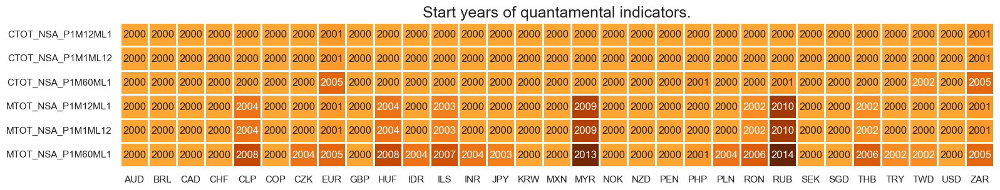

In [11]:
xcatx = tots
msm.check_availability(df=dfx, xcats=xcatx, cids=cids, missing_recent=False)

### FX-based blacklist dictionary

Identifying and isolating periods of official exchange rate targets, illiquidity, or convertibility-related distortions in FX markets is the first step in creating an FX trading strategy. These periods can significantly impact the behavior and dynamics of currency markets, and failing to account for them can lead to inaccurate or misleading findings. The [`make_blacklist()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#exclude-series-sections-with-make-blacklist) helper function creates a standardized dictionary of blacklist periods:

In [12]:
# Create blacklisting dictionary

dfb = df[df["xcat"].isin(["FXTARGETED_NSA", "FXUNTRADABLE_NSA"])].loc[
    :, ["cid", "xcat", "real_date", "value"]
]
dfba = (
    dfb.groupby(["cid", "real_date"])
    .aggregate(value=pd.NamedAgg(column="value", aggfunc="max"))
    .reset_index()
)
dfba["xcat"] = "FXBLACK"
fxblack = msp.make_blacklist(dfba, "FXBLACK")
fxblack

{'BRL': (Timestamp('2012-12-03 00:00:00'), Timestamp('2013-09-30 00:00:00')),
 'CHF': (Timestamp('2011-10-03 00:00:00'), Timestamp('2015-01-30 00:00:00')),
 'CZK': (Timestamp('2014-01-01 00:00:00'), Timestamp('2017-07-31 00:00:00')),
 'ILS': (Timestamp('2000-01-03 00:00:00'), Timestamp('2005-12-30 00:00:00')),
 'INR': (Timestamp('2000-01-03 00:00:00'), Timestamp('2004-12-31 00:00:00')),
 'MYR_1': (Timestamp('2000-01-03 00:00:00'), Timestamp('2007-11-30 00:00:00')),
 'MYR_2': (Timestamp('2018-07-02 00:00:00'), Timestamp('2024-12-02 00:00:00')),
 'PEN': (Timestamp('2021-07-01 00:00:00'), Timestamp('2021-07-30 00:00:00')),
 'RON': (Timestamp('2000-01-03 00:00:00'), Timestamp('2005-11-30 00:00:00')),
 'RUB_1': (Timestamp('2000-01-03 00:00:00'), Timestamp('2005-11-30 00:00:00')),
 'RUB_2': (Timestamp('2022-02-01 00:00:00'), Timestamp('2024-12-02 00:00:00')),
 'SGD': (Timestamp('2000-01-03 00:00:00'), Timestamp('2024-12-02 00:00:00')),
 'THB': (Timestamp('2007-01-01 00:00:00'), Timestamp('20

## Transformation and checks

### Duration feature candidates

To create a rates strategy, we develop a simple, plausible composite signal based on five features, including excess PPI inflation and excess industrial production growth as speculative signal candidates with presumed negative effects.

- Excess GDP growth trends
- Excess inflation 
- Excess private credit growth
- Excess PPI inflation
- Excess industrial production growth

The original version of this strategy has been described in [The power of macro trends in rates markets](https://research.macrosynergy.com/the-power-of-macro-trends-in-rates-markets/)

#### Plausible features

In [13]:
# Excess GDP growth, excess inflation, excess private credit growth
calcs = [
    "XGDP_NEG = - INTRGDPv5Y_NSA_P1M1ML12_3MMA",
    "XCPI_NEG =  - ( CPIC_SJA_P6M6ML6AR + CPIH_SA_P1M1ML12 ) / 2 + INFTEFF_NSA",
    "XPCG_NEG = - PCREDITBN_SJA_P1M1ML12 + INFTEFF_NSA + RGDP_SA_P1Q1QL4_20QMA",
]

dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_dux)
dfx = msm.update_df(dfx, dfa)

du_plaus = dfa["xcat"].unique().tolist()

#### Speculative features

Speculative features have weak theoretical backing, and their inclusion simulates the usage of inferior predictors in the signal-generating process.

In [14]:
calcs = [
    "XPPIH_NEG = - ( PPIH_NSA_P1M1ML12 - INFTEFF_NSA ) ",
    "XIPG_NEG =  - ( IP_SA_P1M1ML12_3MMA - RGDP_SA_P1Q1QL4_20QMA ) ",
]

dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_dux)
dfx = msm.update_df(dfx, dfa)

du_specs = dfa["xcat"].unique().tolist()

#### Scores and composite

The process of standardizing the five indicators related to consumer spending and income prospects is achieved through the use of the [`make_zn_scores()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#normalize-panels-with-make-zn-scores) function from the `macrosynergy` package. Normalization is a key step in macroeconomic analysis, especially when dealing with data across different categories that vary in units and time series characteristics. In this process, the indicators are centered around a neutral value (zero) using historical data. This normalization is recalculated monthly. To mitigate the impact of statistical outliers, a cutoff of 3 standard deviations is employed. Post-normalization, the indicators (z-scores) are labeled with the suffix `_ZNW3`, indicating their adjusted status.

The [`linear_composite`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#calculate-linear-combinations-of-panels-with-linear-composite) method from the `macrosynergy` package is employed to aggregate the individual category scores into a unified composite indicator. This method offers the flexibility to assign specific weights to each category, which can vary over time. In this instance, equal weights are applied to all categories, resulting in a composite indicator referred to as `DU_AVGZ`. This approach ensures an even contribution from each category to the overall composite measure.

In [15]:
durs = du_plaus + du_specs
xcatx = durs

for xc in xcatx:
    dfa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cids_dux,
        neutral="zero",
        thresh=3,
        est_freq="M",
        pan_weight=1,
        postfix="_ZN3",
    )
    dfx = msm.update_df(dfx, dfa)

durz = [xc + "_ZN3" for xc in durs]

dfa = msp.linear_composite(
    df=dfx,
    xcats=durz,
    cids=cids_dux,
    new_xcat="DU_AVGZ",
)
dfx = msm.update_df(dfx, dfa)

The linear composite of the z-scores of all features used in rates strategy `DU_AVGZ` is displayed below with the help of [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) from the `macrosynergy` package:

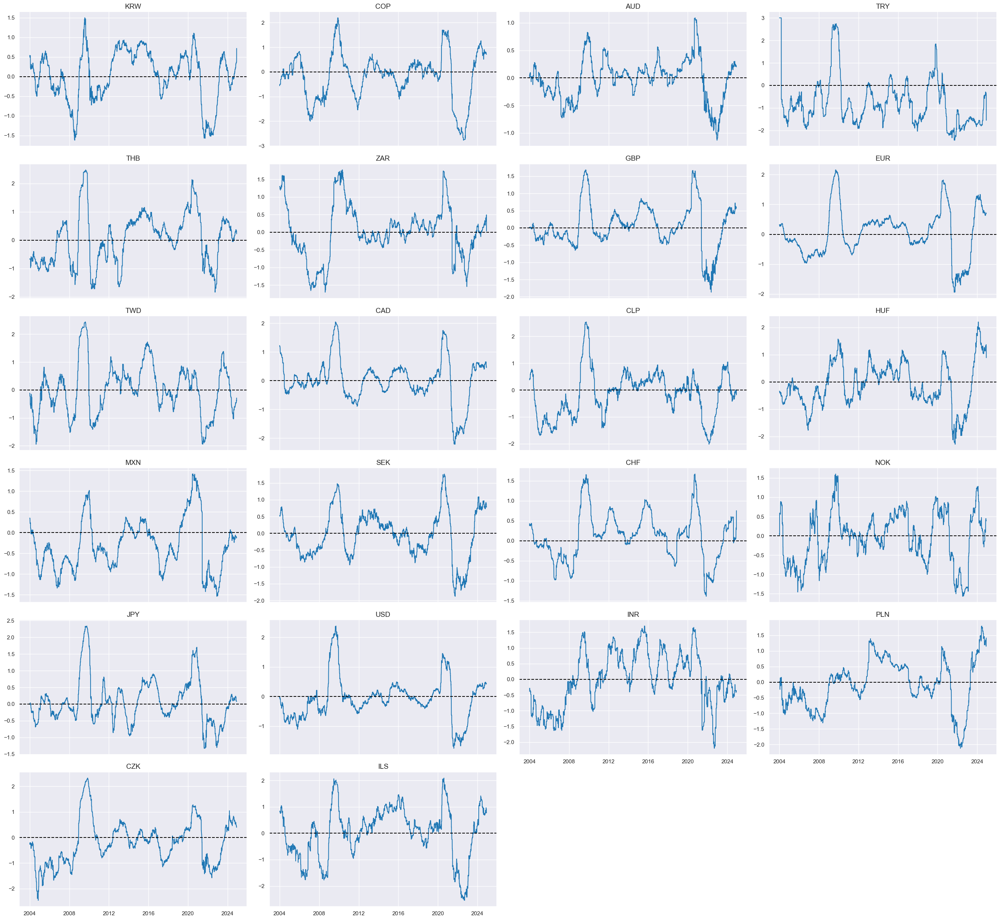

In [16]:
xcatx = ["DU_AVGZ"]

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_dux,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

### Equity feature candidates

To create an equity strategy, we develop a simple, plausible composite signal based on five features, including excess PPI inflation and excess industrial production growth as speculative signal candidates with presumed negative effects.

- Labor market tightness
- Excess inflation 
- Presumed index return momentum 
- Excess PPI inflation 
- Excess industrial production growth 

This is loosely based on an original strategy described in [Equity trend following and macro headwinds](https://research.macrosynergy.com/the-power-of-macro-trends-in-rates-markets/).

#### Plausible features

In [17]:
eq_plaus = []

##### Labor market tightness

Excess wage growth here is defined as wage growth per unit of output in excess of the effective estimated inflation target. Excess wage growth refers to the increase in wages relative to the growth in productivity or output, beyond what is considered consistent with the targeted level of inflation. It indicates a situation where wages are rising at a faster pace than can be justified by the prevailing inflation rate and the overall increase in economic output. Excess wage growth can contribute to inflationary pressures in the economy.

To proxy the impact of the business cycle state on employment growth, a common approach is to calculate the difference between employment growth and the long-term median of workforce growth. This difference is often referred to as "excess employment growth." By calculating excess employment growth, one can estimate the component of employment growth that is attributable to the business cycle state. This measure helps to identify deviations from the long-term trend and provides insights into the cyclical nature of employment dynamics.

In [18]:
# Composite labor tightness score

calcs = [
    # Wage growth
    "LPGT = RGDP_SA_P1Q1QL4_20QMM - WFORCE_NSA_P1Y1YL1_5YMM ",  # labor productivity growth trend
    "XWAGES_NSA_P1M1ML12_3MMA = WAGES_NSA_P1M1ML12_3MMA - LPGT - INFTEFF_NSA ",  # excess wages
    "XWAGES_TREND_NEG = - XWAGES_NSA_P1M1ML12_3MMA ",
    # Employment growth
    "XEMPL_NSA_P1M1ML12_3MMA = EMPL_NSA_P1M1ML12_3MMA - WFORCE_NSA_P1Y1YL1_5YMM",
    "XEMPL_TREND_NEG = - XEMPL_NSA_P1M1ML12_3MMA",
    # Unemployment rate changes
    "XURATE_3Mv5Y = UNEMPLRATE_SA_3MMAv5YMM",
]

dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_eq, blacklist=None)
dfx = msm.update_df(dfx, dfa)

As for the rates strategy, [`make_zn_scores()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#normalize-panels-with-make-zn-scores) function from the `macrosynergy` package normalizes the indicators around a neutral value (zero) using historical data. This normalization is recalculated monthly. To mitigate the impact of statistical outliers, a cutoff of 2 standard deviations is employed. Post-normalization, the indicators (z-scores) are labeled with the suffix `_ZN`, indicating their adjusted status.

In [19]:
# Score the equity features

xcatx = [
    "XEMPL_TREND_NEG",
    "XWAGES_TREND_NEG",
    "XURATE_3Mv5Y",
]
cidx = cids_eq

dfa = pd.DataFrame(columns=list(dfx.columns))

for xc in xcatx:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cidx,
        sequential=True,
        min_obs=261 * 5,
        neutral="zero",
        pan_weight=0.5,  # variance estimated based on panel and cross-sectional variation
        thresh=2,
        postfix="_ZN",
        est_freq="m",
    )
    dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)
labz = [x + "_ZN" for x in xcatx]

[`linear_composite`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#calculate-linear-combinations-of-panels-with-linear-composite) method from the `macrosynergy` package is employed to aggregate the individual category scores into a unified composite indicator `LABSLACK_CZS` with equal weights for each category for simplicity. 

In [20]:
# Combine to a single score

xcatx = labz
czs = "LABSLACK_CZS"
cidx = cids_eq

dfa = msp.linear_composite(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    complete_xcats=False,
    new_xcat=czs,
)

dfx = msm.update_df(dfx, dfa)

if not czs in eq_plaus:
    eq_plaus.append(czs)

##### Inflation shortfall

Negative excess inflation is defined as the negative difference of chosen inflation trend and the effective inflation target [`INFTEFF_NSA`](https://academy.macrosynergy.com/academy/Themes/Economic%20trends/_build/html/notebooks/Inflation%20targets.php#effective-inflation-target)

In [21]:
calcs = [
    "XCPIH_NEG = - CPIH_SA_P1M1ML12 + INFTEFF_NSA",
    "XCPIC_NEG =  - CPIC_SJA_P6M6ML6AR + INFTEFF_NSA",
]

dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_eq)
dfx = msm.update_df(dfx, dfa)

xinfs = dfa["xcat"].unique().tolist()

As before, [`make_zn_scores()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#normalize-panels-with-make-zn-scores) function from the `macrosynergy` package normalizes the indicators around a neutral value (zero) using historical data, recalculated monthly. with a cutoff of 2 standard deviations. Post-normalization, the indicators (z-scores) are labeled with the suffix `_ZN`, indicating their adjusted status.

In [22]:
# Zn score the excess inflation features
cidx = cids_eq
sdate = "1990-01-01"

dfa = pd.DataFrame(columns=list(dfx.columns))

for xc in xinfs:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cidx,
        sequential=True,
        min_obs=261 * 5,
        neutral="zero",
        pan_weight=0.5,  # variance estimated based on panel and cross-sectional variation
        thresh=2,
        postfix="_ZN",
        est_freq="m",
    )
    dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)
xinfz = [x + "_ZN" for x in xinfs]

The [`linear_composite`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#calculate-linear-combinations-of-panels-with-linear-composite) method from the `macrosynergy` package aggregates the individual category scores into a unified composite indicator `XCPI_NEG_CZS`. 

In [23]:
# Combine to a single score

xcatx = xinfz
czs = "XCPI_NEG_CZS"
cidx = cids_eq

dfa = msp.linear_composite(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    complete_xcats=False,
    new_xcat=czs,
)

dfx = msm.update_df(dfx, dfa)

if not czs in eq_plaus:
    eq_plaus.append(czs)

##### Return momentum

Here we take a standard equity trend indicator as the difference between 50-day and 200-day moving averages:

In [24]:
# Equity momentum

fxrs = ["EQXR_VT10", "EQXR_NSA"]
cidx = cids_eq

calcs = []
for fxr in fxrs:
    calc = [
        f"{fxr}I = ( {fxr} ).cumsum()",
        f"{fxr}I_50DMA = {fxr}I.rolling(50).mean()",
        f"{fxr}I_200DMA = {fxr}I.rolling(200).mean()",
        f"{fxr}I_50v200DMA = {fxr}I_50DMA - {fxr}I_200DMA",
    ]
    calcs += calc

dfa = msp.panel_calculator(dfx, calcs, cids=cidx)
dfx = msm.update_df(dfx, dfa)

eqtrends = ["EQXR_VT10I_50v200DMA", "EQXR_NSAI_50v200DMA"]

if not eqtrends[0] in eq_plaus:
    eq_plaus.append(eqtrends[0])

#### Speculative features

Speculative features here are the same as for the duration strategy. We use here negative excess inflation based on producer price inflation and negative excess industrial production growth. Both indicators have weak theoretical backing, and their inclusion simulates the usage of inferior predictors in the signal-generating process.

In [25]:
calcs = [
    "XPPIH_NEG = - ( PPIH_NSA_P1M1ML12 - INFTEFF_NSA ) ",
    "XIPG_NEG =  - ( IP_SA_P1M1ML12_3MMA - RGDP_SA_P1Q1QL4_20QMA ) ",
]

dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_eq)
dfx = msm.update_df(dfx, dfa)

eq_specs = dfa["xcat"].unique().tolist()

#### Scores and composite

Once again, the [`make_zn_scores()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#normalize-panels-with-make-zn-scores) function from the `macrosynergy` package normalizes  the indicators around a neutral value (zero) using historical data. A cutoff of 3 standard deviations is employed. Post-normalization, the indicators (z-scores) are labeled with the suffix `_ZN3`, indicating their adjusted status. A combined, equally weighted indicator `EQ_AVGZ` is built using [`linear_composite`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#calculate-linear-combinations-of-panels-with-linear-composite) method.

In [26]:
eqs = eq_plaus + eq_specs
xcatx = eqs

for xc in xcatx:
    dfa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cids_eq,
        neutral="zero",
        thresh=3,
        est_freq="M",
        pan_weight=1,
        postfix="_ZN3",
    )
    dfx = msm.update_df(dfx, dfa)

eqz = [xc + "_ZN3" for xc in eqs]

dfa = msp.linear_composite(
    df=dfx,
    xcats=eqz,
    cids=cids_eq,
    new_xcat="EQ_AVGZ",
)
dfx = msm.update_df(dfx, dfa)

The newly build composite  unoptimized z-score for equity strategy `EQ_AVGZ` is displayed below with the help of [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) from the `macrosynergy` package:

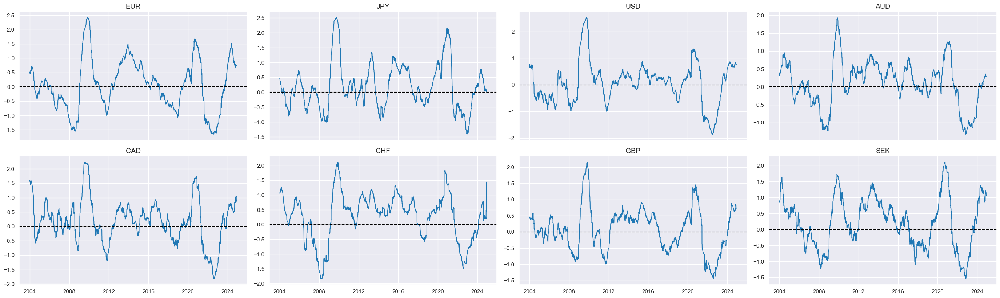

In [27]:
xcatx = ["EQ_AVGZ"]

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_eq,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

### Foreign exchange feature candidates

To create a FX strategy, we develop a simple, plausible composite signal based on six features, including excess PPI inflation and excess industrial production growth as speculative signal candidates with presumed positive effects.

- Changes in external balance ratios
- Relative GDP growth trends
- Manufacturing survey score changes
- Terms-of-trade improvements
- Excess PPI inflation 
- Excess industrial production growth 

The original version of this strategy has been described in a [Pure macro FX strategies: the benefits of double diversification](https://research.macrosynergy.com/pure-macro-fx-strategies-the-benefits-of-double-diversification/).

#### Plausible features

In [28]:
fx_plaus = []

##### External ratio trends

In the cell below the External ratio trends are zn-scored around zero value, using zero as the neutral value, 3 as the cutoff value for winsorization in terms of standard deviations, 5 years of minimum number of observations, and monthly re-estimation frequency. Since the categories are homogeneous across countries, we use the whole panel as the basis for the parameters rather than individual cross-section.

In [29]:
# First Z-score each monthly external ratio change indicator
xcatx = [
    # Very short-term changes
    "MTBGDPRATIO_SA_3MMA_D1M1ML3",
    "CABGDPRATIO_SA_3MMA_D1M1ML3",
    # Short-term changes
    "MTBGDPRATIO_SA_6MMA_D1M1ML6",
    "CABGDPRATIO_SA_6MMA_D1M1ML6",
    # Medium-term changes
    "MTBGDPRATIO_SA_3MMAv60MMA",
    "CABGDPRATIO_SA_3MMAv60MMA",
]
cidx = cids_fx

dfa = pd.DataFrame(columns=list(dfx.columns))

for xc in xcatx:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cidx,
        sequential=True,
        min_obs=261 * 5,
        neutral="zero",
        pan_weight=1,
        thresh=3,
        postfix="_ZN",
        est_freq="m",
    )
    dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)

xbdz = [xc + "_ZN" for xc in xcatx]

The [`linear_composite`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#calculate-linear-combinations-of-panels-with-linear-composite) method from the `macrosynergy` package is employed to aggregate the individual category scores into a unified composite indicator `XBT_ALL_CZS` with equal weights for each category for simplicity.

In [30]:
# Combine to a single score

xcatx = xbdz
czs = "XBT_ALL_CZS"
cidx = cids_fx

dfa = msp.linear_composite(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    complete_xcats=False,
    new_xcat=czs,
)

dfx = msm.update_df(dfx, dfa)

if not czs in fx_plaus:
    fx_plaus.append(czs)

##### Relative growth trends

In the cell below we calculate the annual GDP growth trends relative to base currency area: 
- Euro ('CHF', 'CZK', 'HUF', 'NOK', 'PLN', 'RON', 'SEK'), 
- USD ('PEN',  'COP',  'IDR',  'THB',  'BRL',  'MXN',  'KRW',  'CAD',  'NZD',  'CLP',  'MYR',  'ZAR',  'AUD',  'TWD',  'INR',  'ILS',  'PHP')  or 
- a simple average of the two for ('GBP', 'TRY'). 

The new indicators get postfix `_vBM` for "versus Benchmark"

The two cells below calculate the Annual GDP growth trend relative to base currency area and displays its timeline for each cross-section.

In [31]:
# Relative to base currency areas

xcatx = [
    # Intuitive growth estimates
    "INTRGDP_NSA_P1M1ML12_3MMA",
    "INTRGDPv5Y_NSA_P1M1ML12_3MMA",
    # Technical growth estimates
    "RGDPTECH_SA_P1M1ML12_3MMA",
    "RGDPTECHv5Y_SA_P1M1ML12_3MMA",
]

dfa = pd.DataFrame(columns=list(dfx.columns))
for xc in xcatx:
    calc_eur = [f"{xc}vBM = {xc} - iEUR_{xc}"]
    calc_usd = [f"{xc}vBM = {xc} - iUSD_{xc}"]
    calc_eud = [f"{xc}vBM = {xc} - 0.5 * ( iEUR_{xc} + iUSD_{xc} )"]

    dfa_eur = msp.panel_calculator(dfx, calcs=calc_eur, cids=cids_eur)
    dfa_usd = msp.panel_calculator(dfx, calcs=calc_usd, cids=cids_usd)
    dfa_eud = msp.panel_calculator(dfx, calcs=calc_eud, cids=cids_eud)

    dfa = msm.update_df(dfa, pd.concat([dfa_eur, dfa_usd, dfa_eud]))

dfx = msm.update_df(dfx, dfa)

grows = dfa["xcat"].unique().tolist()

The `macrosynergy` function `make_zn_scores()` normalizes the Annual GDP growth trend relative to the base currency area around zero adding `_ZN` postfix. 

In [32]:
# Normalize relative growth

xcatx = grows
cidx = cids_fx

dfa = pd.DataFrame(columns=list(dfx.columns))

for xc in xcatx:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cidx,
        sequential=True,
        min_obs=261 * 5,
        neutral="zero",
        pan_weight=1,
        thresh=3,
        postfix="_ZN",
        est_freq="m",
    )
    dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)
growz = [xc + "_ZN" for xc in xcatx]

The [`linear_composite`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#calculate-linear-combinations-of-panels-with-linear-composite) method from the `macrosynergy` package is employed to aggregate the individual category scores into a unified composite indicator `GDPvBM_CZS`. 

In [33]:
# Combine to a single score

xcatx = growz
czs = "GDPvBM_CZS"
cidx = cids_fx

dfa = msp.linear_composite(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    complete_xcats=False,
    new_xcat=czs,
)

dfx = msm.update_df(dfx, dfa)

if not czs in fx_plaus:
    fx_plaus.append(czs)

##### Manufacturing survey score changes

The [`make_zn_scores()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#normalize-panels-with-make-zn-scores) function from the `macrosynergy` package normalizes the indicators around a neutral value (zero) using historical data. This normalization is recalculated monthly. To mitigate the impact of statistical outliers, a cutoff of 3 standard deviations is employed. Post-normalization, the indicators (z-scores) are labeled with the suffix `_ZN`, indicating their adjusted status.

In [34]:
# Business score changes

xcatx = ["MBCSCORE_SA_D3M3ML3", "MBCSCORE_SA_D6M6ML6"]
cidx = cids_fx

dfa = pd.DataFrame(columns=list(dfx.columns))

for xc in xcatx:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cidx,
        sequential=True,
        min_obs=261 * 5,
        neutral="zero",
        pan_weight=1,
        thresh=3,
        postfix="_ZN",
        est_freq="m",
    )
    dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)
survz = [xc + "_ZN" for xc in xcatx]

The [`linear_composite`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#calculate-linear-combinations-of-panels-with-linear-composite) method from the `macrosynergy` package is employed to aggregate the individual category scores into a unified composite indicator `MBSURVD_CZ` with equal weights for each category for simplicity. 

In [35]:
# Combine to a single score

xcatx = survz
czs = "MBSURVD_CZS"
cidx = cids_fx

dfa = msp.linear_composite(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    complete_xcats=False,
    new_xcat=czs,
)

dfx = msm.update_df(dfx, dfa)

if not czs in fx_plaus:
    fx_plaus.append(czs)

##### Terms-of-trade

The [`make_zn_scores()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#normalize-panels-with-make-zn-scores) function from the `macrosynergy` package normalizes the indicators around a neutral value (zero) using historical data. This normalization is recalculated monthly. To mitigate the impact of statistical outliers, a cutoff of 3 standard deviations is employed. Post-normalization, the indicators (z-scores) are labeled with the suffix `_ZN`, indicating their adjusted status.

In [36]:
xcatx = [
    # commodity-based changes
    "CTOT_NSA_P1M12ML1",
    "CTOT_NSA_P1M1ML12",
    "CTOT_NSA_P1M60ML1",
    # mixed dynamics
    "MTOT_NSA_P1M12ML1",
    "MTOT_NSA_P1M1ML12",
    "MTOT_NSA_P1M60ML1",
]

cidx = cids_fx
dfa = pd.DataFrame(columns=list(dfx.columns))

for xc in xcatx:
    dfaa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cidx,
        sequential=True,
        min_obs=261 * 5,
        neutral="zero",
        pan_weight=0.5,  # 50% cross-section weight as ToT changes are not fully comparable
        thresh=3,
        postfix="_ZN",
        est_freq="m",
    )
    dfa = msm.update_df(dfa, dfaa)

dfx = msm.update_df(dfx, dfa)
ttdz = [xc + "_ZN" for xc in xcatx]

The [`linear_composite`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#calculate-linear-combinations-of-panels-with-linear-composite) method from the `macrosynergy` package is employed to aggregate the individual category scores into a unified composite indicator `TTD_ALL_CZS` with equal weights for each category for simplicity. 

In [37]:
# Combine to a single score

xcatx = ttdz
czs = "TTD_ALL_CZS"
cidx = cids_fx

dfa = msp.linear_composite(
    df=dfx,
    xcats=xcatx,
    cids=cidx,
    complete_xcats=False,
    new_xcat=czs,
)

dfx = msm.update_df(dfx, dfa)

if not czs in fx_plaus:
    fx_plaus.append(czs)

#### Speculative features

Speculative features here are the same as for the previous strategies: the negative excess inflation based on producer price inflation and negative excess industrial production growth. Both indicators have weak theoretical backing, and their inclusion simulates the usage of inferior predictors in the signal-generating process.

In [38]:
calcs = [
    "XPPIH = PPIH_NSA_P1M1ML12 - INFTEFF_NSA ",
    "XIPG =  IP_SA_P1M1ML12_3MMA - RGDP_SA_P1Q1QL4_20QMA ",
]

dfa = msp.panel_calculator(dfx, calcs=calcs, cids=cids_fx)
dfx = msm.update_df(dfx, dfa)

fx_specs = dfa["xcat"].unique().tolist()

#### Scores and composite

Once again, the [`make_zn_scores()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#normalize-panels-with-make-zn-scores) function from the `macrosynergy` package normalizes  the indicators around a neutral value (zero) using historical data. A cutoff of 3 standard deviations is employed. Post-normalization, the indicators (z-scores) are labeled with the suffix `_ZN3`, indicating their adjusted status. A combined, equally weighted indicator is built using [`linear_composite`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#calculate-linear-combinations-of-panels-with-linear-composite) method. The new (unoptimized) signal receives the name `FX_AVGZ`

In [39]:
fxs = fx_plaus + fx_specs
xcatx = fxs

for xc in xcatx:
    dfa = msp.make_zn_scores(
        dfx,
        xcat=xc,
        cids=cids_fx,
        neutral="zero",
        thresh=3,
        est_freq="M",
        pan_weight=1,
        postfix="_ZN3",
    )
    dfx = msm.update_df(dfx, dfa)

fxz = [xc + "_ZN3" for xc in fxs]

dfa = msp.linear_composite(
    df=dfx,
    xcats=fxz,
    cids=cids_fx,
    new_xcat="FX_AVGZ",
)
dfx = msm.update_df(dfx, dfa)

The linear composite of the z-scores of all features used in fx strategy `FX_AVGZ` is displayed below with the help of [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) from the `macrosynergy` package:

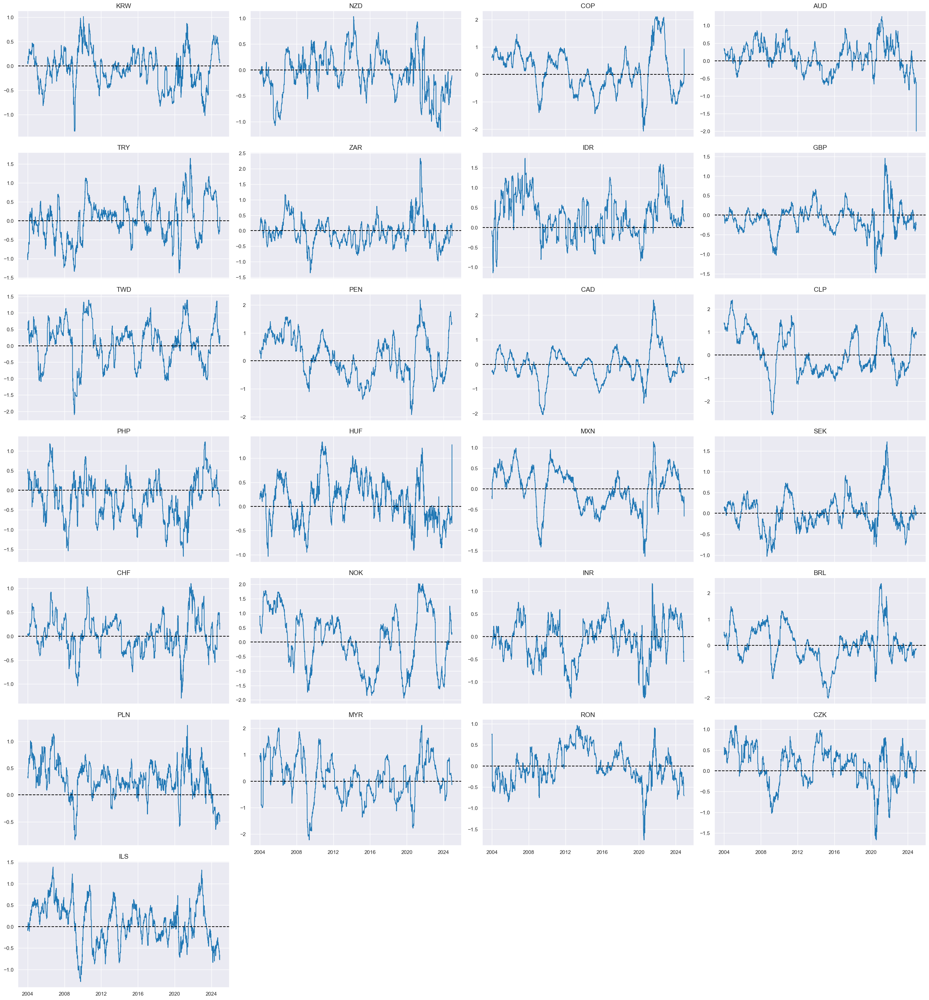

In [40]:
xcatx = ["FX_AVGZ"]

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_fx,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

### Features and targets for scikit-learn

As the first preparation for the statistical learning modelling, we downsample the daily information states to monthly frequency with the help of the [`categories_df()`](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/management/utils/df_utils.py#L608) function applying the lag of 1 month and using the last value in the month for explanatory variables and sum for the aggregated target (return). Two dataframes for each strategy are defined:

* feature dataframe `X_du` and target dataframe `y_du` for the duration strategy
* feature dataframe `X_eq` and target dataframe `y_eq` for the equity strategy
* feature dataframe `X_fx` and target dataframe `y_fx` for the fx strategy

#### Duration

In [41]:
# Specify features and target category
xcatx = durz + ["DU05YXR_VT10"]

# Downsample from daily to monthly frequency (features as last and target as sum)
dfw = msm.categories_df(
    df=dfx,
    xcats=xcatx,
    cids=cids_dux,
    freq="M",
    lag=1,
    blacklist=fxblack,
    xcat_aggs=["last", "sum"],
)

# Drop rows with missing values and assign features and target
dfw.dropna(inplace=True)
X_du = dfw.iloc[:, :-1]
y_du = dfw.iloc[:, -1]

#### Equity

In [42]:
# Specify features and target category
xcatx = eqz + ["EQXR_VT10"]

# Downsample from daily to monthly frequency (features as last and target as sum)
dfw = msm.categories_df(
    df=dfx,
    xcats=xcatx,
    cids=cids_eq,
    freq="M",
    lag=1,
    blacklist=None,
    xcat_aggs=["last", "sum"],
)

# Drop rows with missing values and assign features and target
dfw.dropna(inplace=True)
X_eq = dfw.iloc[:, :-1]
y_eq = dfw.iloc[:, -1]

#### FX

In [43]:
# Specify features and target category
xcatx = fxz + ["FXXR_VT10"]

# Downsample from daily to monthly frequency (features as last and target as sum)
dfw = msm.categories_df(
    df=dfx,
    xcats=xcatx,
    cids=cids_fx,
    freq="M",
    lag=1,
    blacklist=fxblack,
    xcat_aggs=["last", "sum"],
)

# Drop rows with missing values and assign features and target
dfw.dropna(inplace=True)
X_fx = dfw.iloc[:, :-1]
y_fx = dfw.iloc[:, -1]

## Prediction

Here we use standard R2 score for evaluating the performance of regression models.

In [44]:
# Define the optimization criterion
scorer = make_scorer(r2_score, greater_is_better=True)

# Define splits for cross-validation
splitter = msl.RollingKFoldPanelSplit(n_splits=5)

### Ordinary least squares 

We test the consequences of using a standard learning process with standard ordinary least squares (OLS) regression to condense the information of multiple candidate features, against a standard conceptual risk parity benchmark. The only important hyperparameter to optimize over is the inclusion of an intercept in the regression. Although all features have a theoretical neutral level at zero, an intercept would correct for any errors in the underlying assumptions. Yet, the price for potential bias is that past long-term seasons of positive or negative target returns translate into sizable intercepts and future directional bias of the regression signal.

#### Duration

In [45]:
mods_du_ols = {
    "ols": LinearRegression(),
}

grid_du_ols = {
    "ols": {"fit_intercept": [True, False]},
}

The following cell uses the `macrosynergy.learning.SignalOptimizer` class for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_du`, and the targets in `y_du` are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `DU_OLS`

In [46]:
xcatx = durz + ["DU05YXR_VT10"]
cidx = cids_dux

so_du = msl.SignalOptimizer(
    df = dfx,
    xcats = xcatx,
    cids = cidx,
    blacklist = fxblack,
    freq = "M",
    lag = 1,
    xcat_aggs = ["last", "sum"],
)

  0%|          | 0/250 [00:00<?, ?it/s]

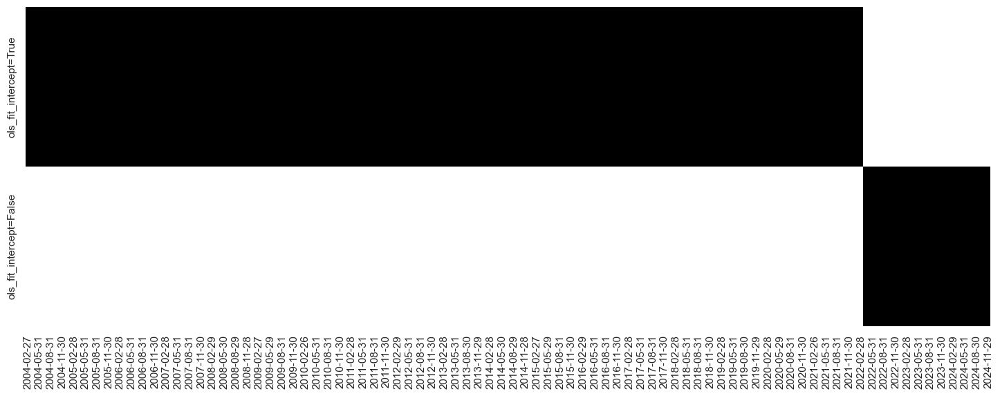

In [47]:
# Calculate predictions
so_du.calculate_predictions(
    name = "DU_OLS",
    models = mods_du_ols,
    hyperparameters = grid_du_ols,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_du.get_optimized_signals()
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_du.models_heatmap(name="DU_OLS", figsize=(18, 6))

Both signals `DU_AVGZ`, `DU_OLS` are displayed below with the help of [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) from the `macrosynergy` package:

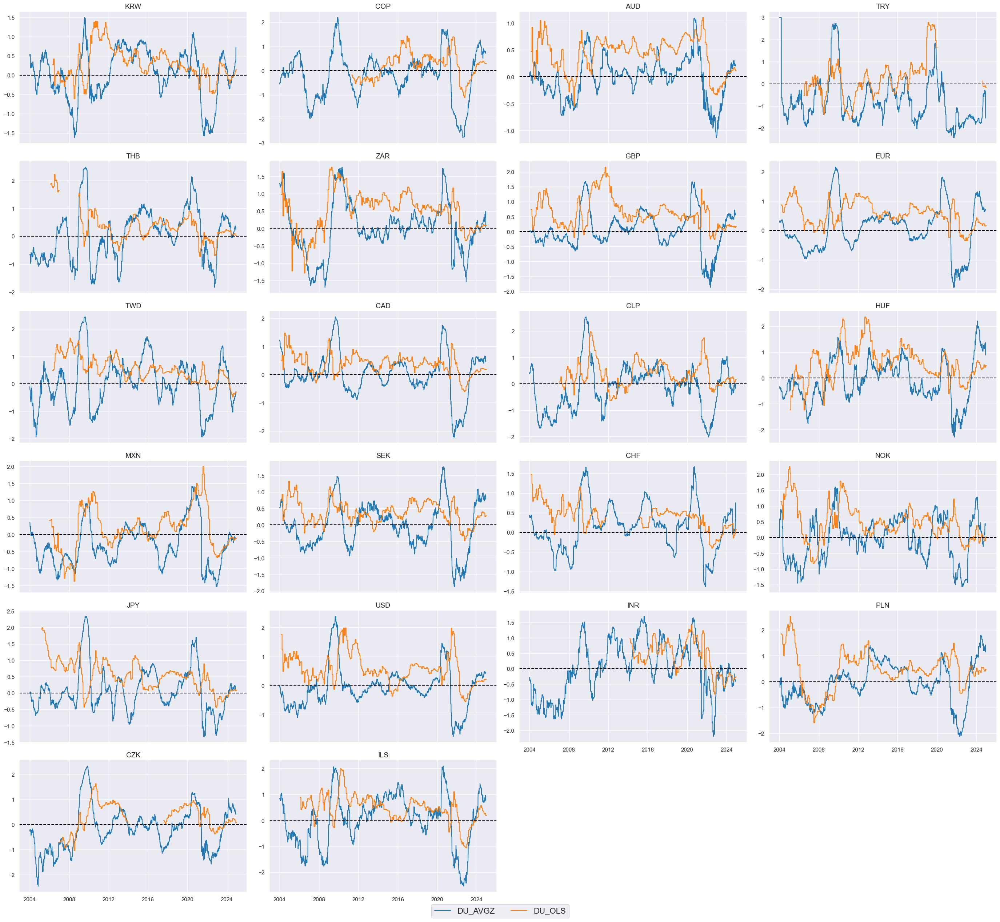

In [48]:
sigs_du_ols = ["DU_AVGZ", "DU_OLS"]
xcatx = sigs_du_ols

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_dux,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

This section uses extensively the following classes of the `macrosynergy` package:

- [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations)
- [`NaivePnL`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl)

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.


In [49]:
## Compare optimized signals with simple average z-scores

srr_du_ols = mss.SignalReturnRelations(
    df=dfx,
    rets=["DU05YXR_VT10"],
    sigs=sigs_du_ols,
    cids=cids_dux,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    blacklist=fxblack,
    slip=1,
)

srr_du_ols.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return       Signal  Frequency Aggregation                                     
DU05YXR_VT10 DU_AVGZ M         last            0.517         0.518     0.495   
             DU_OLS  M         last            0.538         0.525     0.817   

                                            pos_retr  pos_prec  neg_prec  \
Return       Signal  Frequency Aggregation                                 
DU05YXR_VT10 DU_AVGZ M         last            0.537     0.555     0.481   
             DU_OLS  M         last            0.537     0.546     0.504   

                                            pearson  pearson_pval  kendall  \
Return       Signal  Frequency Aggregation                                   
DU05YXR_VT10 DU_AVGZ M         last           0.066         0.000    0.037   
             DU_OLS  M         last           0.050         0.001    0.032   

                                            kendall_pval    auc  
Return       Signal  Frequency Aggregation                       
DU05YXR_VT10 DU_AVGZ M         last                0.000  0.518  
             DU_OLS  M         last                0.001  0.515

We estimate the economic value of both composite signals based on a naïve PnL computed according to a standard procedure used in Macrosynergy research posts. A naive PnL is calculated for simple monthly rebalancing in accordance with the composite scores  `DU_AVGZ` and `DU_OLS` and score at the end of each month as the basis for the positions of the next month and under consideration of a 1-day slippage for trading. The trading signals are capped at 2 standard deviations in either direction for each currency as a reasonable risk limit, and applied to volatility-targeted positions. This means that one unit of signal translates into one unit of risk (approximated by estimated return volatility) for each currency. The naïve PnL does not consider transaction costs or compounding. For the chart below, the PnL has been scaled to an annualized volatility of 10%

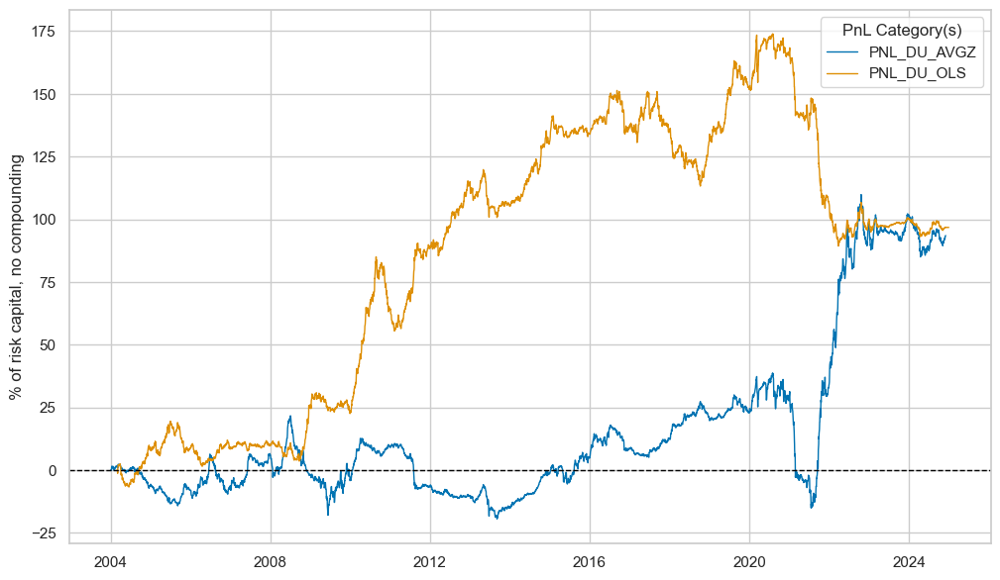

xcat,PNL_DU_AVGZ,PNL_DU_OLS
Return %,4.469729,4.643754
St. Dev. %,10.0,10.0
Sharpe Ratio,0.446973,0.464375
Sortino Ratio,0.633659,0.64623
Max 21-Day Draw %,-29.195864,-23.743326
Max 6-Month Draw %,-41.291288,-51.187972
Peak to Trough Draw %,-53.720987,-84.534925
Top 5% Monthly PnL Share,1.683276,1.298576
USD_GB10YXR_NSA correl,-0.026813,0.415252
Traded Months,252,252


In [50]:
sigs = sigs_du_ols
cidx = cids_dux

pnl_du_ols = msn.NaivePnL(
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs,
    cids=cidx,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_GB10YXR_NSA"],
)
for sig in sigs:
    pnl_du_ols.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_du_ols.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)
pnl_du_ols.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

The method `create_results_dataframe()` from `macrosynergy.pnl` displays a small dataframe of key statistics for both signals:

In [51]:
results_du_ols = msn.create_results_dataframe(
    title="Performance metrics, PARITY vs OLS, duration",
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs_du_ols,
    cids=cids_dux,
    sig_ops="zn_score_pan",
    sig_adds=0,
    sig_negs=[False, False],
    neutrals="zero",
    threshs=2,
    bm="USD_GB10YXR_NSA",
    cosp=True,
    start="2004-01-01",
    blacklist=fxblack,
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"DU_AVGZ": "PARITY", "DU_OLS": "OLS"},
    slip=1,
)
results_du_ols

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
PARITY,0.517,0.518,0.066,0.037,0.447,0.634,-0.027
OLS,0.538,0.525,0.050,0.032,0.464,0.646,0.415


#### Equity

In [52]:
mods_eq_ols = {
    "ols": LinearRegression(),
}

grid_eq_ols = {
    "ols": {"fit_intercept": [True, False]},
}

As for the duration strategy above, we deploy `macrosynergy's` `SignalOptimizer` class for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_eq`, and the targets in `y_eq`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. In this context, we aim to generate the signal for the equity strategy `EQ_OLS`, which will then be analyzed in comparison to the previously developed conceptual parity signal, `EQ_AVGZ`.

In [53]:
xcatx = eqz + ["EQXR_VT10"]
cidx = cids_eq

so_eq = msl.SignalOptimizer(
    df = dfx,
    xcats = xcatx,
    cids = cidx,
    freq = "M",
    lag = 1,
    xcat_aggs = ["last", "sum"],
)

  0%|          | 0/254 [00:00<?, ?it/s]

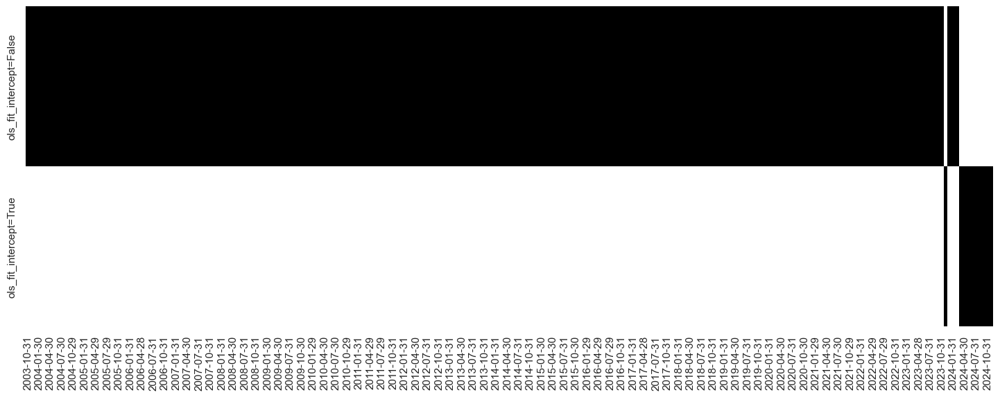

In [54]:
# Calculate predictions
so_eq.calculate_predictions(
    name = "EQ_OLS",
    models = mods_eq_ols,
    hyperparameters = grid_eq_ols,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_eq.get_optimized_signals()
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_eq.models_heatmap(name="EQ_OLS", figsize=(18, 6))

Both signals `EQ_AVGZ`, `EQ_OLS` are displayed below with the help of [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) from the `macrosynergy` package:

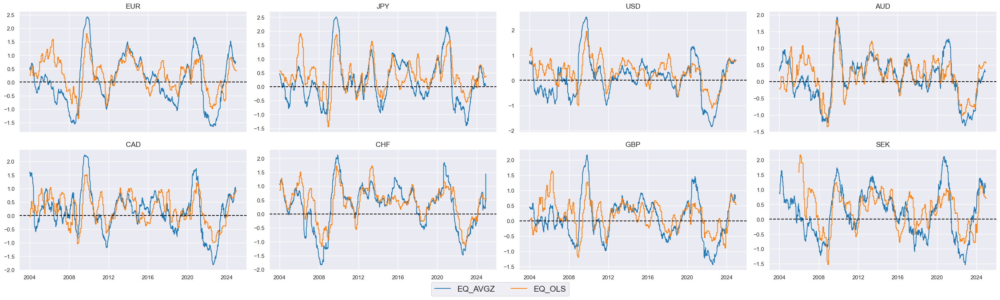

In [55]:
sigs_eq_ols = ["EQ_AVGZ", "EQ_OLS"]
xcatx = sigs_eq_ols

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_eq,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class from the macrosynergy.signal module is designed to analyze, visualize, and compare the relationships between panels of trading signals and panels of subsequent returns and `signals_table()` method is used for a comparative overview of the signal-return relationship across both signals.

In [56]:
## Compare optimized signals with simple average z-scores

srr_eq_ols = mss.SignalReturnRelations(
    df=dfx,
    rets=["EQXR_VT10"],
    sigs=sigs_eq_ols,
    cids=cids_eq,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
)

srr_eq_ols.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal  Frequency Aggregation                                     
EQXR_VT10 EQ_AVGZ M         last            0.575         0.554     0.598   
          EQ_OLS  M         last            0.567         0.521     0.707   

                                         pos_retr  pos_prec  neg_prec  \
Return    Signal  Frequency Aggregation                                 
EQXR_VT10 EQ_AVGZ M         last            0.619     0.663     0.445   
          EQ_OLS  M         last            0.619     0.632     0.410   

                                         pearson  pearson_pval  kendall  \
Return    Signal  Frequency Aggregation                                   
EQXR_VT10 EQ_AVGZ M         last           0.116         0.000    0.070   
          EQ_OLS  M         last           0.053         0.018    0.032   

                                         kendall_pval    auc  
Return    Signal  Frequency Aggregation                       
EQXR_VT10 EQ_AVGZ M         last                0.000  0.555  
          EQ_OLS  M         last                0.031  0.518

We estimate the economic value of both composite signals based on a naïve PnL computed according to a standard procedure used in Macrosynergy research posts. A naive PnL is calculated for simple monthly rebalancing in accordance with the composite scores  `EQ_AVGZ` and `EQ_OLS` and score at the end of each month as the basis for the positions of the next month and under consideration of a 1-day slippage for trading. The trading signals are capped at 2 standard deviations in either direction for each currency as a reasonable risk limit, and applied to volatility-targeted positions. This means that one unit of signal translates into one unit of risk (approximated by estimated return volatility) for each currency. The naïve PnL does not consider transaction costs or compounding. For the chart below, the PnL has been scaled to an annualized volatility of 10%

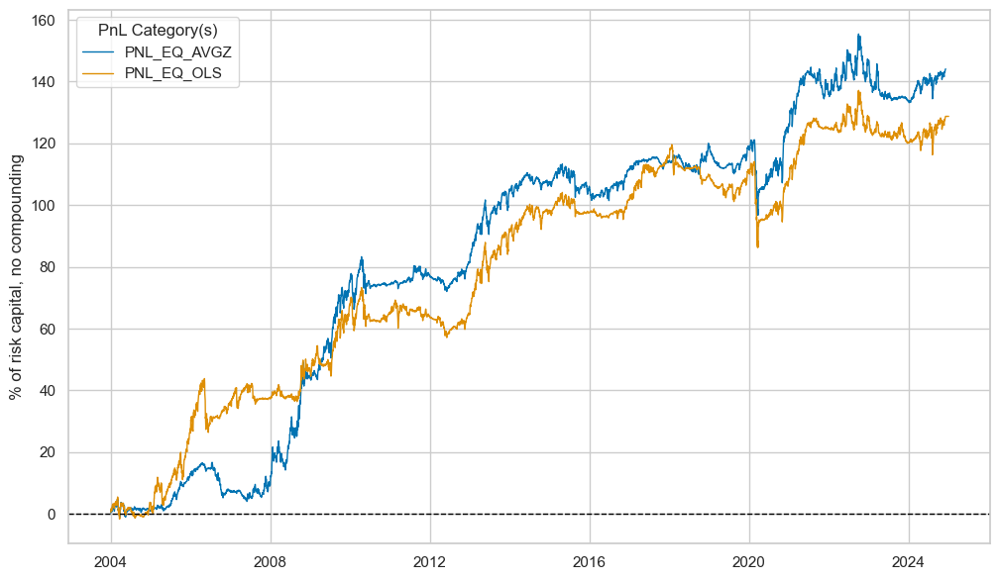

xcat,PNL_EQ_AVGZ,PNL_EQ_OLS
Return %,6.890349,6.132868
St. Dev. %,10.0,10.0
Sharpe Ratio,0.689035,0.613287
Sortino Ratio,0.994469,0.843085
Max 21-Day Draw %,-23.686601,-26.942853
Max 6-Month Draw %,-17.372984,-19.278729
Peak to Trough Draw %,-24.440076,-33.320281
Top 5% Monthly PnL Share,0.752745,0.668659
USD_EQXR_NSA correl,0.050355,0.218191
Traded Months,252,252


In [57]:
cidx = cids_eq
sigs = sigs_eq_ols

pnl_eq_ols = msn.NaivePnL(
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs,
    cids=cidx,
    start="2004-01-01",
    bms=["USD_EQXR_NSA"],
)
for sig in sigs:
    pnl_eq_ols.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_eq_ols.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_eq_ols.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

The method `create_results_dataframe()` from `macrosynergy.pnl` displays a small dataframe of key statistics for both signals:

In [58]:
results_eq_ols = msn.create_results_dataframe(
    title="Performance metrics, PARITY vs OLS, equity",
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs_eq_ols,
    cids=cids_eq,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    sig_negs=[False, False],
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"EQ_AVGZ": "PARITY", "EQ_OLS": "OLS"},
    slip=1,
)
results_eq_ols

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
PARITY,0.575,0.554,0.116,0.070,0.689,0.994,0.050
OLS,0.567,0.521,0.053,0.032,0.613,0.843,0.218


#### FX

In [59]:
mods_fx_ols = {
    "ols": LinearRegression(),
}

grid_fx_ols = {
    "ols": {"fit_intercept": [True, False]},
}

In [60]:
xcatx = fxz + ["FXXR_VT10"]
cidx = cids_fx

so_fx = msl.SignalOptimizer(
    df = dfx,
    xcats = xcatx,
    cids = cidx,
    blacklist=fxblack,
    freq = "M",
    lag = 1,
    xcat_aggs = ["last", "sum"],
)

  0%|          | 0/251 [00:00<?, ?it/s]

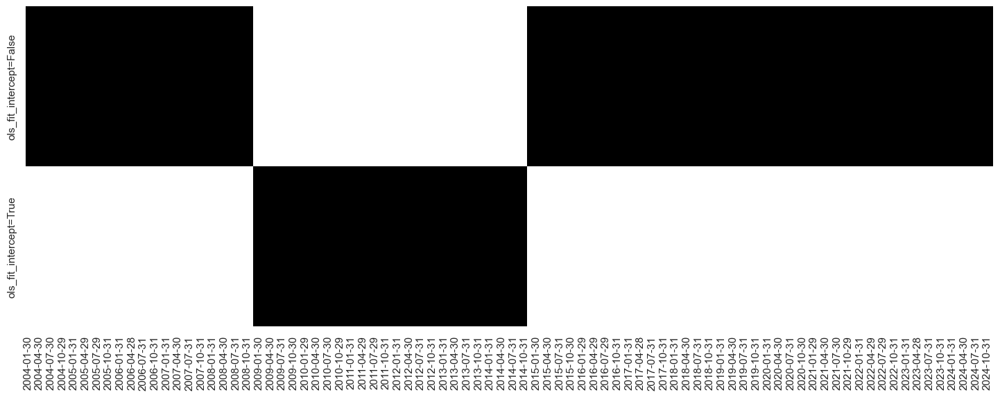

In [61]:
# Calculate predictions
so_fx.calculate_predictions(
    name = "FX_OLS",
    models = mods_fx_ols,
    hyperparameters = grid_fx_ols,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_fx.get_optimized_signals()
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_fx.models_heatmap(name="FX_OLS", figsize=(18, 6))

The same steps are repeated for the FX strategy. The following cell uses the `macrosynergy.learning.SignalOptimizer` class for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_fx`, and the targets in `y_fx`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The OLS signal derived in the process receives label `FX_OLS`.

Both signals `FX_AVGZ`, `FX_OLS` are displayed below with the help of [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) from the `macrosynergy` package:

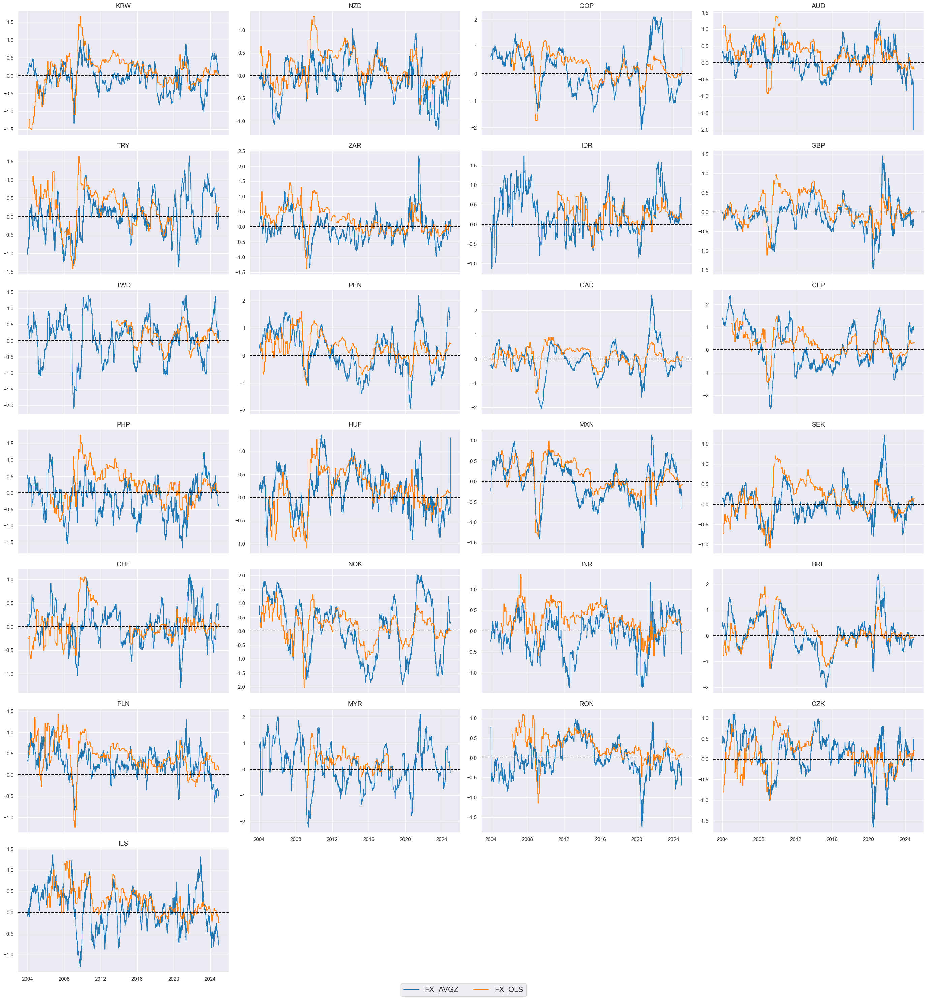

In [62]:
sigs_fx_ols = ["FX_AVGZ", "FX_OLS"]
xcatx = sigs_fx_ols

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_fx,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class from the macrosynergy.signal module is designed to analyze, visualize, and compare the relationships between panels of trading signals and panels of subsequent returns.

In [63]:
## Compare optimized signals with simple average z-scores

srr_fx_ols = mss.SignalReturnRelations(
    df=dfx,
    rets=["FXXR_VT10"],
    sigs=sigs_fx_ols,
    cids=cids_fx,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    blacklist=fxblack,
    slip=1,
)

srr_fx_ols.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal  Frequency Aggregation                                     
FXXR_VT10 FX_AVGZ M         last            0.510         0.509     0.518   
          FX_OLS  M         last            0.526         0.517     0.677   

                                         pos_retr  pos_prec  neg_prec  \
Return    Signal  Frequency Aggregation                                 
FXXR_VT10 FX_AVGZ M         last            0.534     0.543     0.475   
          FX_OLS  M         last            0.534     0.545     0.488   

                                         pearson  pearson_pval  kendall  \
Return    Signal  Frequency Aggregation                                   
FXXR_VT10 FX_AVGZ M         last           0.035         0.008    0.026   
          FX_OLS  M         last           0.021         0.114    0.023   

                                         kendall_pval    auc  
Return    Signal  Frequency Aggregation                       
FXXR_VT10 FX_AVGZ M         last                0.003  0.509  
          FX_OLS  M         last                0.009  0.515

[`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is designed to provide a quick and simple overview of a stylized PnL profile of a set of trading signals. The class is labeled naive because its methods do not consider transaction costs or position limitations, such as risk management considerations. This is deliberate because costs and limitations are specific to trading size, institutional rules, and regulations. 

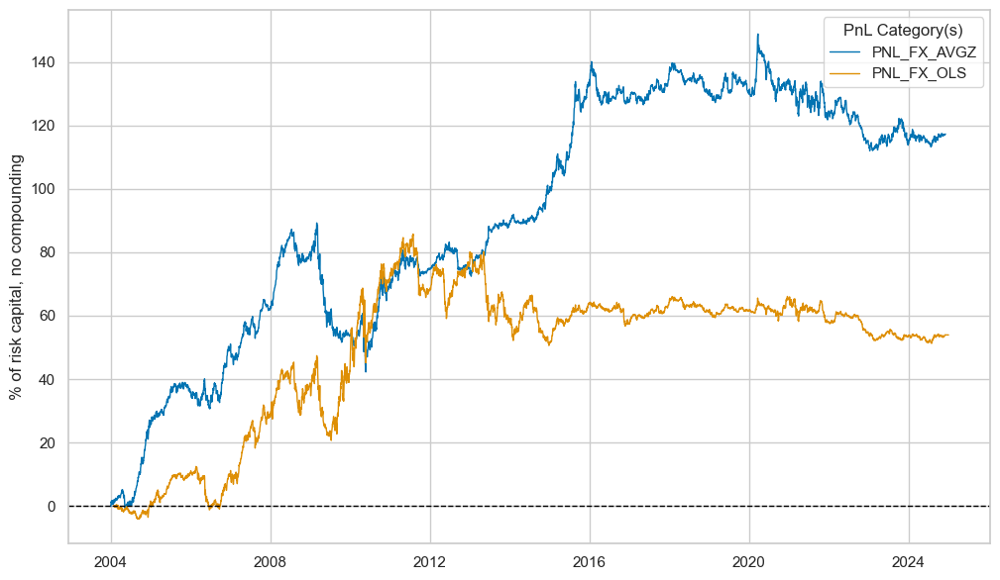

xcat,PNL_FX_AVGZ,PNL_FX_OLS
Return %,5.606975,2.576528
St. Dev. %,10.0,10.0
Sharpe Ratio,0.560698,0.257653
Sortino Ratio,0.795164,0.354151
Max 21-Day Draw %,-18.456145,-23.578106
Max 6-Month Draw %,-35.046148,-22.345334
Peak to Trough Draw %,-47.02541,-35.169891
Top 5% Monthly PnL Share,0.852942,1.606838
USD_EQXR_NSA correl,-0.06243,0.113561
Traded Months,252,252


In [64]:
sigs = sigs_fx_ols

pnl_fx_ols = msn.NaivePnL(
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs,
    cids=cids_fx,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_EQXR_NSA"],
)
for sig in sigs:
    pnl_fx_ols.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_fx_ols.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)
pnl_fx_ols.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

The method `create_results_dataframe()` from `macrosynergy.pnl` displays a small dataframe of key statistics for both signals:

In [65]:
results_fx_ols = msn.create_results_dataframe(
    title="Performance metrics, PARITY vs OLS, FX",
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs_fx_ols,
    cids=cids_fx,
    sig_ops="zn_score_pan",
    sig_adds=0,
    sig_negs=[False, False],
    
    neutrals="zero",
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    blacklist=fxblack,
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"FX_AVGZ": "PARITY", "FX_OLS": "OLS"},
    slip=1,
)
results_fx_ols

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
PARITY,0.510,0.509,0.035,0.026,0.561,0.795,-0.062
OLS,0.526,0.517,0.021,0.023,0.258,0.354,0.114


## Regression comparison

OLS failed to outperform conceptual parity on average for the three types of macro strategies. Whilst the accuracy of OLS signals was higher balanced accuracy, forward correlation coefficients and PnL performance ratios were all lower. Also, market benchmark correlation of OLS-based strategies was on average higher. Underperformance of OLS mainly arose in the FX space and reflected the learning method’s preference for regression models with intercept from 2008 to 2014, which translated the strong season for FX returns of the earlier 2000s into a positive bias for signals during and after the great financial crisis.

The empirical analysis provided two important lessons:

* Only allow constants if there is a good reason. If the regression intercept picks up longer performance seasons, it will simply extrapolate past return averages. 
* Don’t compare regression signals and fixed-weight signals by correlation metrics. Regression-based signal variation does not arise merely from feature variation, but from changes in model parameters and hyperparameters. And the latter sources of variation have no plausible relation to target return. For example, in the empirical analyses of the duration strategy the OLS signals post lower predictive correlation but produce higher accuracy and balanced accuracy and almost the same performance ratios.

In [66]:
results_ols = (results_du_ols.data + results_eq_ols.data + results_fx_ols.data) / 3
results_ols.style.format("{:.3f}").set_caption(
    "Averaged performance metrics, PARITY vs OLS"
).set_table_styles(
    [
        {
            "selector": "caption",
            "props": [("text-align", "center"), ("font-weight", "bold")],
        }
    ]
)

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
PARITY,0.534,0.527,0.072,0.044,0.566,0.808,-0.013
OLS,0.544,0.521,0.041,0.029,0.445,0.614,0.249


### Non-negative least squares

NNLS is a regression technique used to approximate the solution of an overdetermined system of linear equations with the additional constraint that the coefficients must be non-negative. This is a bit like placing independent half-flat priors on the feature weights in a Bayesian context. The main advantage of NNLS is that it allows consideration of theoretical priors, reducing dependence on scarce data.

#### Duration

In [67]:
mods_du_ls = {
    "nnls": LinearRegression(positive=True),
}

grid_du_ls = {
    "nnls": {"fit_intercept": [True, False]},
}

The following cell uses the `macrosynergy.learning.SignalOptimizer` class for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_du`, and the targets in `y_du`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The signal generated through this process is labeled as `DU_NNLS`.

  0%|          | 0/250 [00:00<?, ?it/s]

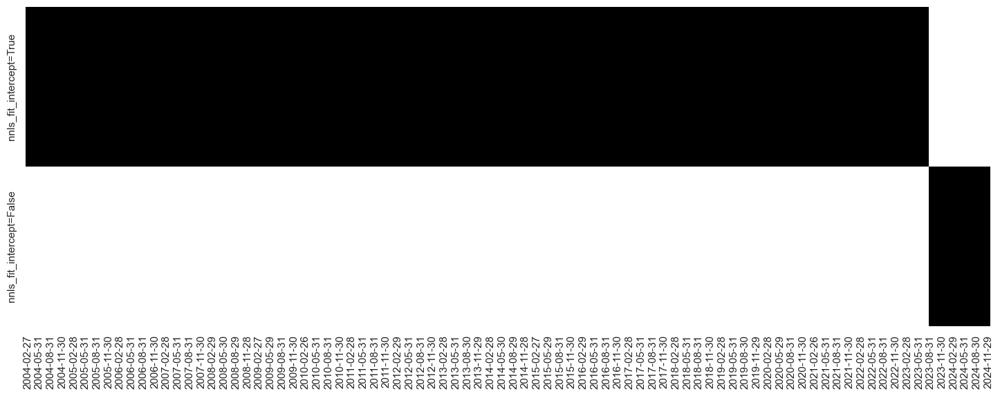

In [68]:
# Calculate predictions
so_du.calculate_predictions(
    name = "DU_NNLS",
    models = mods_du_ls,
    hyperparameters = grid_du_ls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_du.get_optimized_signals(name="DU_NNLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_du.models_heatmap(name="DU_NNLS", figsize=(18, 6))

Both signals `DU_NNLS`, and `DU_OLS` are displayed below with the help of [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) from the `macrosynergy` package:

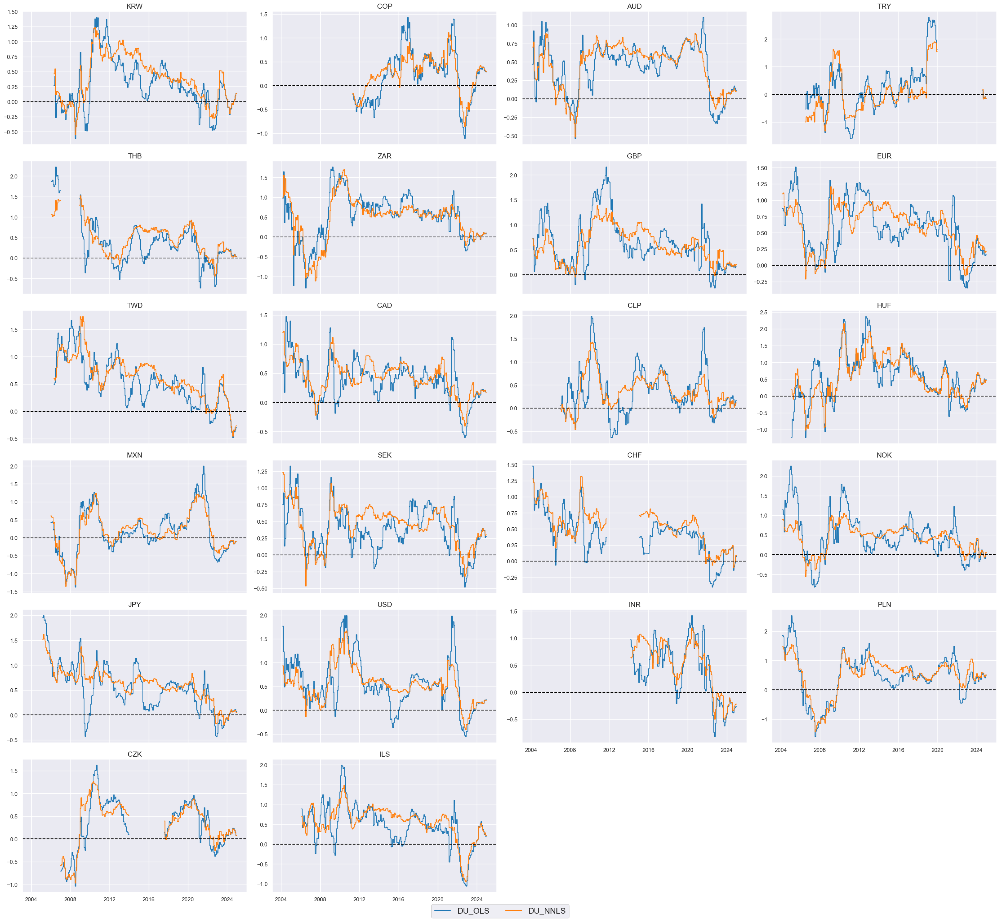

In [69]:
sigs_du_ls = ["DU_OLS", "DU_NNLS"]
xcatx = sigs_du_ls

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_dux,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [70]:
# Compare optimized signals with simple average z-scores

xcatx = sigs_du_ls

srr_du_ls = mss.SignalReturnRelations(
    df=dfx,
    rets=["DU05YXR_VT10"],
    sigs=xcatx,
    cids=cids_dux,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    blacklist=fxblack,
    slip=1,
)

srr_du_ls.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return       Signal  Frequency Aggregation                                     
DU05YXR_VT10 DU_OLS  M         last            0.538         0.525     0.817   
             DU_NNLS M         last            0.536         0.520     0.861   

                                            pos_retr  pos_prec  neg_prec  \
Return       Signal  Frequency Aggregation                                 
DU05YXR_VT10 DU_OLS  M         last            0.537     0.546     0.504   
             DU_NNLS M         last            0.537     0.542     0.497   

                                            pearson  pearson_pval  kendall  \
Return       Signal  Frequency Aggregation                                   
DU05YXR_VT10 DU_OLS  M         last           0.050         0.001    0.032   
             DU_NNLS M         last           0.062         0.000    0.043   

                                            kendall_pval    auc  
Return       Signal  Frequency Aggregation                       
DU05YXR_VT10 DU_OLS  M         last                0.001  0.515  
             DU_NNLS M         last                0.000  0.509

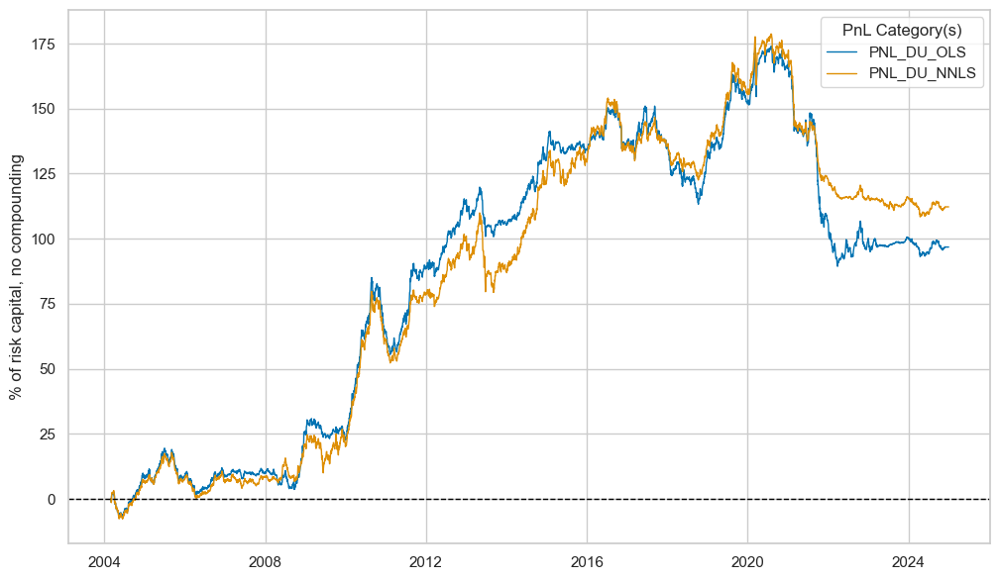

xcat,PNL_DU_OLS,PNL_DU_NNLS
Return %,4.643754,5.385462
St. Dev. %,10.0,10.0
Sharpe Ratio,0.464375,0.538546
Sortino Ratio,0.643807,0.74652
Max 21-Day Draw %,-23.743326,-24.949941
Max 6-Month Draw %,-51.187972,-34.29769
Peak to Trough Draw %,-84.534925,-70.289582
Top 5% Monthly PnL Share,1.298576,1.099648
USD_GB10YXR_NSA correl,0.415252,0.47826
Traded Months,251,251


In [71]:
sigs = sigs_du_ls

pnl_du_ls = msn.NaivePnL(
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs,
    cids=cids_dux,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_GB10YXR_NSA"],
)
for sig in sigs:
    pnl_du_ls.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_du_ls.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)
pnl_du_ls.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

The method `create_results_dataframe()` from `macrosynergy.pnl` displays a small dataframe of key statistics for both signals:

In [72]:
results_du_ls = msn.create_results_dataframe(
    title="Performance metrics, OLS vs NNLS, duration",
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs_du_ls,
    cids=cids_dux,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    sig_negs=[False, False],
    threshs=2,
    bm="USD_GB10YXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"DU_OLS": "OLS", "DU_NNLS": "NNLS"},
    slip=1,
    blacklist=fxblack,
)
results_du_ls

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
NNLS,0.536,0.520,0.062,0.043,0.539,0.747,0.478
OLS,0.538,0.525,0.050,0.032,0.464,0.644,0.415


#### Equity

In [73]:
mods_eq_ls = {
    "nnls": LinearRegression(positive=True),
}

grid_eq_ls = {
    "nnls": {"fit_intercept": [True, False]},
}

The following cell uses the `macrosynergy.learning.SignalOptimizer` class for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_eq`, and the targets in `y_eq`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The signal generated through this process is labeled as `EQ_NNLS`.

  0%|          | 0/254 [00:00<?, ?it/s]

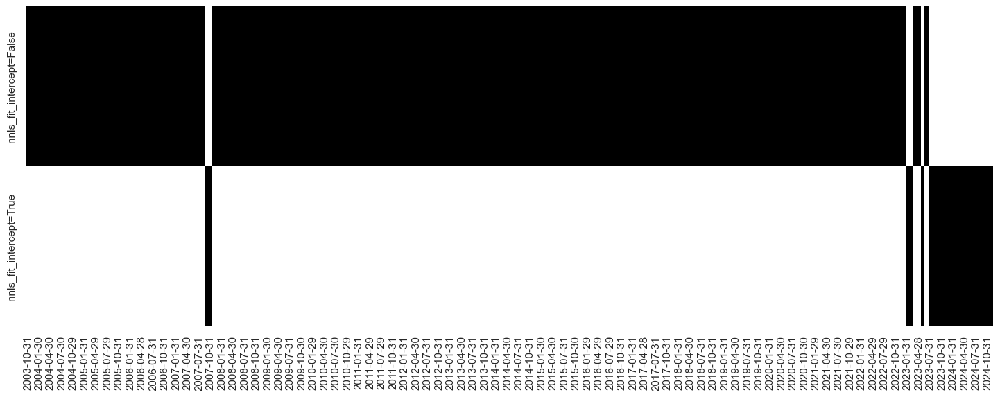

In [74]:
# Calculate predictions
so_eq.calculate_predictions(
    name = "EQ_NNLS",
    models = mods_eq_ls,
    hyperparameters = grid_eq_ls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_eq.get_optimized_signals(name="EQ_NNLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_eq.models_heatmap(name="EQ_NNLS", figsize=(18, 6))

Both signals `EQ_NNLS`, and `EQ_OLS` are displayed below with the help of [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) from the `macrosynergy` package:

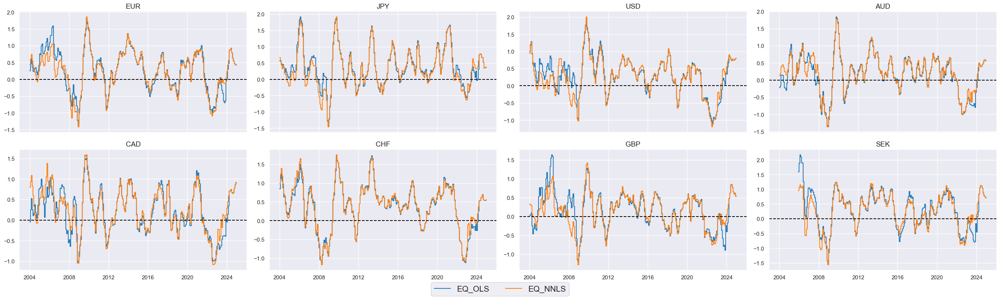

In [75]:
sigs_eq_ls = ["EQ_OLS", "EQ_NNLS"]
xcatx = sigs_eq_ls

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_eq,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [76]:
## Compare optimized signals with simple average z-scores

srr_eq_ls = mss.SignalReturnRelations(
    df=dfx,
    rets=["EQXR_VT10"],
    sigs=sigs_eq_ls,
    cids=cids_eq,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
)

srr_eq_ls.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal  Frequency Aggregation                                     
EQXR_VT10 EQ_OLS  M         last            0.567         0.521     0.707   
          EQ_NNLS M         last            0.570         0.526     0.705   

                                         pos_retr  pos_prec  neg_prec  \
Return    Signal  Frequency Aggregation                                 
EQXR_VT10 EQ_OLS  M         last            0.619     0.632     0.410   
          EQ_NNLS M         last            0.619     0.634     0.417   

                                         pearson  pearson_pval  kendall  \
Return    Signal  Frequency Aggregation                                   
EQXR_VT10 EQ_OLS  M         last           0.053         0.018    0.032   
          EQ_NNLS M         last           0.069         0.002    0.040   

                                         kendall_pval    auc  
Return    Signal  Frequency Aggregation                       
EQXR_VT10 EQ_OLS  M         last                0.031  0.518  
          EQ_NNLS M         last                0.008  0.523

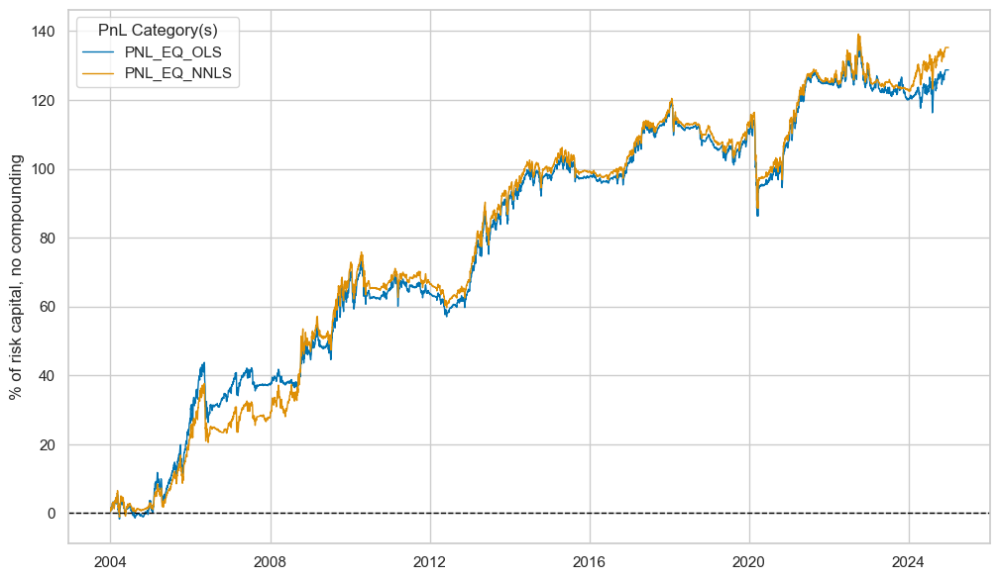

xcat,PNL_EQ_OLS,PNL_EQ_NNLS
Return %,6.132868,6.443819
St. Dev. %,10.0,10.0
Sharpe Ratio,0.613287,0.644382
Sortino Ratio,0.843085,0.887975
Max 21-Day Draw %,-26.942853,-26.921855
Max 6-Month Draw %,-19.278729,-19.03907
Peak to Trough Draw %,-33.320281,-31.901698
Top 5% Monthly PnL Share,0.668659,0.645426
USD_EQXR_NSA correl,0.218191,0.175331
Traded Months,252,252


In [77]:
sigs = sigs_eq_ls

pnl_eq_ls = msn.NaivePnL(
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs,
    cids=cids_eq,
    bms=["USD_EQXR_NSA"],
    start="2004-01-01",
)
for sig in sigs:
    pnl_eq_ls.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_eq_ls.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)
pnl_eq_ls.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

The method `create_results_dataframe()` from `macrosynergy.pnl` displays a small dataframe of key statistics for both signals:

In [78]:
results_eq_ls = msn.create_results_dataframe(
    title="Performance metrics, NNLS vs OLS, equity",
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs_eq_ls,
    cids=cids_eq,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    sig_negs=[False, False],
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"EQ_OLS": "OLS", "EQ_NNLS": "NNLS"},
    slip=1,
)
results_eq_ls

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
NNLS,0.570,0.526,0.069,0.040,0.644,0.888,0.175
OLS,0.567,0.521,0.053,0.032,0.613,0.843,0.218


#### FX

In [79]:
mods_fx_ls = {
    "nnls": LinearRegression(positive=True),
}

grid_fx_ls = {
    "nnls": {"fit_intercept": [True, False]},
}

As before, we deploy `SignalOptimizer` class for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_fx`, and the targets in `y_fx`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The signal generated through this process is labeled as `FX_NNLS`

  0%|          | 0/251 [00:00<?, ?it/s]

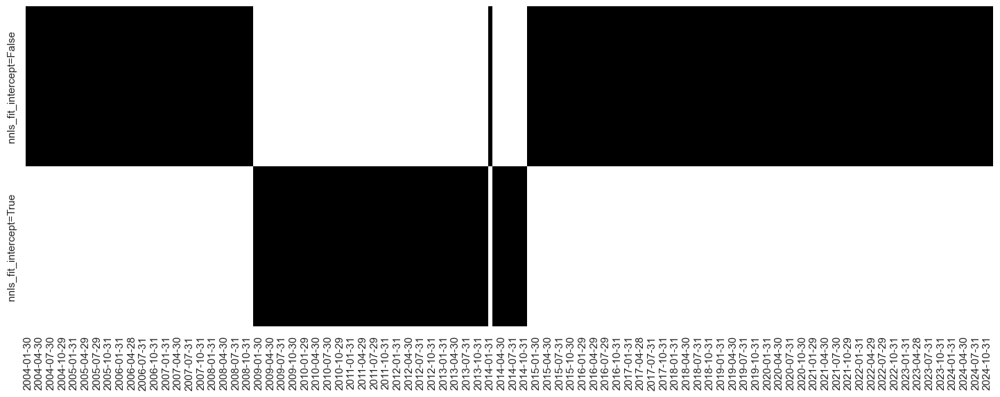

In [80]:
# Calculate predictions
so_fx.calculate_predictions(
    name = "FX_NNLS",
    models = mods_fx_ls,
    hyperparameters = grid_fx_ls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_fx.get_optimized_signals(name="FX_NNLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_fx.models_heatmap(name="FX_NNLS", figsize=(18, 6))

Both signals `FX_NNLS`, and `FX_OLS` are displayed below with the help of [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) from the `macrosynergy` package:

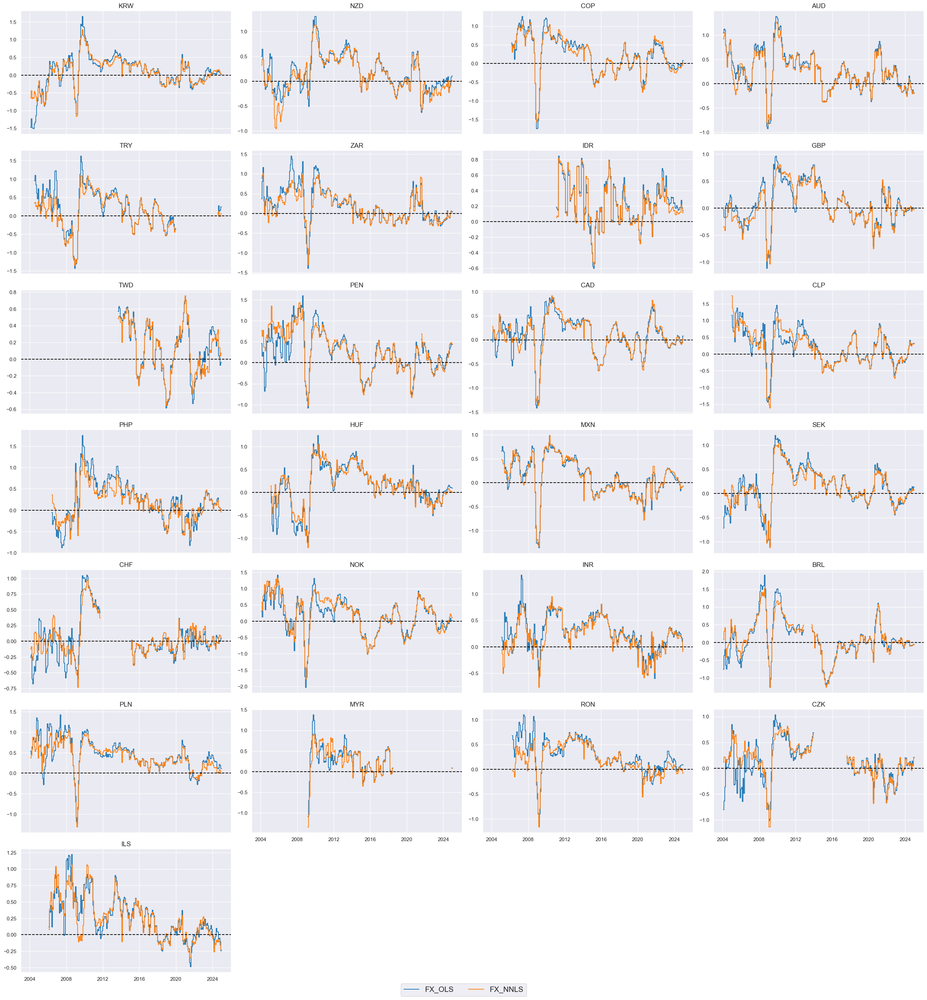

In [81]:
sigs_fx_ls = ["FX_OLS", "FX_NNLS"]
xcatx = sigs_fx_ls

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_fx,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [82]:
## Compare optimized signals with simple average z-scores

srr_fx_ls = mss.SignalReturnRelations(
    df=dfx,
    rets=["FXXR_VT10"],
    sigs=sigs_fx_ls,
    cids=cids_fx,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
    blacklist=fxblack,
)

srr_fx_ls.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal  Frequency Aggregation                                     
FXXR_VT10 FX_OLS  M         last            0.526         0.517     0.677   
          FX_NNLS M         last            0.524         0.515     0.663   

                                         pos_retr  pos_prec  neg_prec  \
Return    Signal  Frequency Aggregation                                 
FXXR_VT10 FX_OLS  M         last            0.534     0.545     0.488   
          FX_NNLS M         last            0.534     0.544     0.485   

                                         pearson  pearson_pval  kendall  \
Return    Signal  Frequency Aggregation                                   
FXXR_VT10 FX_OLS  M         last           0.021         0.114    0.023   
          FX_NNLS M         last           0.025         0.059    0.025   

                                         kendall_pval    auc  
Return    Signal  Frequency Aggregation                       
FXXR_VT10 FX_OLS  M         last                0.009  0.515  
          FX_NNLS M         last                0.004  0.513

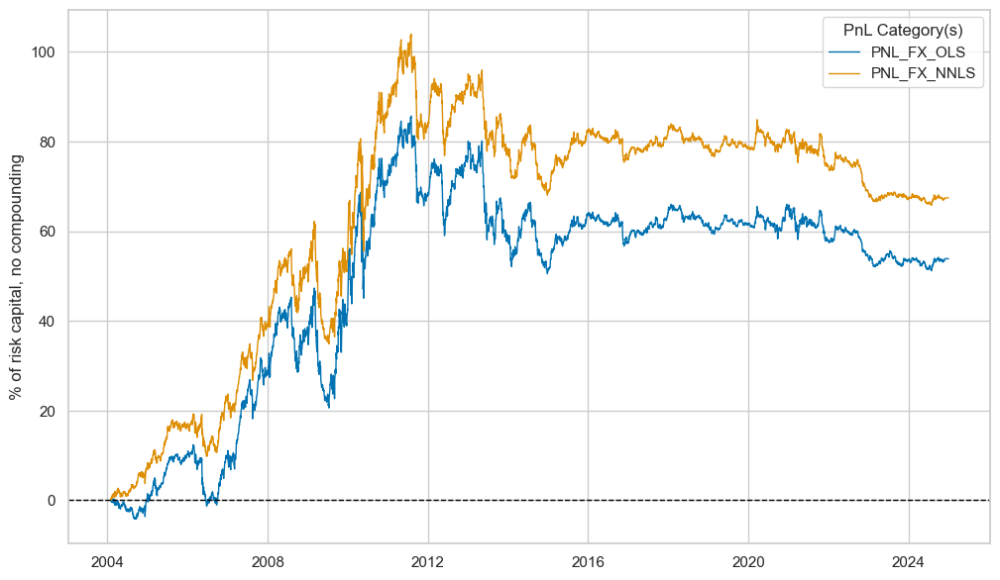

xcat,PNL_FX_OLS,PNL_FX_NNLS
Return %,2.576528,3.225414
St. Dev. %,10.0,10.0
Sharpe Ratio,0.257653,0.322541
Sortino Ratio,0.353471,0.443782
Max 21-Day Draw %,-23.578106,-25.09518
Max 6-Month Draw %,-22.345334,-23.737484
Peak to Trough Draw %,-35.169891,-38.203957
Top 5% Monthly PnL Share,1.606838,1.372499
USD_EQXR_NSA correl,0.113561,0.099298
Traded Months,252,252


In [83]:
sigs = sigs_fx_ls

pnl_fx_ls = msn.NaivePnL(
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs,
    cids=cids_fx,
    blacklist=fxblack,
    start="2004-01-01",
    bms=["USD_EQXR_NSA"],
)
for sig in sigs:
    pnl_fx_ls.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_fx_ls.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)
pnl_fx_ls.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

The method `create_results_dataframe()` from `macrosynergy.pnl` displays a small dataframe of key statistics for both signals:

In [84]:
results_fx_ls = msn.create_results_dataframe(
    title="Performance metrics, NNLS vs OLS, FX",
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs_fx_ls,
    cids=cids_fx,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    sig_negs=[False, False],
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"FX_OLS": "OLS", "FX_NNLS": "NNLS"},
    slip=1,
    blacklist=fxblack,
)
results_fx_ls

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
NNLS,0.524,0.515,0.025,0.025,0.323,0.444,0.099
OLS,0.526,0.517,0.021,0.023,0.258,0.353,0.114


#### Comparison

NNLS-based learning outperforms OLS-based learning based on all averages of performance metrics. PnL outperformance is small and gentle overtime, but consistent across time and types of strategies.

The empirical analysis provided two important lessons:

* NNLS produces greater model stability. This is mainly because NNLS excludes all theoretically implausible contributors to the signals and thus reduces the model construction options of the learning process. 
* The benefits of NNLS may only show only very gradually. In our data example, NNLS is not a game changer compared to OLS. Signals are broadly similar, which is not surprising, given that we only used a small set of features, most of which are conceptually different. However, long-term correlations and performance ratios ended up higher for all strategies over the 20 year periods.

In [85]:
results_ls = (results_du_ls.data + results_eq_ls.data + results_fx_ls.data) / 3
results_ls.style.format("{:.3f}").set_caption(
    "Averaged performance metrics, NNLS vs OLS"
).set_table_styles(
    [
        {
            "selector": "caption",
            "props": [("text-align", "center"), ("font-weight", "bold")],
        }
    ]
)

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
NNLS,0.543,0.520,0.052,0.036,0.502,0.693,0.251
OLS,0.544,0.521,0.041,0.029,0.445,0.613,0.249


### Elastic net

Elastic net is a flexible form of regularized regression. Regularization adds penalties to a model's objective function, often in accordance with the size of coefficients, in order to prevent overfitting. In the case of regression, the Lasso and Ridge models are employed to that end. Lasso penalizes the absolute size of coefficients (L1 penalty), which is shrinking coefficients, possibly all the way to zero. Ridge penalizes the squared size of coefficients (L2 penalty), which just shrinks the absolute value of coefficients. Elastic Net combines both L1 and L2 penalties. 

#### Duration

In [86]:
mods_du_en = {
    "en": Pipeline(
        [
            ("scaler", msl.PanelStandardScaler()),
            ("en", ElasticNet()),
        ]
    ),
}

grid_du_en = {
    "en": {
        "en__l1_ratio": [0.1, 0.25, 0.5, 0.75, 0.9],
        "en__alpha": [
            1e-4,
            1e-3,
            1e-2,
            1e-1,
            1,
            10,
            100,
            1000,
        ],
        "en__positive": [True, False],
        "en__fit_intercept": [True, False],
    },
}

mods_du_ls = {
    "ls": LinearRegression(),
}

grid_du_ls = {
    "ls": {
        "positive": [True, False],
        "fit_intercept": [True, False],
    },
}

As previously, the `SignalOptimizer` class is used for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_du`, and the targets in `y_du`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `DU_EN`.

  0%|          | 0/250 [00:00<?, ?it/s]

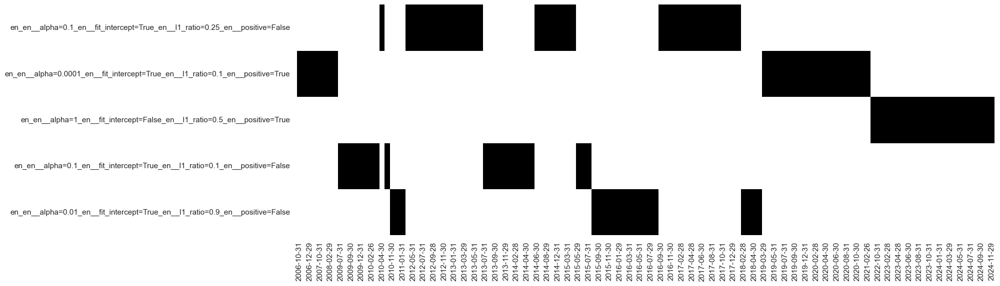

  0%|          | 0/250 [00:00<?, ?it/s]

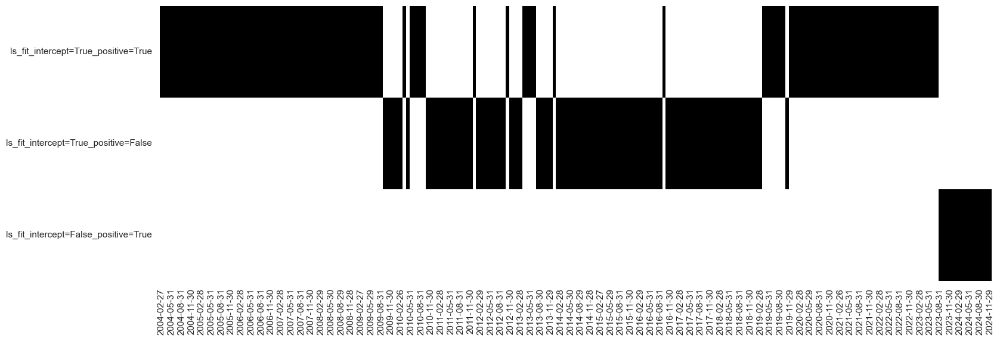

In [87]:
# Calculate predictions for EN
so_du.calculate_predictions(
    name = "DU_EN",
    models = mods_du_en,
    hyperparameters = grid_du_en,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_du.get_optimized_signals(name="DU_EN")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_du.models_heatmap(name="DU_EN", figsize=(18, 6))

# Compare with OLS/NNLS
so_du.calculate_predictions(
    name = "DU_LS",
    models = mods_du_ls,
    hyperparameters = grid_du_ls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_du.get_optimized_signals(name="DU_LS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_du.models_heatmap(name="DU_LS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) function in the `macrosynergy` package is used to display the signals: `DU_EN` and `DU_LS`.

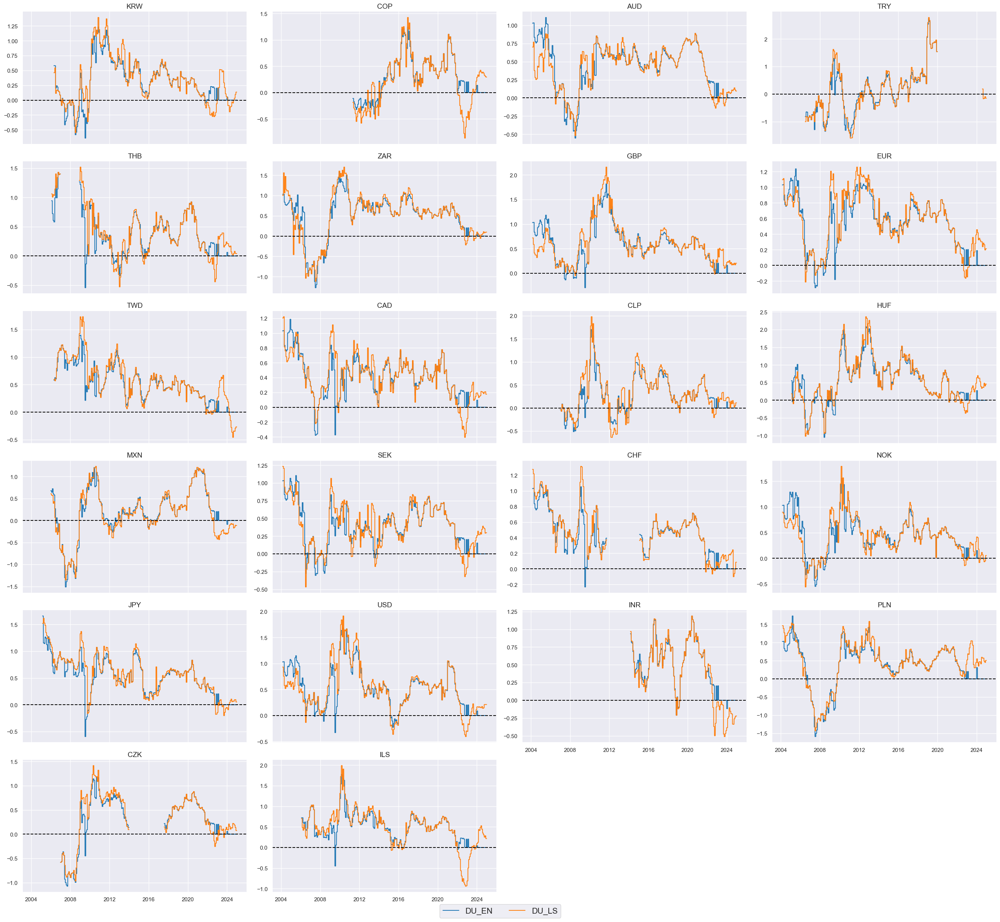

In [88]:
sigs_du_en = ["DU_EN", "DU_LS"]
xcatx = sigs_du_en

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_dux,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

#### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [89]:
## Compare optimized signals with simple average z-scores

srr_du_en = mss.SignalReturnRelations(
    df=dfx,
    rets=["DU05YXR_VT10"],
    sigs=sigs_du_en,
    cids=cids_dux,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
    blacklist=fxblack,
)

srr_du_en.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return       Signal Frequency Aggregation                                     
DU05YXR_VT10 DU_EN  M         last            0.524         0.500     0.889   
             DU_LS  M         last            0.533         0.514     0.849   

                                           pos_retr  pos_prec  neg_prec  \
Return       Signal Frequency Aggregation                                 
DU05YXR_VT10 DU_EN  M         last            0.530     0.530     0.470   
             DU_LS  M         last            0.537     0.541     0.488   

                                           pearson  pearson_pval  kendall  \
Return       Signal Frequency Aggregation                                   
DU05YXR_VT10 DU_EN  M         last           0.036         0.012    0.021   
             DU_LS  M         last           0.048         0.001    0.028   

                                           kendall_pval    auc  
Return       Signal Frequency Aggregation                       
DU05YXR_VT10 DU_EN  M         last                0.026  0.500  
             DU_LS  M         last                0.003  0.507

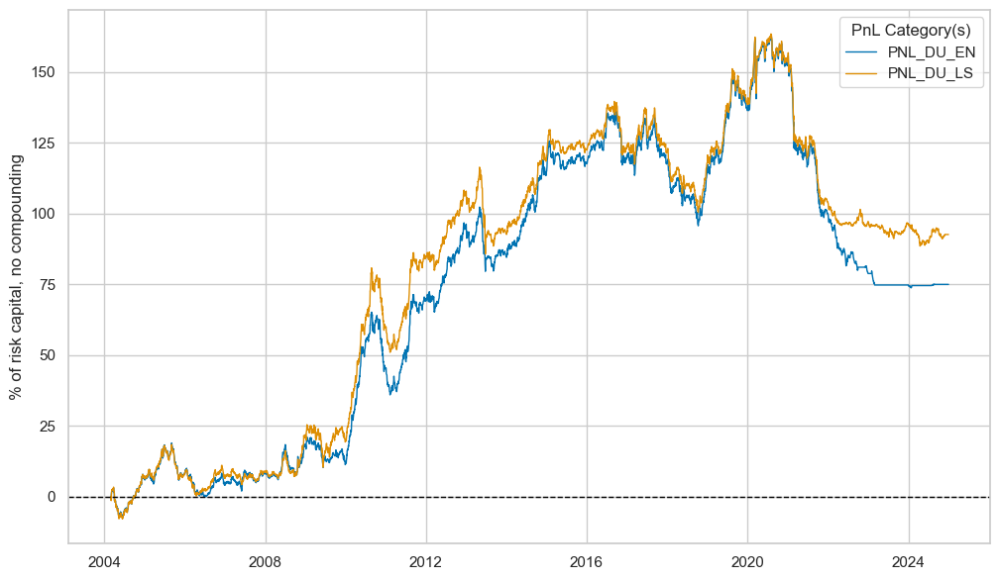

xcat,PNL_DU_EN,PNL_DU_LS
Return %,3.597209,4.442978
St. Dev. %,10.0,10.0
Sharpe Ratio,0.359721,0.444298
Sortino Ratio,0.495058,0.611872
Max 21-Day Draw %,-28.180268,-26.619051
Max 6-Month Draw %,-38.713663,-36.608636
Peak to Trough Draw %,-89.091715,-74.963419
Top 5% Monthly PnL Share,1.634231,1.341364
USD_GB10YXR_NSA correl,0.462878,0.469051
Traded Months,251,251


In [90]:
sigs = sigs_du_en

pnl_du_en = msn.NaivePnL(
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs,
    cids=cids_dux,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_GB10YXR_NSA"],
)
for sig in sigs:
    pnl_du_en.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )
pnl_du_en.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_du_en.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

The method `create_results_dataframe()` from `macrosynergy.pnl` displays a small dataframe of key statistics for both signals:

In [91]:
results_du_en = msn.create_results_dataframe(
    title="Performance metrics, Elastic Net vs Least Squares, duration",
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs_du_en,
    cids=cids_dux,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    sig_negs=[False, False],
    threshs=2,
    bm="USD_GB10YXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"DU_LS": "LS", "DU_EN": "EN"},
    slip=1,
    blacklist=fxblack,
)
results_du_en

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
EN,0.524,0.500,0.036,0.021,0.360,0.495,0.463
LS,0.533,0.514,0.048,0.028,0.444,0.612,0.469


#### Equity

In [92]:
mods_eq_en = {
    "en": Pipeline(
        [
            ("scaler", msl.PanelStandardScaler()),
            ("en", ElasticNet()),
        ]
    ),
}

grid_eq_en = {
    "en": {
        "en__l1_ratio": [0.1, 0.25, 0.5, 0.75, 0.9],
        "en__alpha": [
            1e-4,
            1e-3,
            1e-2,
            1e-1,
            1,
            10,
            100,
            1000,
        ],
        "en__positive": [True, False],
        "en__fit_intercept": [True, False],
    },
}

mods_eq_ls = {
    "ls": LinearRegression(),
}

grid_eq_ls = {
    "ls": {
        "positive": [True, False],
        "fit_intercept": [True, False],
    },
}

As previously, the `SignalOptimizer` class is used for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_eq`, and the targets in `y_eq`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `EQ_EN`.

  0%|          | 0/254 [00:00<?, ?it/s]

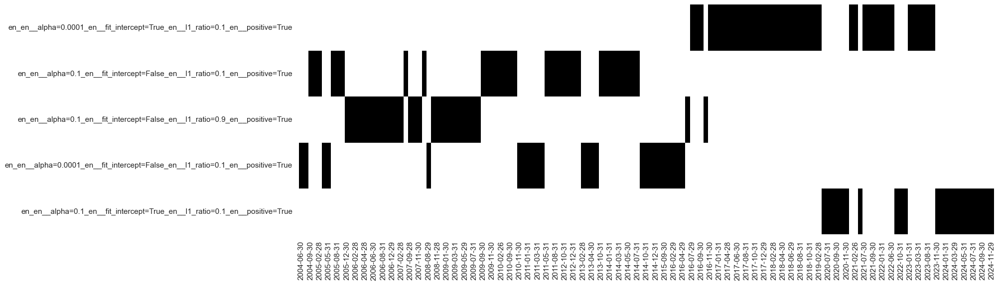

  0%|          | 0/254 [00:00<?, ?it/s]

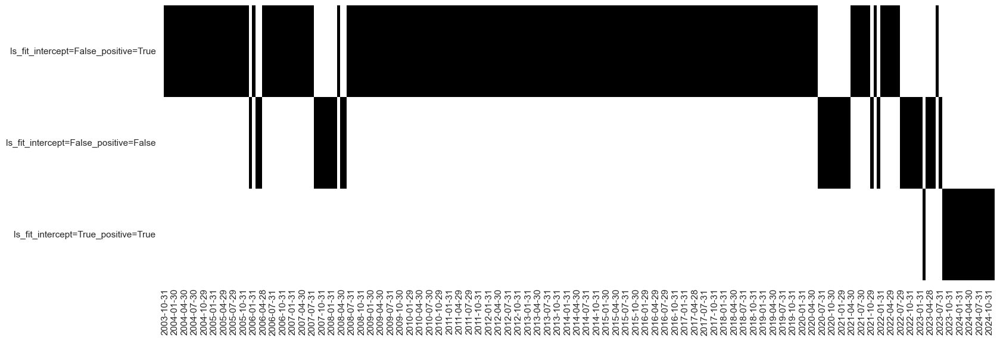

In [93]:
# Calculate predictions for EN
so_eq.calculate_predictions(
    name = "EQ_EN",
    models = mods_eq_en,
    hyperparameters = grid_eq_en,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_eq.get_optimized_signals(name="EQ_EN")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_eq.models_heatmap(name="EQ_EN", figsize=(18, 6))

# Compare with OLS/NNLS
so_eq.calculate_predictions(
    name = "EQ_LS",
    models = mods_eq_ls,
    hyperparameters = grid_eq_ls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_eq.get_optimized_signals(name="EQ_LS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_eq.models_heatmap(name="EQ_LS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) function in the `macrosynergy` package displays both signals `EQ_EN` and `EQ_LS`.

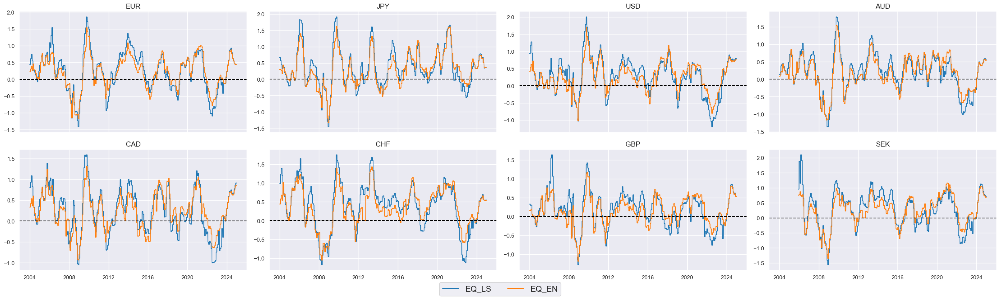

In [94]:
sigs_eq_en = ["EQ_LS", "EQ_EN"]
xcatx = sigs_eq_en

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_eq,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

#### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [95]:
## Compare optimized signals with simple average z-scores

srr_eq_en = mss.SignalReturnRelations(
    df=dfx,
    rets=["EQXR_VT10"],
    sigs=sigs_eq_en,
    cids=cids_eq,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
)

srr_eq_en.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal Frequency Aggregation                                     
EQXR_VT10 EQ_LS  M         last            0.567         0.522     0.703   
          EQ_EN  M         last            0.580         0.539     0.715   

                                        pos_retr  pos_prec  neg_prec  pearson  \
Return    Signal Frequency Aggregation                                          
EQXR_VT10 EQ_LS  M         last            0.619     0.632     0.412    0.064   
          EQ_EN  M         last            0.612     0.634     0.444    0.070   

                                        pearson_pval  kendall  kendall_pval  \
Return    Signal Frequency Aggregation                                        
EQXR_VT10 EQ_LS  M         last                0.004    0.036         0.017   
          EQ_EN  M         last                0.002    0.039         0.009   

                                          auc  
Return    Signal Frequency Aggregation         
EQXR_VT10 EQ_LS  M         last         0.519  
          EQ_EN  M         last         0.533

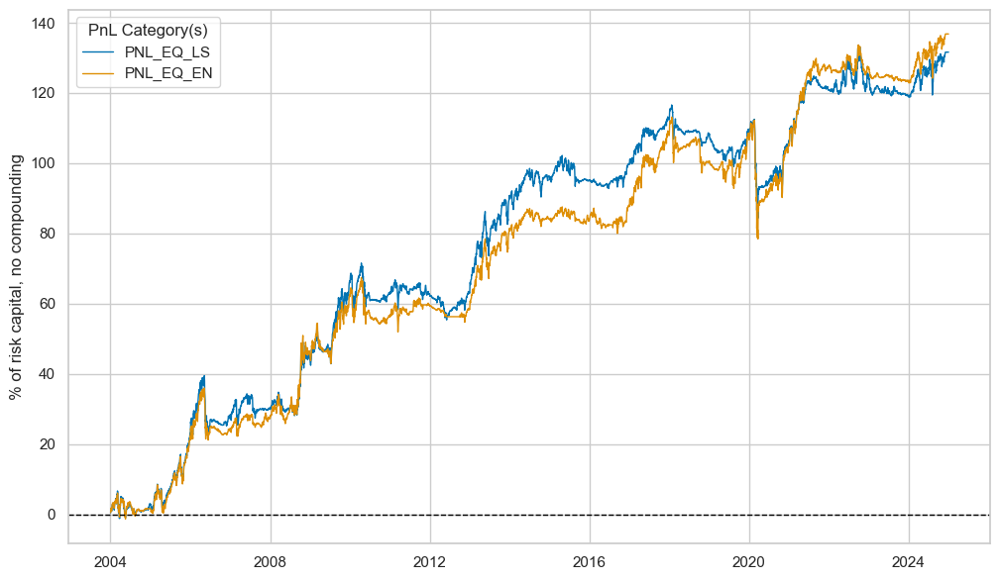

xcat,PNL_EQ_LS,PNL_EQ_EN
Return %,6.269198,6.516099
St. Dev. %,10.0,10.0
Sharpe Ratio,0.62692,0.65161
Sortino Ratio,0.863988,0.893595
Max 21-Day Draw %,-27.193386,-32.625588
Max 6-Month Draw %,-19.239694,-21.141053
Peak to Trough Draw %,-32.236223,-34.681415
Top 5% Monthly PnL Share,0.670943,0.605796
USD_EQXR_NSA correl,0.184682,0.194135
Traded Months,252,252


In [96]:
sigs = sigs_eq_en

pnl_eq_en = msn.NaivePnL(
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs,
    cids=cids_eq,
    start="2004-01-01",
    bms=["USD_EQXR_NSA"],
)
for sig in sigs:
    pnl_eq_en.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )
pnl_eq_en.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_eq_en.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [97]:
results_eq_en = msn.create_results_dataframe(
    title="Performance metrics, Elastic Net vs Least Squares, equity",
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs_eq_en,
    cids=cids_eq,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    sig_negs=[False, False],
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"EQ_LS": "LS", "EQ_EN": "EN"},
    slip=1,
)
results_eq_en

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
EN,0.580,0.539,0.070,0.039,0.652,0.894,0.194
LS,0.567,0.522,0.064,0.036,0.627,0.864,0.185


#### FX

In [98]:
mods_fx_en = {
    "en": Pipeline(
        [
            ("scaler", msl.PanelStandardScaler()),
            ("en", ElasticNet(max_iter=10000)),
        ]
    ),
}

grid_fx_en = {
    "en": {
        "en__l1_ratio": [0.1, 0.25, 0.5, 0.75, 0.9],
        "en__alpha": [
            1e-4,
            1e-3,
            1e-2,
            1e-1,
            1,
            10,
            100,
            1000,
        ],
        "en__positive": [True, False],
        "en__fit_intercept": [True, False],
    },
}

mods_fx_ls = {
    "ls": LinearRegression(),
}

grid_fx_ls = {
    "ls": {
        "positive": [True, False],
        "fit_intercept": [True, False],
    },
}

As previously, the `SignalOptimizer` class for sequential optimization of raw signals is based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_fx`, and the targets in `y_fx`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `FX_EN`.

  0%|          | 0/251 [00:00<?, ?it/s]

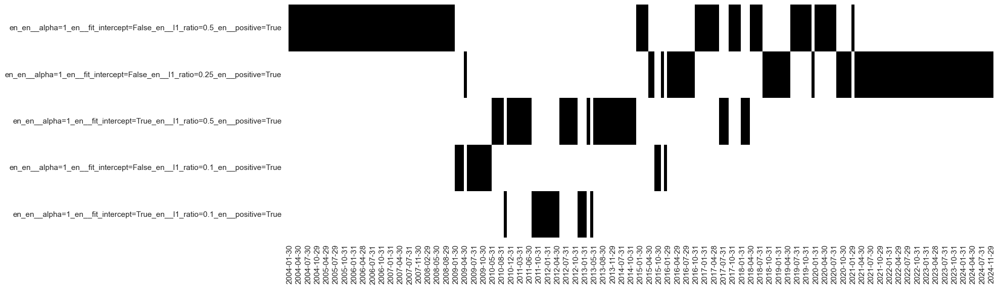

  0%|          | 0/251 [00:00<?, ?it/s]

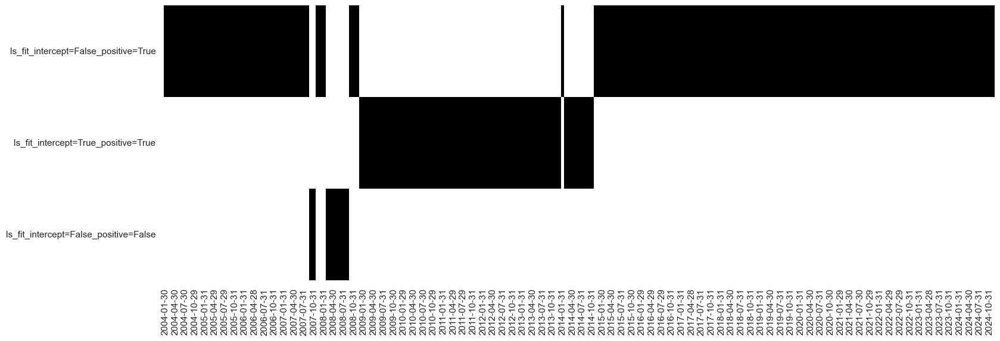

In [99]:
# Calculate predictions for EN
so_fx.calculate_predictions(
    name = "FX_EN",
    models = mods_fx_en,
    hyperparameters = grid_fx_en,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_fx.get_optimized_signals(name="FX_EN")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_fx.models_heatmap(name="FX_EN", figsize=(18, 6))

# Compare with OLS/NNLS
so_fx.calculate_predictions(
    name = "FX_LS",
    models = mods_fx_ls,
    hyperparameters = grid_fx_ls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_fx.get_optimized_signals(name="FX_LS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_fx.models_heatmap(name="FX_LS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `FX_EN` and `FX_LS`:

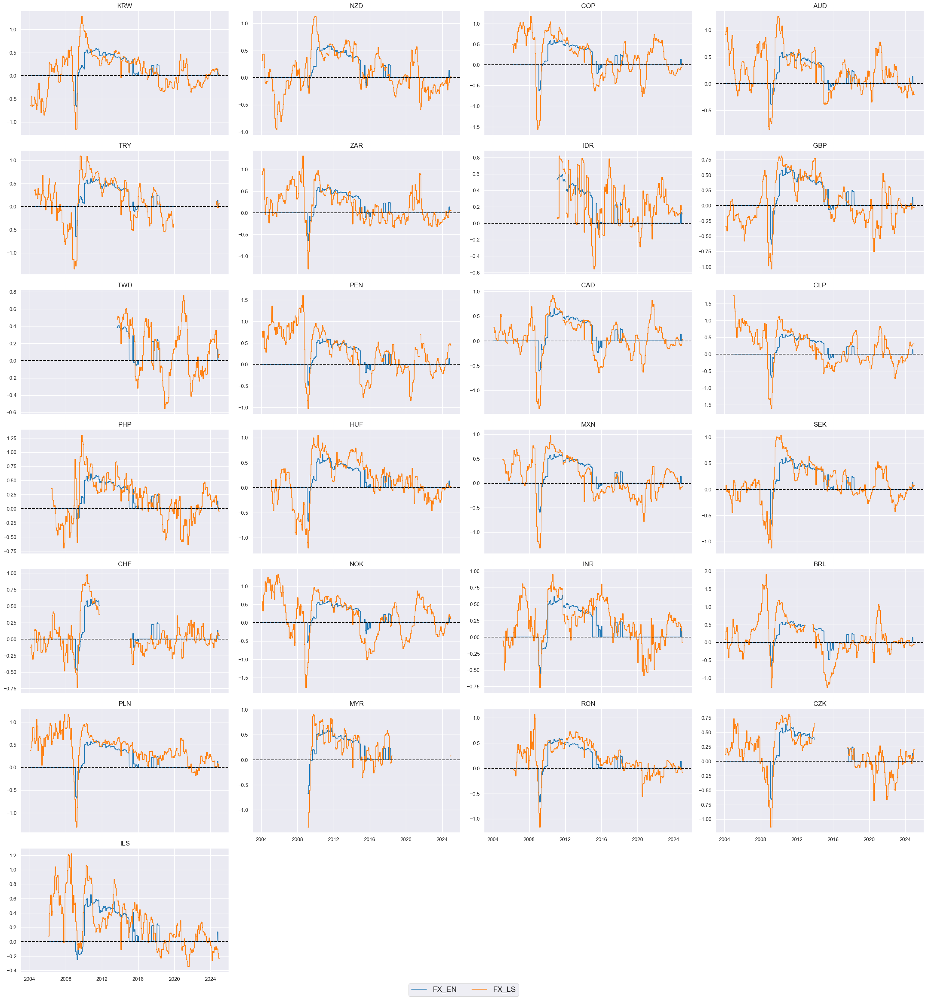

In [100]:
sigs_fx_en = ["FX_EN", "FX_LS"]

xcatx = sigs_fx_en

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_fx,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

#### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [101]:
## Compare optimized signals with simple average z-scores

srr_fx_en = mss.SignalReturnRelations(
    df=dfx,
    rets=["FXXR_VT10"],
    sigs=sigs_fx_en,
    cids=cids_fx,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
    blacklist=fxblack,
)

srr_fx_en.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal Frequency Aggregation                                     
FXXR_VT10 FX_EN  M         last            0.518         0.477     0.888   
          FX_LS  M         last            0.523         0.514     0.663   

                                        pos_retr  pos_prec  neg_prec  pearson  \
Return    Signal Frequency Aggregation                                          
FXXR_VT10 FX_EN  M         last            0.535     0.530     0.425   -0.028   
          FX_LS  M         last            0.534     0.543     0.484    0.022   

                                        pearson_pval  kendall  kendall_pval  \
Return    Signal Frequency Aggregation                                        
FXXR_VT10 FX_EN  M         last                0.034   -0.009         0.367   
          FX_LS  M         last                0.104    0.024         0.007   

                                          auc  
Return    Signal Frequency Aggregation         
FXXR_VT10 FX_EN  M         last         0.491  
          FX_LS  M         last         0.512

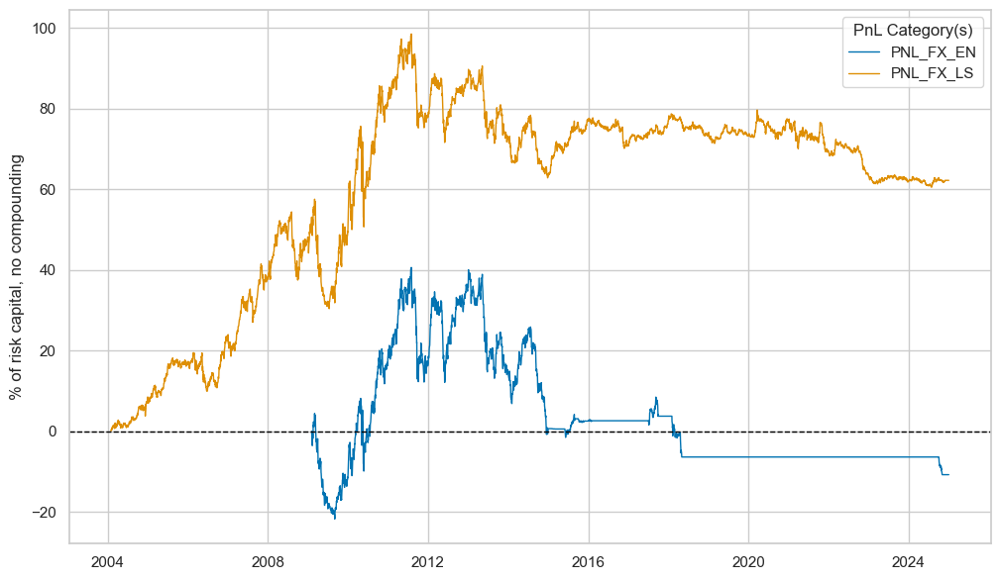

xcat,PNL_FX_EN,PNL_FX_LS
Return %,-0.680013,2.973921
St. Dev. %,10.0,10.0
Sharpe Ratio,-0.068001,0.297392
Sortino Ratio,-0.104872,0.408613
Max 21-Day Draw %,-21.187621,-24.941009
Max 6-Month Draw %,-25.844817,-23.668059
Peak to Trough Draw %,-51.401409,-37.957949
Top 5% Monthly PnL Share,-9.051433,1.501754
USD_EQXR_NSA correl,0.186796,0.100501
Traded Months,252,252


In [102]:
sigs = sigs_fx_en

pnl_fx_en = msn.NaivePnL(
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs,
    cids=cids_fx,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_EQXR_NSA"],
)
for sig in sigs:
    pnl_fx_en.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )
pnl_fx_en.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_fx_en.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [103]:
results_fx_en = msn.create_results_dataframe(
    title="Performance metrics, Elastic Net vs Least Squares, FX",
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs_fx_en,
    cids=cids_fx,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"FX_LS": "LS", "FX_EN": "EN"},
    slip=1,
    blacklist=fxblack,
)
results_fx_en

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
EN,0.518,0.477,-0.028,-0.009,-0.068,-0.105,0.187
LS,0.523,0.514,0.022,0.024,0.297,0.409,0.101


#### Comparison

In our data examples, elastic net on average produced signals with higher accuracy, but lower correlation and PnL performance ratios. For the duration and equity strategies the elastic produced very similar PnL profiles as OLS-based signals. However, the elastic net-based learning process “overregularized” features for the FX space and failed to produce non-zero signals prior to 2008 and after 2018. 

The empirical analysis provides two important lessons:

* Elastic net may make excessive demands on financial return predictors. Regularized regressions that include a heavy L1 penalty can easily remove all features if they are sufficient in number and quality. And high predictive quality does not come easily for financial returns. 
* Elastic net has a penchant for sporadic instability of signals. This arises from the greater number of hyperparameters that the statistical learning process can choose from. Hyperparameter instability is consequential for transaction costs and recorded signal-return correlation.

In [104]:
results_en = (results_du_en.data + results_eq_en.data + results_fx_en.data) / 3
results_en.style.format("{:.3f}").set_caption(
    "Averaged performance metrics, Elastic Net vs Least Squares"
).set_table_styles(
    [
        {
            "selector": "caption",
            "props": [("text-align", "center"), ("font-weight", "bold")],
        }
    ]
)

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
EN,0.541,0.505,0.026,0.017,0.315,0.428,0.281
LS,0.541,0.517,0.045,0.029,0.456,0.628,0.252


### Time-weighted least squares

Weighted Least Squares (WLS) is form of generalized least squares that increases the importance of some samples relative to others. Time-Weighted Least Squares (TWLS) allows to prioritise more recent information in the model fit by defining a half-life of an exponential decay in units of the native dataset frequency. The half-life of the decay is one the hyperparameters which the learning process determines over time.

#### Duration

In [105]:
mods_du_twls = {
    "twls": msl.TimeWeightedLinearRegression(),
}

grid_du_twls = {
    "twls": {
        "half_life": [
            12 * 1,
            12 * 3,
            12 * 5,
            12 * 10,
            12 * 20,
        ],
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
}

As previously, the `SignalOptimizer` class allows for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_du`, and the targets in `y_du`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `DU_TWLS`.

  0%|          | 0/250 [00:00<?, ?it/s]

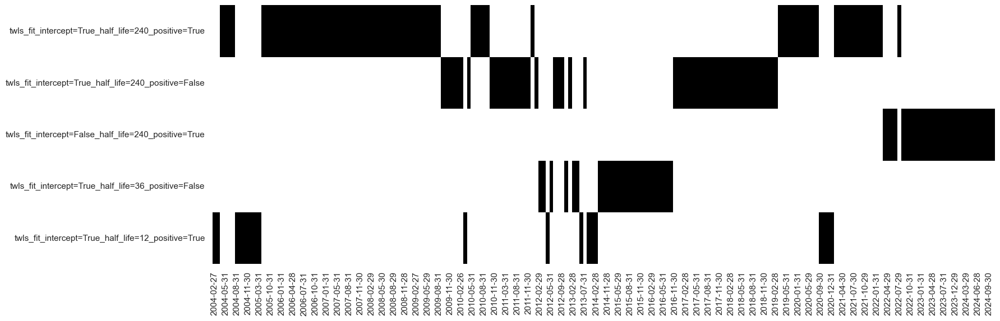

In [106]:
# Calculate predictions
so_du.calculate_predictions(
    name = "DU_TWLS",
    models = mods_du_twls,
    hyperparameters = grid_du_twls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_du.get_optimized_signals(name="DU_TWLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_du.models_heatmap(name="DU_TWLS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `DU_TWLS` and `DU_LS`.

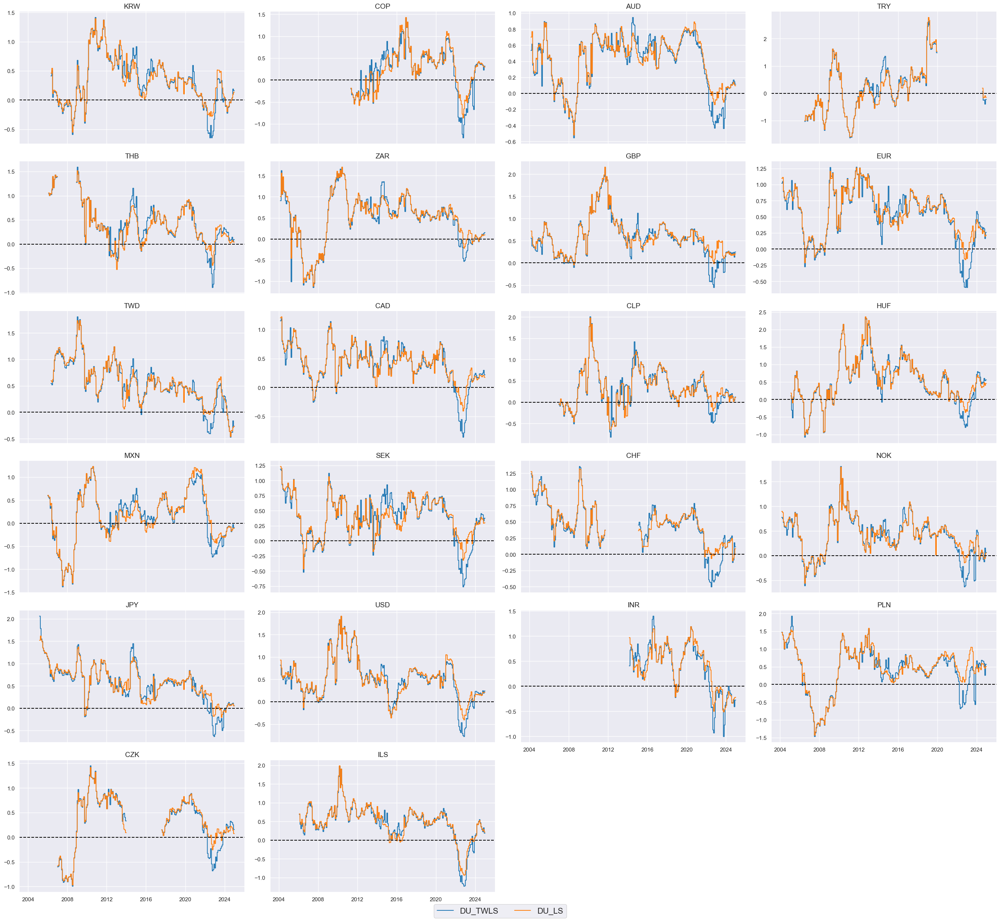

In [107]:
sigs_du_twls = ["DU_TWLS", "DU_LS"]
xcatx = sigs_du_twls

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_dux,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [108]:
## Compare optimized signals with simple average z-scores

srr_du_twls = mss.SignalReturnRelations(
    df=dfx,
    rets=["DU05YXR_VT10"],
    sigs=sigs_du_twls,
    cids=cids_dux,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
    blacklist=fxblack,
)

srr_du_twls.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return       Signal  Frequency Aggregation                                     
DU05YXR_VT10 DU_TWLS M         last            0.539         0.526     0.821   
             DU_LS   M         last            0.533         0.514     0.849   

                                            pos_retr  pos_prec  neg_prec  \
Return       Signal  Frequency Aggregation                                 
DU05YXR_VT10 DU_TWLS M         last            0.537     0.546     0.506   
             DU_LS   M         last            0.537     0.541     0.488   

                                            pearson  pearson_pval  kendall  \
Return       Signal  Frequency Aggregation                                   
DU05YXR_VT10 DU_TWLS M         last           0.060         0.000    0.036   
             DU_LS   M         last           0.048         0.001    0.028   

                                            kendall_pval    auc  
Return       Signal  Frequency Aggregation                       
DU05YXR_VT10 DU_TWLS M         last                0.000  0.516  
             DU_LS   M         last                0.003  0.507

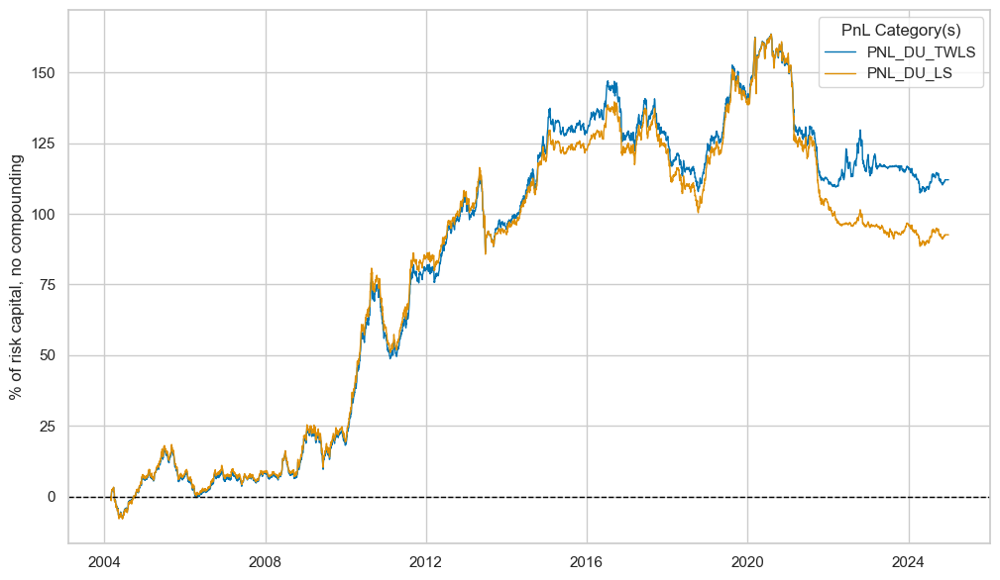

xcat,PNL_DU_TWLS,PNL_DU_LS
Return %,5.376582,4.442978
St. Dev. %,10.0,10.0
Sharpe Ratio,0.537658,0.444298
Sortino Ratio,0.746149,0.611872
Max 21-Day Draw %,-22.151691,-26.619051
Max 6-Month Draw %,-31.935035,-36.608636
Peak to Trough Draw %,-56.274285,-74.963419
Top 5% Monthly PnL Share,1.143594,1.341364
USD_GB10YXR_NSA correl,0.393519,0.469051
Traded Months,251,251


In [109]:
sigs = sigs_du_twls

pnl_du_twls = msn.NaivePnL(
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs_du_twls,
    cids=cids_dux,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_GB10YXR_NSA"],
)
for sig in sigs:
    pnl_du_twls.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )
pnl_du_twls.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_du_twls.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [110]:
results_du_twls = msn.create_results_dataframe(
    title="Performance metrics, LS vs TWLS, duration",
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs_du_twls,
    cids=cids_dux,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_GB10YXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"DU_LS": "LS", "DU_TWLS": "TWLS"},
    slip=1,
    blacklist=fxblack,
)
results_du_twls

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LS,0.533,0.514,0.048,0.028,0.444,0.612,0.469
TWLS,0.539,0.526,0.060,0.036,0.538,0.746,0.394


#### Equity

In [111]:
mods_eq_twls = {
    "twls": msl.TimeWeightedLinearRegression(),
}

grid_eq_twls = {
    "twls": {
        "half_life": [
            12 * 1,
            12 * 3,
            12 * 5,
            12 * 10,
            12 * 20,
        ],
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
}

As previously, the `SignalOptimizer` class allows for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_eq`, and the targets in `y_eq`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `EQ_TWLS`.

  0%|          | 0/254 [00:00<?, ?it/s]

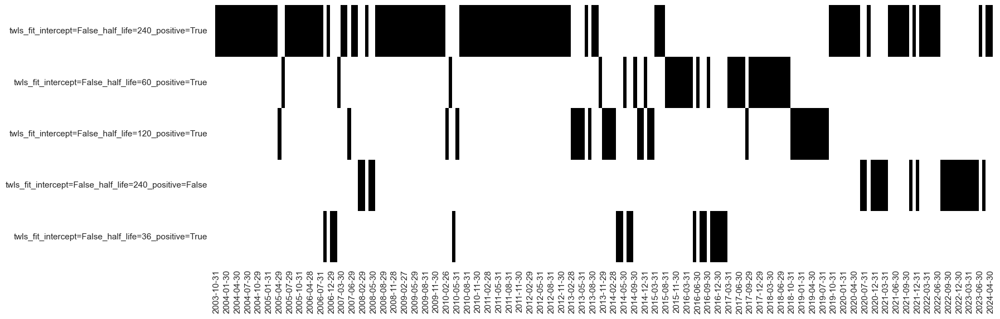

In [112]:
# Calculate predictions
so_eq.calculate_predictions(
    name = "EQ_TWLS",
    models = mods_eq_twls,
    hyperparameters = grid_eq_twls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_eq.get_optimized_signals(name="EQ_TWLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_eq.models_heatmap(name="EQ_TWLS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `EQ_TWLS` and `EQ_LS`.

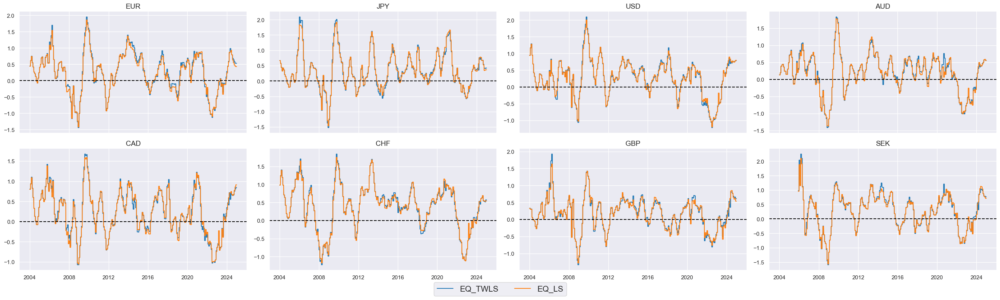

In [113]:
sigs_eq_twls = ["EQ_TWLS", "EQ_LS"]
xcatx = sigs_eq_twls

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_eq,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [114]:
## Compare optimized signals with simple average z-scores

srr_eq_twls = mss.SignalReturnRelations(
    df=dfx,
    rets=["EQXR_VT10"],
    sigs=sigs_eq_twls,
    cids=cids_eq,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
)

srr_eq_twls.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal  Frequency Aggregation                                     
EQXR_VT10 EQ_TWLS M         last            0.575         0.531     0.710   
          EQ_LS   M         last            0.567         0.522     0.703   

                                         pos_retr  pos_prec  neg_prec  \
Return    Signal  Frequency Aggregation                                 
EQXR_VT10 EQ_TWLS M         last            0.619     0.637     0.424   
          EQ_LS   M         last            0.619     0.632     0.412   

                                         pearson  pearson_pval  kendall  \
Return    Signal  Frequency Aggregation                                   
EQXR_VT10 EQ_TWLS M         last           0.063         0.005    0.035   
          EQ_LS   M         last           0.064         0.004    0.036   

                                         kendall_pval    auc  
Return    Signal  Frequency Aggregation                       
EQXR_VT10 EQ_TWLS M         last                0.020  0.527  
          EQ_LS   M         last                0.017  0.519

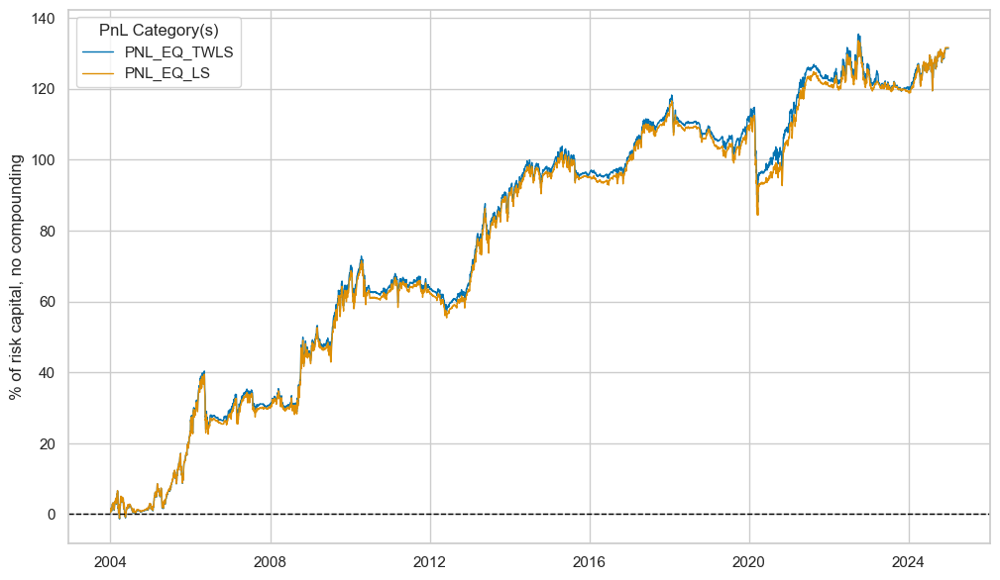

xcat,PNL_EQ_TWLS,PNL_EQ_LS
Return %,6.257572,6.269198
St. Dev. %,10.0,10.0
Sharpe Ratio,0.625757,0.62692
Sortino Ratio,0.862467,0.863988
Max 21-Day Draw %,-25.879441,-27.193386
Max 6-Month Draw %,-17.799325,-19.239694
Peak to Trough Draw %,-30.242009,-32.236223
Top 5% Monthly PnL Share,0.673875,0.670943
USD_EQXR_NSA correl,0.177943,0.184682
Traded Months,252,252


In [115]:
sigs = sigs_eq_twls

pnl_eq_twls = msn.NaivePnL(
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs,
    cids=cids_eq,
    start="2004-01-01",
    bms=["USD_EQXR_NSA"],
)
for sig in sigs:
    pnl_eq_twls.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )
pnl_eq_twls.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_eq_twls.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [116]:
results_eq_twls = msn.create_results_dataframe(
    title="Performance metrics, LS vs TWLS, equity",
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs_eq_twls,
    cids=cids_eq,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"EQ_LS": "LS", "EQ_TWLS": "TWLS"},
    slip=1,
)
results_eq_twls

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LS,0.567,0.522,0.064,0.036,0.627,0.864,0.185
TWLS,0.575,0.531,0.063,0.035,0.626,0.862,0.178


#### FX

In [117]:
mods_fx_twls = {
    "twls": msl.TimeWeightedLinearRegression(),
}

grid_fx_twls = {
    "twls": {
        "half_life": [
            12 * 1,
            12 * 3,
            12 * 5,
            12 * 10,
            12 * 20,
        ],
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
}

As previously, the `SignalOptimizer` class allows for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_fx`, and the targets in `y_fx`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `FX_TWLS`.

  0%|          | 0/251 [00:00<?, ?it/s]

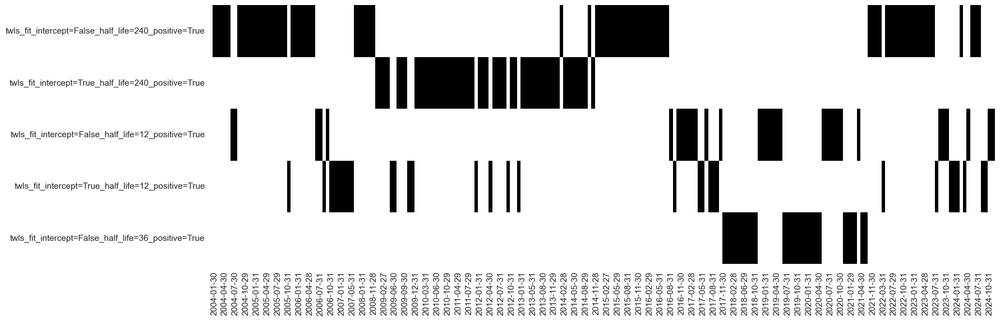

In [118]:
# Calculate predictions
so_fx.calculate_predictions(
    name = "FX_TWLS",
    models = mods_fx_twls,
    hyperparameters = grid_fx_twls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_fx.get_optimized_signals(name="FX_TWLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_fx.models_heatmap(name="FX_TWLS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `FX_TWLS` and `FX_LS`.

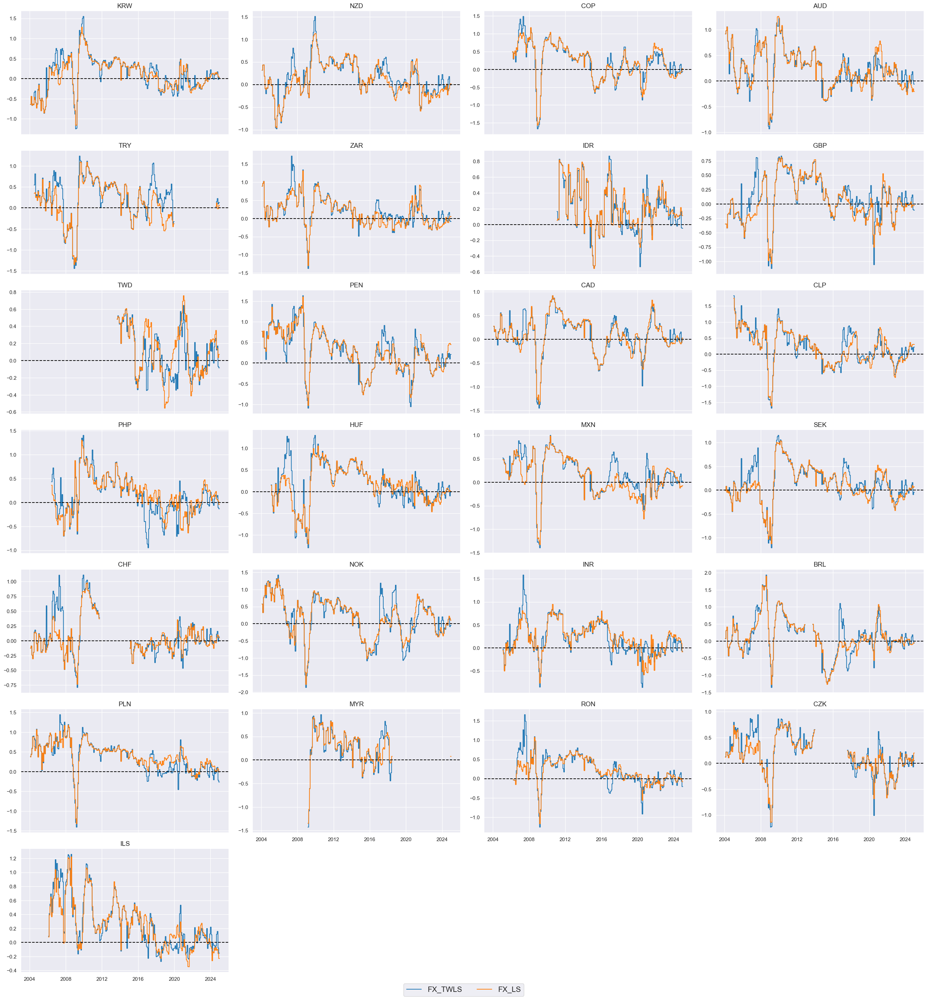

In [119]:
sigs_fx_twls = ["FX_TWLS", "FX_LS"]
xcatx = sigs_fx_twls

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_fx,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [120]:
## Compare optimized signals with simple average z-scores

srr_fx_twls = mss.SignalReturnRelations(
    df=dfx,
    rets=["FXXR_VT10"],
    sigs=sigs_fx_twls,
    cids=cids_fx,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
    blacklist=fxblack,
)

srr_fx_twls.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal  Frequency Aggregation                                     
FXXR_VT10 FX_TWLS M         last            0.516         0.505     0.673   
          FX_LS   M         last            0.523         0.514     0.663   

                                         pos_retr  pos_prec  neg_prec  \
Return    Signal  Frequency Aggregation                                 
FXXR_VT10 FX_TWLS M         last            0.534     0.537     0.473   
          FX_LS   M         last            0.534     0.543     0.484   

                                         pearson  pearson_pval  kendall  \
Return    Signal  Frequency Aggregation                                   
FXXR_VT10 FX_TWLS M         last           0.028         0.035    0.024   
          FX_LS   M         last           0.022         0.104    0.024   

                                         kendall_pval    auc  
Return    Signal  Frequency Aggregation                       
FXXR_VT10 FX_TWLS M         last                0.006  0.505  
          FX_LS   M         last                0.007  0.512

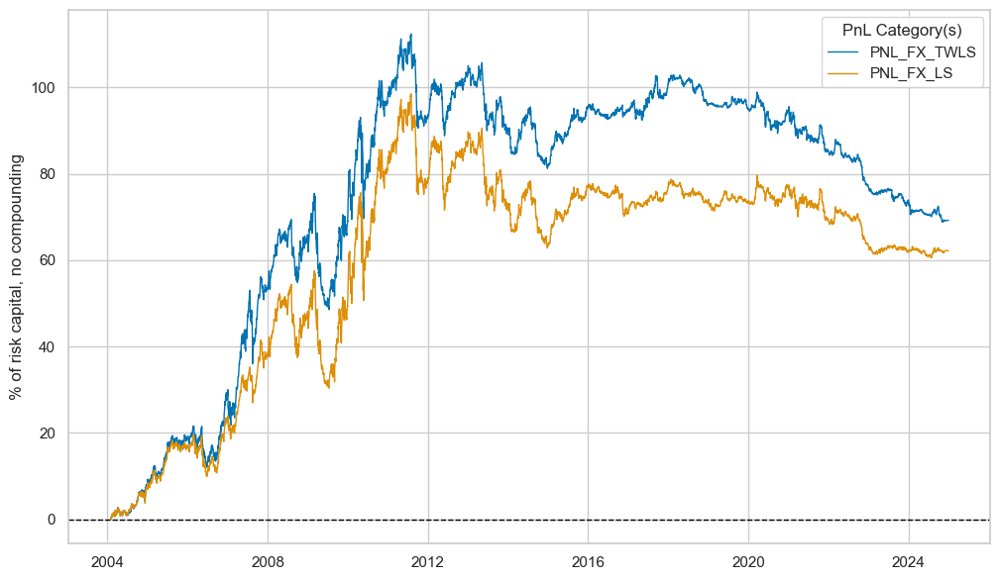

xcat,PNL_FX_TWLS,PNL_FX_LS
Return %,3.309408,2.973921
St. Dev. %,10.0,10.0
Sharpe Ratio,0.330941,0.297392
Sortino Ratio,0.454838,0.408613
Max 21-Day Draw %,-23.418964,-24.941009
Max 6-Month Draw %,-21.832061,-23.668059
Peak to Trough Draw %,-43.592199,-37.957949
Top 5% Monthly PnL Share,1.30991,1.501754
USD_EQXR_NSA correl,0.097606,0.100501
Traded Months,252,252


In [121]:
sigs = sigs_fx_twls

pnl_fx_twls = msn.NaivePnL(
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs,
    cids=cids_fx,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_EQXR_NSA"],
)
for sig in sigs:
    pnl_fx_twls.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )
pnl_fx_twls.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_fx_twls.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [122]:
results_fx_twls = msn.create_results_dataframe(
    title="Performance metrics, LS vs TWLS, FX",
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs_fx_twls,
    cids=cids_fx,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"FX_LS": "LS", "FX_TWLS": "TWLS"},
    slip=1,
    blacklist=fxblack,
)
results_fx_twls

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LS,0.523,0.514,0.022,0.024,0.297,0.409,0.101
TWLS,0.516,0.505,0.028,0.024,0.331,0.455,0.098


#### Comparison

On average, the usage of time-weighted least squares in the learning process has produced modestly higher performance accuracy, correlation and PnL performance ratios.

There are a few important empirical lessons:

* The TWLS-based learning process tends to produce greater signal instability. Generally, the learning process with TWLS models likes to use constants more than the OLS/NNLS-based process. This seems to be another consequence of the focus on more recent history. Recent seasonality of returns or omitted explanatory variables result in better cross-validation results for models with constant. However, this way the TWLS constants become estimates of recent return trends, particularly if shorter half-lives are chosen.
* TWLS methods like non-negativity restrictions: Time-weighted least squares almost exclusively uses non-negative least squares. The behaviour of hyperparameter optimization is line with theory: shorter effective lookback periods call for more restrictions as the bias-variance trade-off is quite poor.

In [123]:
results_twls = (results_du_twls.data + results_eq_twls.data + results_fx_twls.data) / 3
results_twls.style.format("{:.3f}").set_caption(
    "Averaged performance metrics, LS vs TWLS"
).set_table_styles(
    [
        {
            "selector": "caption",
            "props": [("text-align", "center"), ("font-weight", "bold")],
        }
    ]
)

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LS,0.541,0.517,0.045,0.029,0.456,0.628,0.252
TWLS,0.543,0.521,0.050,0.032,0.498,0.688,0.223


### Sign-weighted least squares

Sign-weighted least squares (SWLS) equalises the contribution of positive and negative samples to the model fit. If, for example, returns are predominantly positive then historic observations with negative target returns are assigned higher weights that those with negative returns. This mitigates the directional bias in general and largely removes any bias that manifests through the recession constant.

#### Duration

In [124]:
mods_du_swls = {
    "swls": msl.SignWeightedLinearRegression(),
}

grid_du_swls = {
    "swls": {
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
}

As previously, `SignalOptimizer` class for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_du`, and the targets in `y_du`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `DU_SWLS`

  0%|          | 0/250 [00:00<?, ?it/s]

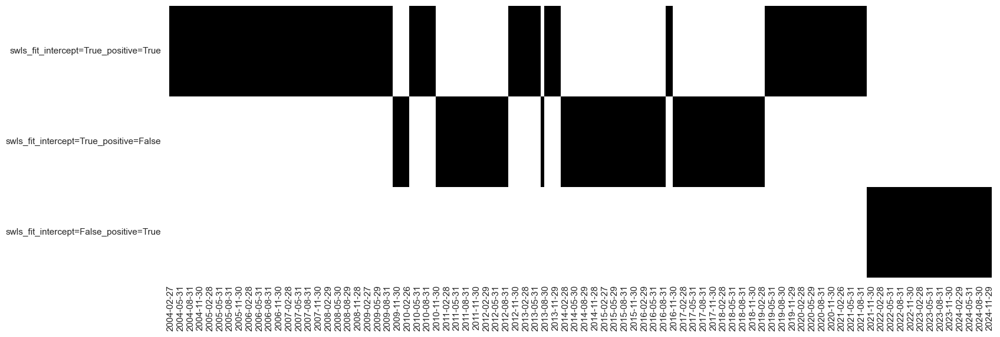

In [125]:
# Calculate predictions
so_du.calculate_predictions(
    name = "DU_SWLS",
    models = mods_du_swls,
    hyperparameters = grid_du_swls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_du.get_optimized_signals(name="DU_SWLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_du.models_heatmap(name="DU_SWLS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `DU_SWLS` and `DU_LS`.

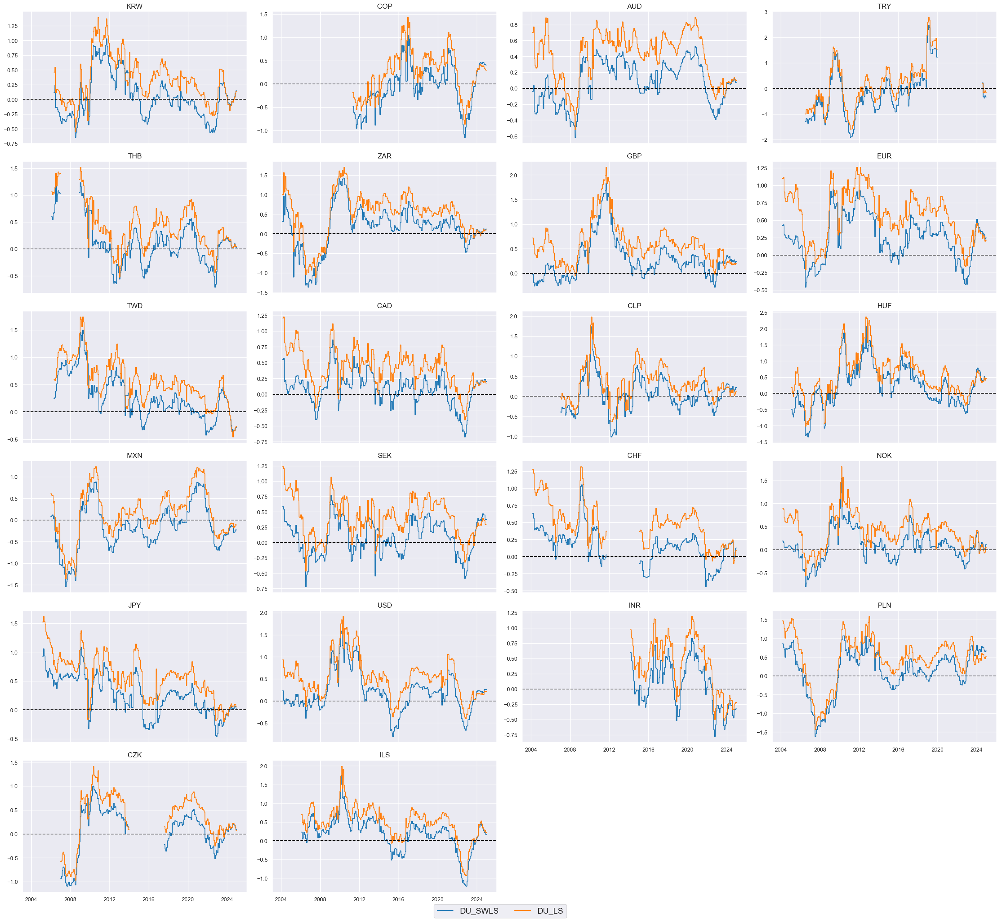

In [126]:
sigs_du_swls = ["DU_SWLS", "DU_LS"]
xcatx = sigs_du_swls

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_dux,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [127]:
## Compare optimized signals with simple average z-scores

srr_du_swls = mss.SignalReturnRelations(
    df=dfx,
    rets=["DU05YXR_VT10"],
    sigs=sigs_du_swls,
    cids=cids_dux,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
    blacklist=fxblack,
)

srr_du_swls.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return       Signal  Frequency Aggregation                                     
DU05YXR_VT10 DU_SWLS M         last            0.531         0.522     0.637   
             DU_LS   M         last            0.533         0.514     0.849   

                                            pos_retr  pos_prec  neg_prec  \
Return       Signal  Frequency Aggregation                                 
DU05YXR_VT10 DU_SWLS M         last            0.537     0.553     0.492   
             DU_LS   M         last            0.537     0.541     0.488   

                                            pearson  pearson_pval  kendall  \
Return       Signal  Frequency Aggregation                                   
DU05YXR_VT10 DU_SWLS M         last           0.053         0.000    0.034   
             DU_LS   M         last           0.048         0.001    0.028   

                                            kendall_pval    auc  
Return       Signal  Frequency Aggregation                       
DU05YXR_VT10 DU_SWLS M         last                0.000  0.521  
             DU_LS   M         last                0.003  0.507

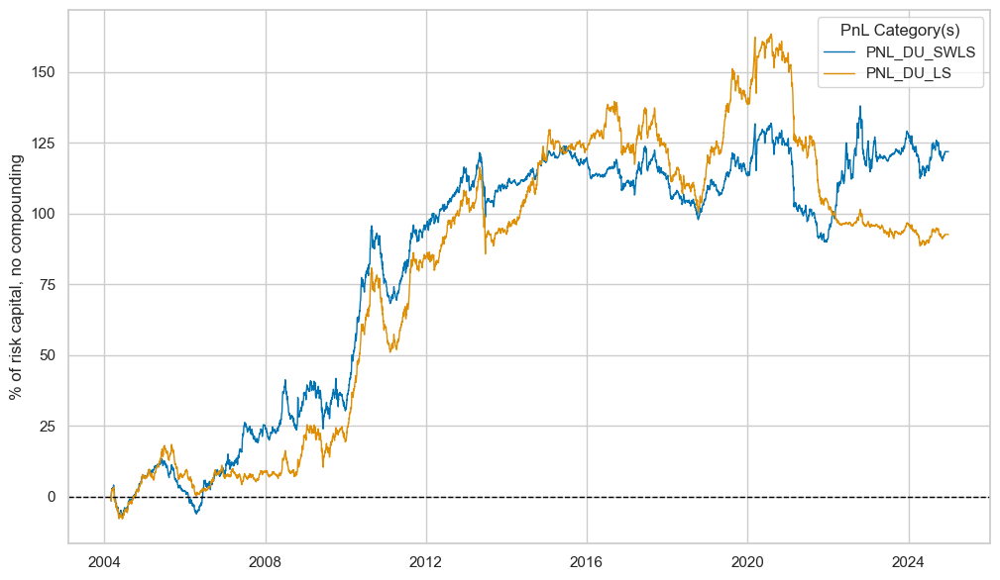

xcat,PNL_DU_SWLS,PNL_DU_LS
Return %,5.848654,4.442978
St. Dev. %,10.0,10.0
Sharpe Ratio,0.584865,0.444298
Sortino Ratio,0.819339,0.611872
Max 21-Day Draw %,-20.800767,-26.619051
Max 6-Month Draw %,-28.467264,-36.608636
Peak to Trough Draw %,-42.087012,-74.963419
Top 5% Monthly PnL Share,0.968484,1.341364
USD_GB10YXR_NSA correl,0.239966,0.469051
Traded Months,251,251


In [128]:
sigs = sigs_du_swls

pnl_du_swls = msn.NaivePnL(
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs,
    cids=cids_dux,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_GB10YXR_NSA"],
)
for sig in sigs:
    pnl_du_swls.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )
pnl_du_swls.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_du_swls.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [129]:
results_du_swls = msn.create_results_dataframe(
    title="Performance metrics, LS vs SWLS, duration",
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs_du_swls,
    cids=cids_dux,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_GB10YXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"DU_LS": "LS", "DU_SWLS": "SWLS"},
    slip=1,
    blacklist=fxblack,
)
results_du_swls

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LS,0.533,0.514,0.048,0.028,0.444,0.612,0.469
SWLS,0.531,0.522,0.053,0.034,0.585,0.819,0.240


#### Equity

In [130]:
mods_eq_swls = {
    "swls": msl.SignWeightedLinearRegression(),
}

grid_eq_swls = {
    "swls": {
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
}

As previously, the `SignalOptimizer` class allows for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_eq`, and the targets in `y_eq`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `EQ_SWLS`.

  0%|          | 0/254 [00:00<?, ?it/s]

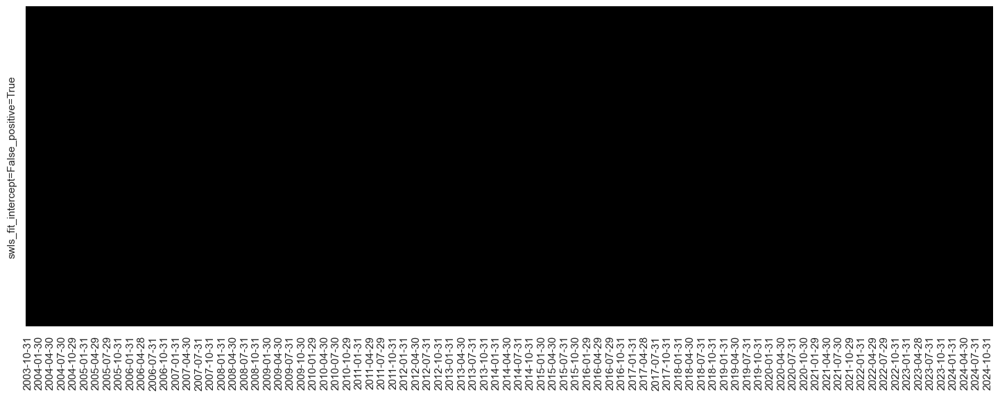

In [131]:
# Calculate predictions
so_eq.calculate_predictions(
    name = "EQ_SWLS",
    models = mods_eq_swls,
    hyperparameters = grid_eq_swls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_eq.get_optimized_signals(name="EQ_SWLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_eq.models_heatmap(name="EQ_SWLS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `EQ_SWLS` and `EQ_LS`.

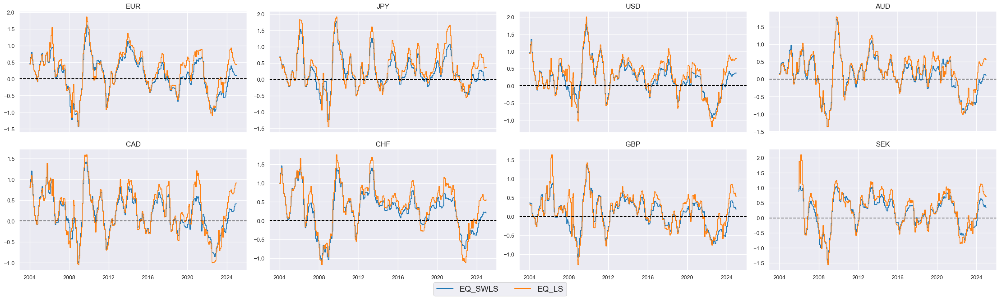

In [132]:
sigs_eq_swls = ["EQ_SWLS", "EQ_LS"]
xcatx = sigs_eq_swls

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_eq,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [133]:
## Compare optimized signals with simple average z-scores

srr_eq_swls = mss.SignalReturnRelations(
    df=dfx,
    rets=["EQXR_VT10"],
    sigs=sigs_eq_swls,
    cids=cids_eq,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
)

srr_eq_swls.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal  Frequency Aggregation                                     
EQXR_VT10 EQ_SWLS M         last            0.561         0.525     0.661   
          EQ_LS   M         last            0.567         0.522     0.703   

                                         pos_retr  pos_prec  neg_prec  \
Return    Signal  Frequency Aggregation                                 
EQXR_VT10 EQ_SWLS M         last            0.619     0.637     0.414   
          EQ_LS   M         last            0.619     0.632     0.412   

                                         pearson  pearson_pval  kendall  \
Return    Signal  Frequency Aggregation                                   
EQXR_VT10 EQ_SWLS M         last           0.071         0.002    0.045   
          EQ_LS   M         last           0.064         0.004    0.036   

                                         kendall_pval    auc  
Return    Signal  Frequency Aggregation                       
EQXR_VT10 EQ_SWLS M         last                0.003  0.524  
          EQ_LS   M         last                0.017  0.519

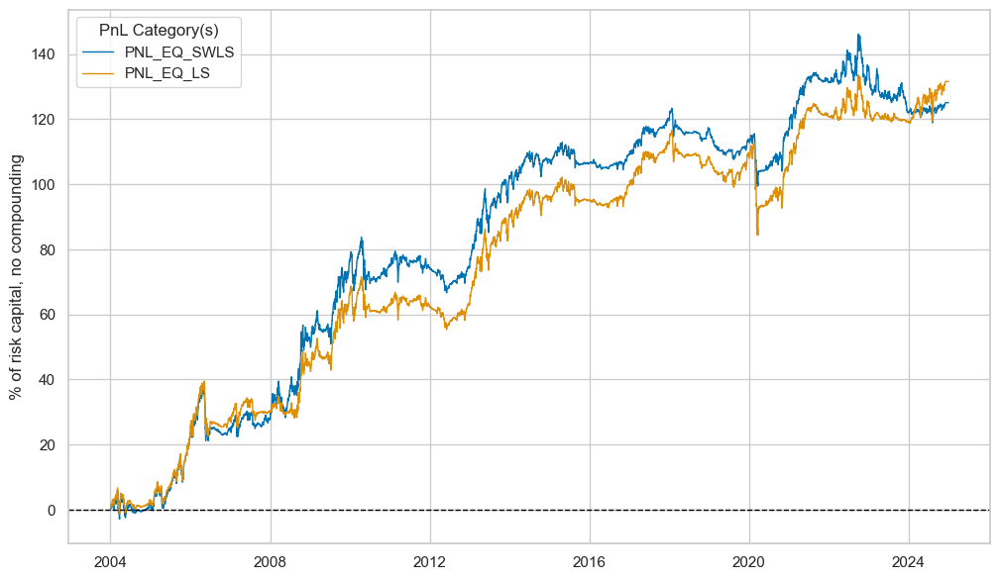

xcat,PNL_EQ_SWLS,PNL_EQ_LS
Return %,5.958858,6.269198
St. Dev. %,10.0,10.0
Sharpe Ratio,0.595886,0.62692
Sortino Ratio,0.832056,0.863988
Max 21-Day Draw %,-16.795398,-27.193386
Max 6-Month Draw %,-17.096398,-19.239694
Peak to Trough Draw %,-27.281278,-32.236223
Top 5% Monthly PnL Share,0.734351,0.670943
USD_EQXR_NSA correl,0.093087,0.184682
Traded Months,252,252


In [134]:
sigs = sigs_eq_swls

pnl_eq_swls = msn.NaivePnL(
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs,
    cids=cids_eq,
    start="2004-01-01",
    bms=["USD_EQXR_NSA"],
)

for sig in sigs:
    pnl_eq_swls.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_eq_swls.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_eq_swls.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [135]:
results_eq_swls = msn.create_results_dataframe(
    title="Performance metrics, LS vs SWLS, equity",
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs_eq_swls,
    cids=cids_eq,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"EQ_LS": "LS", "EQ_SWLS": "SWLS"},
    slip=1,
)
results_eq_swls

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LS,0.567,0.522,0.064,0.036,0.627,0.864,0.185
SWLS,0.561,0.525,0.071,0.045,0.596,0.832,0.093


#### FX

In [136]:
mods_fx_swls = {
    "swls": msl.SignWeightedLinearRegression(),
}

grid_fx_swls = {
    "swls": {
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
}

As previously, the `SignalOptimizer` class allows for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_fx`, and the targets in `y_fx`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `FX_SWLS`

  0%|          | 0/251 [00:00<?, ?it/s]

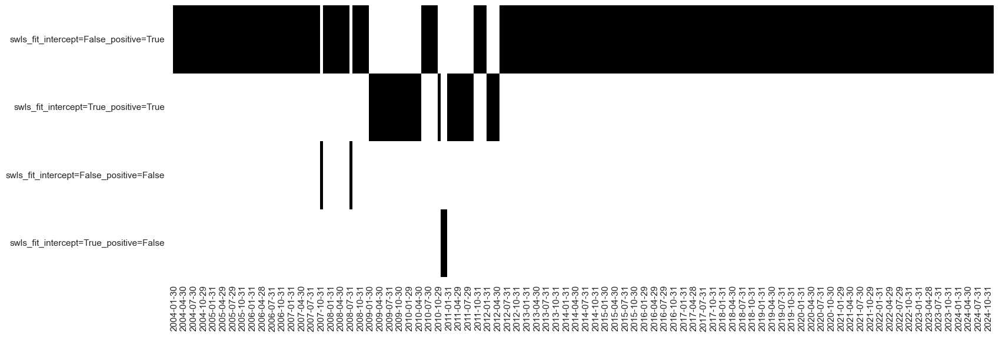

In [137]:
# Calculate predictions
so_fx.calculate_predictions(
    name = "FX_SWLS",
    models = mods_fx_swls,
    hyperparameters = grid_fx_swls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_fx.get_optimized_signals(name="FX_SWLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_fx.models_heatmap(name="FX_SWLS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `FX_SWLS` and `FX_LS`.

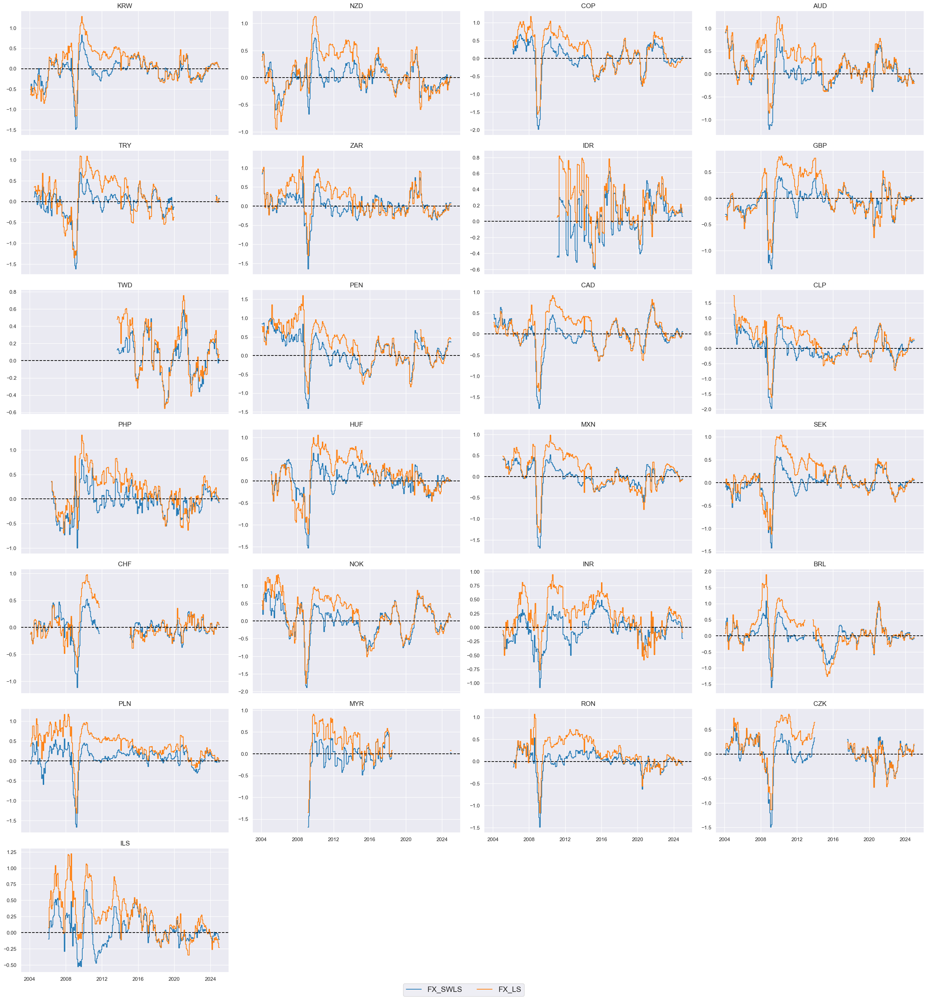

In [138]:
sigs_fx_swls = ["FX_SWLS", "FX_LS"]
xcatx = sigs_fx_swls

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_fx,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [139]:
## Compare optimized signals with simple average z-scores

srr_fx_swls = mss.SignalReturnRelations(
    df=dfx,
    rets=["FXXR_VT10"],
    sigs=sigs_fx_swls,
    cids=cids_fx,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
    blacklist=fxblack,
)

srr_fx_swls.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal  Frequency Aggregation                                     
FXXR_VT10 FX_SWLS M         last            0.504         0.502     0.535   
          FX_LS   M         last            0.523         0.514     0.663   

                                         pos_retr  pos_prec  neg_prec  \
Return    Signal  Frequency Aggregation                                 
FXXR_VT10 FX_SWLS M         last            0.534     0.536     0.468   
          FX_LS   M         last            0.534     0.543     0.484   

                                         pearson  pearson_pval  kendall  \
Return    Signal  Frequency Aggregation                                   
FXXR_VT10 FX_SWLS M         last           0.012         0.367    0.013   
          FX_LS   M         last           0.022         0.104    0.024   

                                         kendall_pval    auc  
Return    Signal  Frequency Aggregation                       
FXXR_VT10 FX_SWLS M         last                0.144  0.502  
          FX_LS   M         last                0.007  0.512

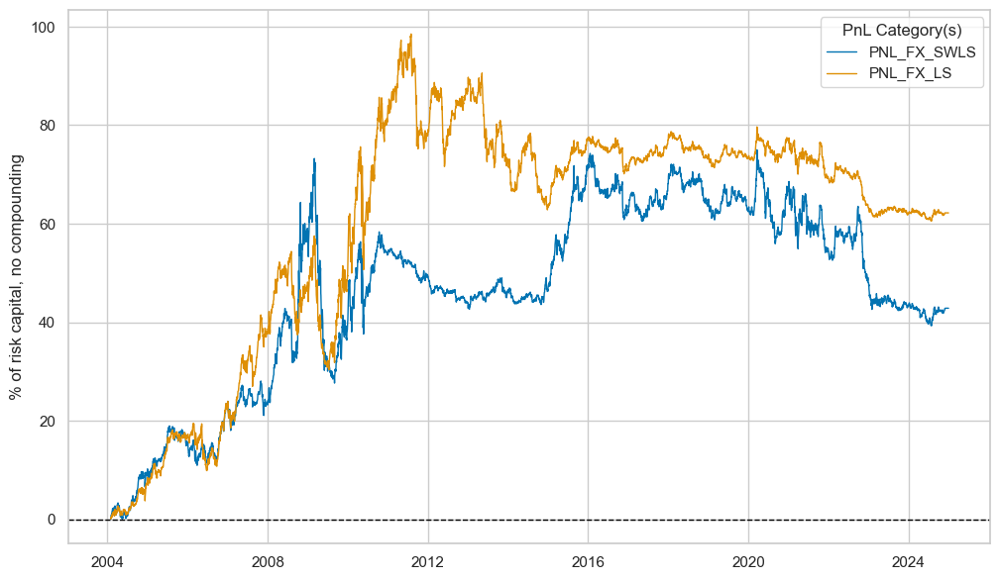

xcat,PNL_FX_SWLS,PNL_FX_LS
Return %,2.048657,2.973921
St. Dev. %,10.0,10.0
Sharpe Ratio,0.204866,0.297392
Sortino Ratio,0.287758,0.408613
Max 21-Day Draw %,-21.427131,-24.941009
Max 6-Month Draw %,-44.205378,-23.668059
Peak to Trough Draw %,-45.591345,-37.957949
Top 5% Monthly PnL Share,1.947804,1.501754
USD_EQXR_NSA correl,-0.123544,0.100501
Traded Months,252,252


In [140]:
sigs = sigs_fx_swls

pnl_fx_swls = msn.NaivePnL(
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs,
    cids=cids_fx,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_EQXR_NSA"],
)
for sig in sigs:
    pnl_fx_swls.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )
pnl_fx_swls.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_fx_swls.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [141]:
results_fx_swls = msn.create_results_dataframe(
    title="Performance metrics, LS vs SWLS, FX",
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs_fx_swls,
    cids=cids_fx,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"FX_LS": "LS", "FX_SWLS": "SWLS"},
    slip=1,
    blacklist=fxblack,
)
results_fx_swls

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LS,0.523,0.514,0.022,0.024,0.297,0.409,0.101
SWLS,0.504,0.502,0.012,0.013,0.205,0.288,-0.124


#### Comparison

On average across the strategies of the analysis, statistical learning with sign-weighted least squares produces slightly higher correlation and PnL performance ratios than least squares. Importantly, the average benchmark correlation of strategies has been very low (around 5%) versus 25% for the least squares-based signal.

The main empirical lessons reflect the purpose of SWLS:

* SWLS-based learning reduces directional bias. Since the method weighs positive and negative return experiences equally, all directional bias arises from seasonality of returns (equity market boom) or the omittion of a variable such as a long-term premium. This is echoed by the removal of the long bias across all our sample strategies. Such a complete removal is desirable if the experiences of (rarer) negative return periods are truly more valuable as positive return periods.
* SWLS likes to work with non-negativity restrictions: In our examples, SWLS learning would have always chosen models with non-negative coefficient restrictions. This may be a sign of suitability for the implementation of theoretical priors across different asset return seasons.

In [142]:
results_swls = (results_du_swls.data + results_eq_swls.data + results_fx_swls.data) / 3
results_swls.style.format("{:.3f}").set_caption(
    "Averaged performance metrics, LS vs SWLS"
).set_table_styles(
    [
        {
            "selector": "caption",
            "props": [("text-align", "center"), ("font-weight", "bold")],
        }
    ]
)

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LS,0.541,0.517,0.045,0.029,0.456,0.628,0.252
SWLS,0.532,0.516,0.045,0.031,0.462,0.646,0.070


### Least absolute deviations

LAD regression is median regression, i.e., special case of quantile regression. It is a robust regression method that is less sensitive to outliers than standard least squares regression. Least squares can compromise the message of the many for the sake a few, specifically extreme values. LAD mitigates this issue by using absolute values of errors, rather than their squares.

#### Duration

In [143]:
# All WLAD regressors (Weighted LAD)
mods_du_wlad = {
    "lad": msl.LADRegressor(),
    "swlad": msl.SignWeightedLADRegressor(),
    "twlad": msl.TimeWeightedLADRegressor(),
}

grid_du_wlad = {
    "lad": {
        "positive": [True, False],
        "fit_intercept": [True, False],
    },
    "swlad": {
        "positive": [True, False],
        "fit_intercept": [True, False],
    },
    "twlad": {
        "positive": [True, False],
        "fit_intercept": [True, False],
        "half_life": [
            12 * 1,
            12 * 3,
            12 * 5,
            12 * 10,
            12 * 20,
        ],
    },
}

# All WLS regressors (Weighted LS)
mods_du_wls = {
    "ols": LinearRegression(),
    "swls": msl.SignWeightedLinearRegression(),
    "twls": msl.TimeWeightedLinearRegression(),
}

grid_du_wls = {
    "ols": {
        "positive": [True, False],
        "fit_intercept": [True, False],
    },
    "swls": {
        "positive": [True, False],
        "fit_intercept": [True, False],
    },
    "twls": {
        "positive": [True, False],
        "fit_intercept": [True, False],
        "half_life": [
            12 * 1,
            12 * 3,
            12 * 5,
            12 * 10,
            12 * 20,
        ],
    },
}

As previously, the `SignalOptimizer` class allows for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_du`, and the targets in `y_du`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `DU_WLAD`.

  0%|          | 0/250 [00:00<?, ?it/s]

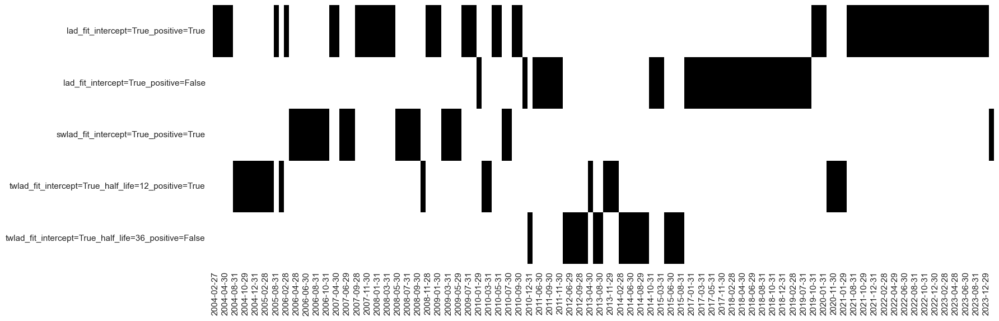

  0%|          | 0/250 [00:00<?, ?it/s]

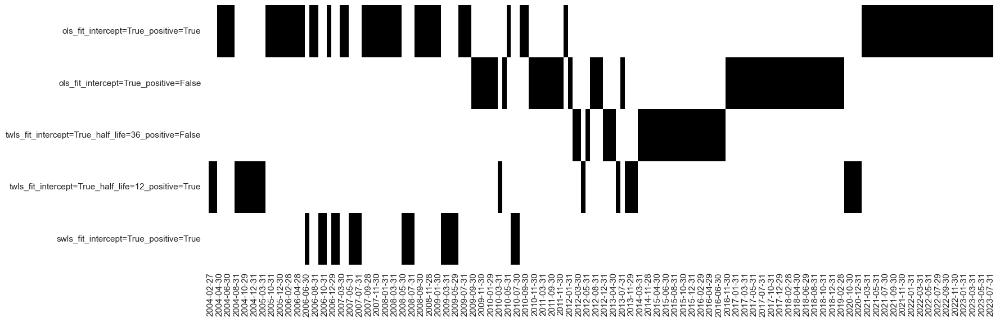

In [144]:
# Calculate predictions
so_du.calculate_predictions(
    name = "DU_WLAD",
    models = mods_du_wlad,
    hyperparameters = grid_du_wlad,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_du.get_optimized_signals(name="DU_WLAD")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_du.models_heatmap(name="DU_WLAD", figsize=(18, 6))

# Calculate WLS predictions
so_du.calculate_predictions(
    name = "DU_WLS",
    models = mods_du_wls,
    hyperparameters = grid_du_wls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_du.get_optimized_signals(name="DU_WLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_du.models_heatmap(name="DU_WLS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `DU_WLAD` and `DU_WLS`.

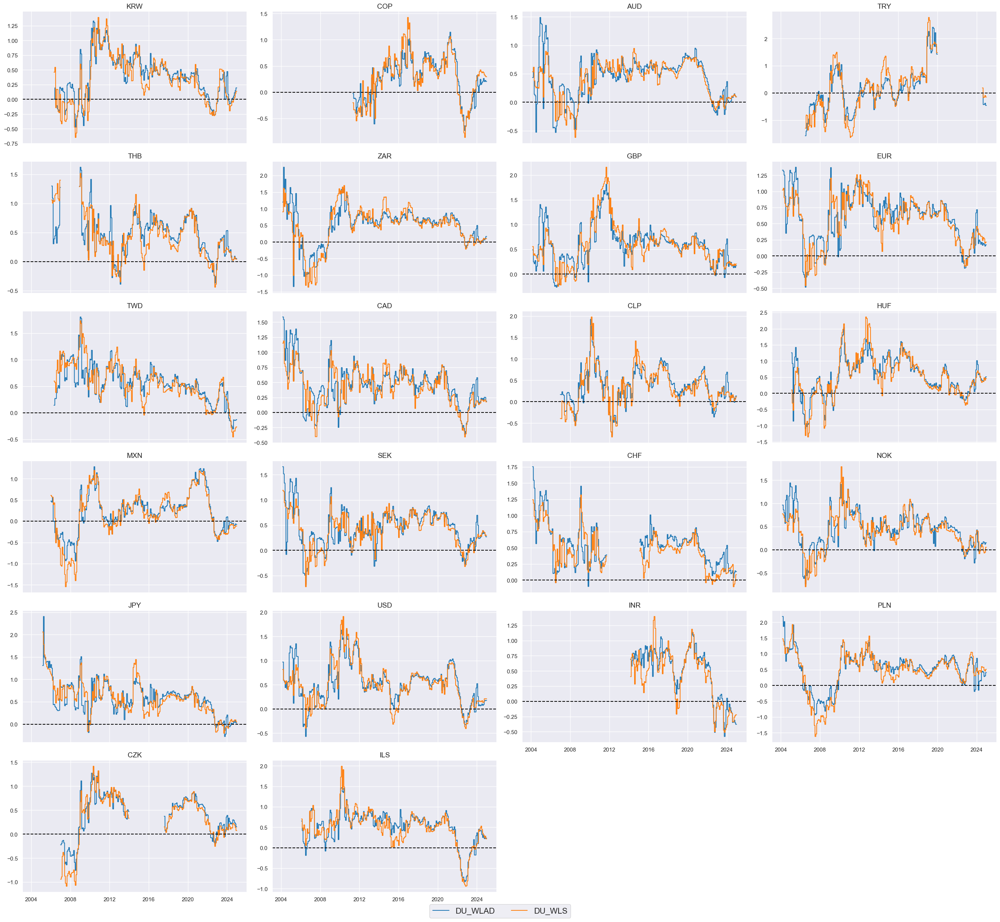

In [145]:
sigs_du_lad = ["DU_WLAD", "DU_WLS"]
xcatx = sigs_du_lad

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_dux,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [146]:
## Compare optimized signals with simple average z-scores

srr_du_lad = mss.SignalReturnRelations(
    df=dfx,
    rets=["DU05YXR_VT10"],
    sigs=sigs_du_lad,
    cids=cids_dux,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
    blacklist=fxblack,
)

srr_du_lad.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return       Signal  Frequency Aggregation                                     
DU05YXR_VT10 DU_WLAD M         last            0.529         0.505     0.864   
             DU_WLS  M         last            0.533         0.514     0.849   

                                            pos_retr  pos_prec  neg_prec  \
Return       Signal  Frequency Aggregation                                 
DU05YXR_VT10 DU_WLAD M         last            0.537     0.538     0.471   
             DU_WLS  M         last            0.537     0.541     0.486   

                                            pearson  pearson_pval  kendall  \
Return       Signal  Frequency Aggregation                                   
DU05YXR_VT10 DU_WLAD M         last           0.040         0.005    0.023   
             DU_WLS  M         last           0.049         0.001    0.028   

                                            kendall_pval    auc  
Return       Signal  Frequency Aggregation                       
DU05YXR_VT10 DU_WLAD M         last                0.015  0.502  
             DU_WLS  M         last                0.003  0.507

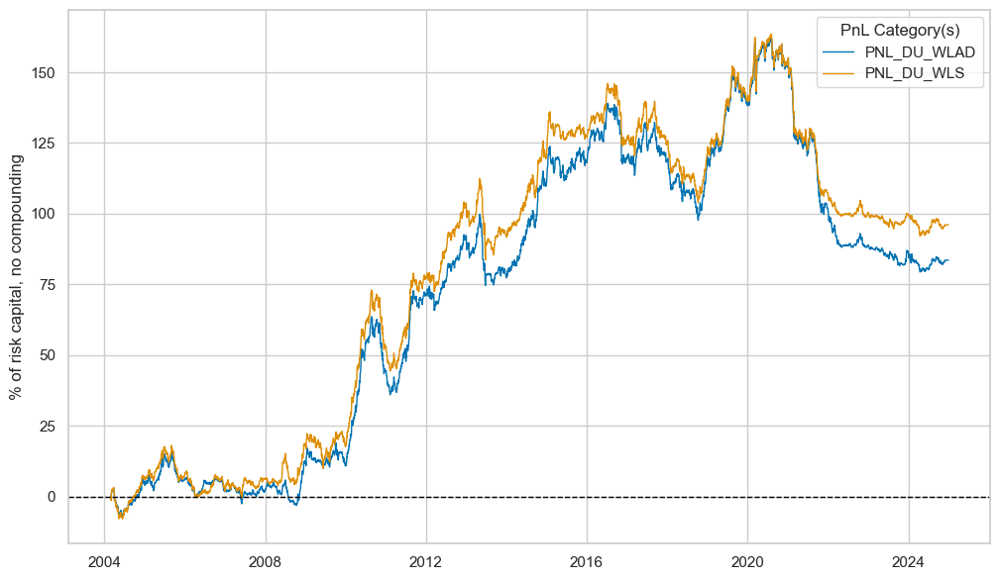

xcat,PNL_DU_WLAD,PNL_DU_WLS
Return %,4.009175,4.608442
St. Dev. %,10.0,10.0
Sharpe Ratio,0.400918,0.460844
Sortino Ratio,0.556773,0.638849
Max 21-Day Draw %,-23.568397,-22.694559
Max 6-Month Draw %,-34.536724,-33.01866
Peak to Trough Draw %,-82.762684,-71.487573
Top 5% Monthly PnL Share,1.510919,1.342382
USD_GB10YXR_NSA correl,0.470454,0.464506
Traded Months,251,251


In [147]:
sigs = sigs_du_lad

pnl_du_lad = msn.NaivePnL(
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs,
    cids=cids_dux,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_GB10YXR_NSA"],
)
for sig in sigs:
    pnl_du_lad.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_du_lad.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_du_lad.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [148]:
results_du_lad = msn.create_results_dataframe(
    title="Performance metrics, LAD vs LS, duration",
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs_du_lad,
    cids=cids_dux,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"DU_WLS": "LS", "DU_WLAD": "LAD"},
    slip=1,
    blacklist=fxblack,
)
results_du_lad

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LAD,0.529,0.505,0.040,0.023,0.401,0.557,-0.124
LS,0.533,0.514,0.049,0.028,0.461,0.639,-0.125


#### Equity

In [149]:
# All WLAD regressors (Weighted LAD)
mods_eq_wlad = {
    "lad": msl.LADRegressor(),
    "swlad": msl.SignWeightedLADRegressor(),
    "twlad": msl.TimeWeightedLADRegressor(),
}

grid_eq_wlad = {
    "lad": {
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
    "swlad": {
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
    "twlad": {
        "fit_intercept": [True, False],
        "positive": [True, False],
        "half_life": [
            12 * 1,
            12 * 3,
            12 * 5,
            12 * 10,
            12 * 20,
        ],
    },
}

# All WLS regressors (Weighted LS)
mods_eq_wls = {
    "ols": LinearRegression(),
    "swls": msl.SignWeightedLinearRegression(),
    "twls": msl.TimeWeightedLinearRegression(),
}

grid_eq_wls = {
    "ols": {
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
    "swls": {
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
    "twls": {
        "fit_intercept": [True, False],
        "positive": [True, False],
        "half_life": [
            12 * 1,
            12 * 3,
            12 * 5,
            12 * 10,
            12 * 20,
        ],
    },
}

As previously, the `SignalOptimizer` class allows for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_eq`, and the targets in `y_eq`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `EQ_WLAD`.

  0%|          | 0/254 [00:00<?, ?it/s]

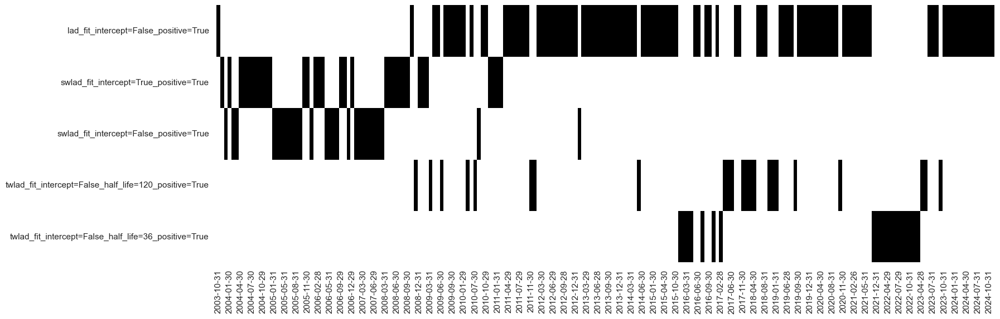

  0%|          | 0/254 [00:00<?, ?it/s]

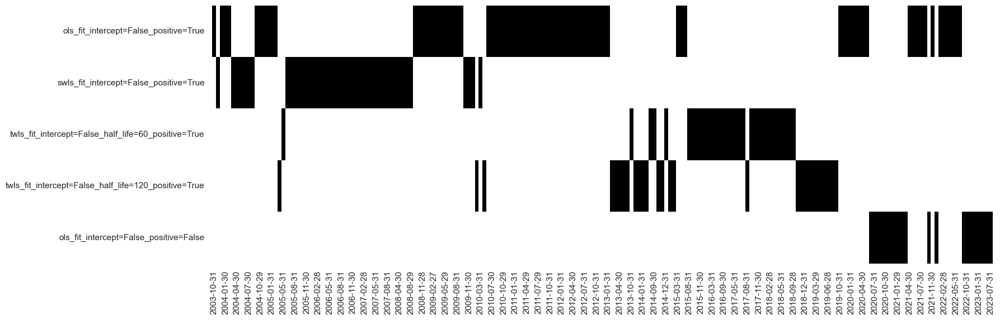

In [150]:
# Calculate predictions
so_eq.calculate_predictions(
    name = "EQ_WLAD",
    models = mods_eq_wlad,
    hyperparameters = grid_eq_wlad,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_eq.get_optimized_signals(name="EQ_WLAD")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_eq.models_heatmap(name="EQ_WLAD", figsize=(18, 6))

# Calculate WLS predictions
so_eq.calculate_predictions(
    name = "EQ_WLS",
    models = mods_eq_wls,
    hyperparameters = grid_eq_wls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_eq.get_optimized_signals(name="EQ_WLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_eq.models_heatmap(name="EQ_WLS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) function from the `macrosynergy` package displays both signals `EQ_WLAD` and `EQ_WLS`.

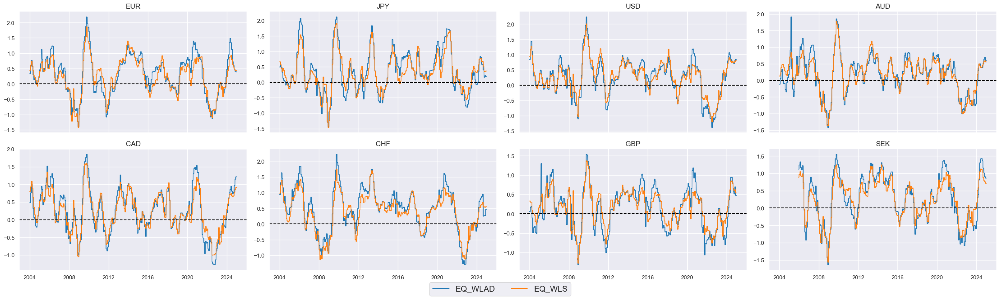

In [151]:
sigs_eq_lad = ["EQ_WLAD", "EQ_WLS"]
xcatx = sigs_eq_lad

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_eq,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [152]:
## Compare optimized signals with simple average z-scores

srr_eq_lad = mss.SignalReturnRelations(
    df=dfx,
    rets=["EQXR_VT10"],
    sigs=sigs_eq_lad,
    cids=cids_eq,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
)

srr_eq_lad.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal  Frequency Aggregation                                     
EQXR_VT10 EQ_WLAD M         last            0.576         0.538     0.683   
          EQ_WLS  M         last            0.567         0.523     0.700   

                                         pos_retr  pos_prec  neg_prec  \
Return    Signal  Frequency Aggregation                                 
EQXR_VT10 EQ_WLAD M         last            0.619     0.643     0.432   
          EQ_WLS  M         last            0.619     0.633     0.413   

                                         pearson  pearson_pval  kendall  \
Return    Signal  Frequency Aggregation                                   
EQXR_VT10 EQ_WLAD M         last           0.064         0.004    0.041   
          EQ_WLS  M         last           0.062         0.006    0.035   

                                         kendall_pval    auc  
Return    Signal  Frequency Aggregation                       
EQXR_VT10 EQ_WLAD M         last                0.007  0.535  
          EQ_WLS  M         last                0.021  0.521

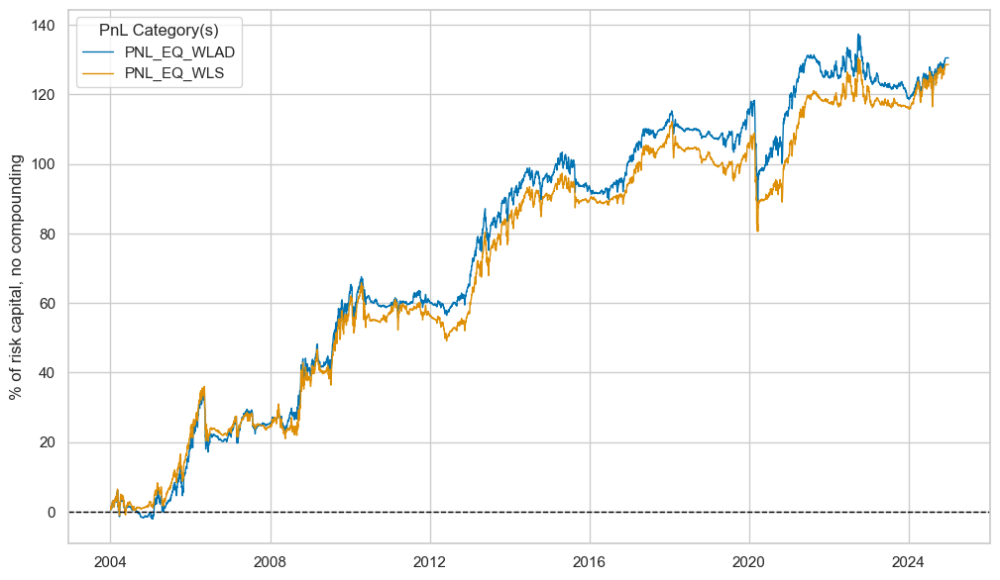

xcat,PNL_EQ_WLAD,PNL_EQ_WLS
Return %,6.219131,6.127215
St. Dev. %,10.0,10.0
Sharpe Ratio,0.621913,0.612722
Sortino Ratio,0.854571,0.843367
Max 21-Day Draw %,-29.95326,-27.288357
Max 6-Month Draw %,-20.903593,-19.155225
Peak to Trough Draw %,-30.873087,-31.567187
Top 5% Monthly PnL Share,0.677361,0.671665
USD_EQXR_NSA correl,0.190732,0.17673
Traded Months,252,252


In [153]:
sigs = sigs_eq_lad

pnl_eq_lad = msn.NaivePnL(
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs,
    cids=cids_eq,
    start="2004-01-01",
    bms=["USD_EQXR_NSA"],
)
for sig in sigs:
    pnl_eq_lad.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_eq_lad.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_eq_lad.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [154]:
results_eq_lad = msn.create_results_dataframe(
    title="Performance metrics, LAD vs LS, equity",
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs_eq_lad,
    cids=cids_eq,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"EQ_WLS": "LS", "EQ_WLAD": "LAD"},
    slip=1,
)
results_eq_lad

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LAD,0.576,0.538,0.064,0.041,0.622,0.855,0.191
LS,0.567,0.523,0.062,0.035,0.613,0.843,0.177


#### FX

In [155]:
# All WLAD regressors
mods_fx_wlad = {
    "lad": msl.LADRegressor(),
    "swlad": msl.SignWeightedLADRegressor(),
    "twlad": msl.TimeWeightedLADRegressor(),
}

grid_fx_wlad = {
    "lad": {
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
    "swlad": {
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
    "twlad": {
        "fit_intercept": [True, False],
        "positive": [True, False],
        "half_life": [
            12 * 0.5,
            12 * 1,
            12 * 3,
            12 * 5,
            12 * 10,
            12 * 20,
        ],
    },
}

# All WLS regressors (Weighted LS)
mods_fx_wls = {
    "ols": LinearRegression(),
    "swls": msl.SignWeightedLinearRegression(),
    "twls": msl.TimeWeightedLinearRegression(),
}

grid_fx_wls = {
    "ols": {
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
    "swls": {
        "fit_intercept": [True, False],
        "positive": [True, False],
    },
    "twls": {
        "fit_intercept": [True, False],
        "positive": [True, False],
        "half_life": [
            12 * 0.5,
            12 * 1,
            12 * 3,
            12 * 5,
            12 * 10,
            12 * 20,
        ],
    },
}

As previously, the `SignalOptimizer` class allows for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_fx`, and the targets in `y_fx`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `FX_WLAD`.

  0%|          | 0/251 [00:00<?, ?it/s]

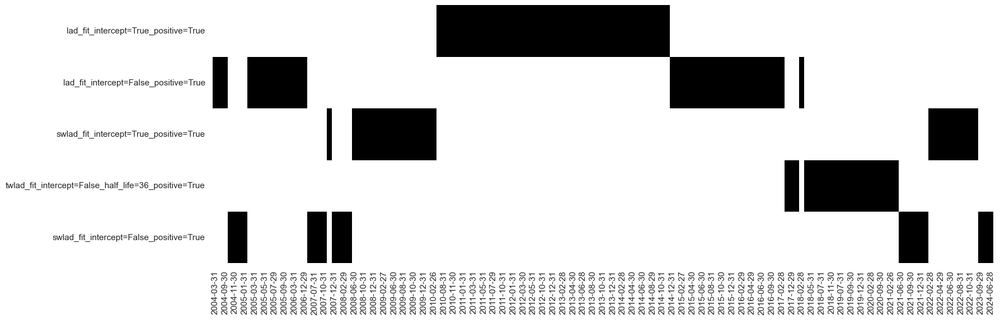

  0%|          | 0/251 [00:00<?, ?it/s]

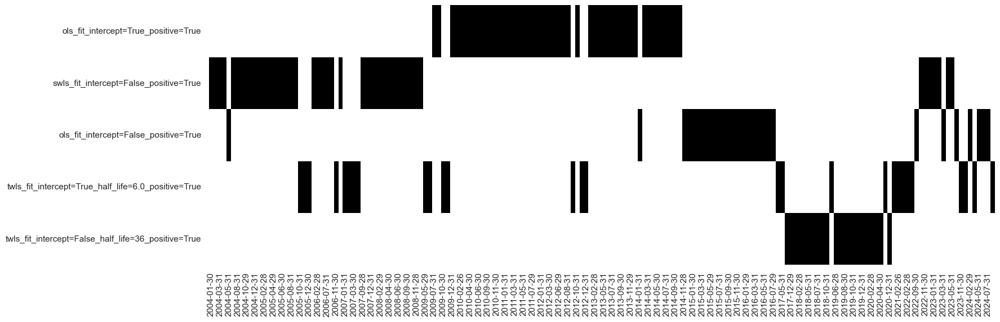

In [156]:
# Calculate predictions
so_fx.calculate_predictions(
    name = "FX_WLAD",
    models = mods_fx_wlad,
    hyperparameters = grid_fx_wlad,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_fx.get_optimized_signals(name="FX_WLAD")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_fx.models_heatmap(name="FX_WLAD", figsize=(18, 6))

# Calculate WLS predictions
so_fx.calculate_predictions(
    name = "FX_WLS",
    models = mods_fx_wls,
    hyperparameters = grid_fx_wls,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_fx.get_optimized_signals(name="FX_WLS")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_fx.models_heatmap(name="FX_WLS", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `FX_WLAD` and `FX_WLS`.

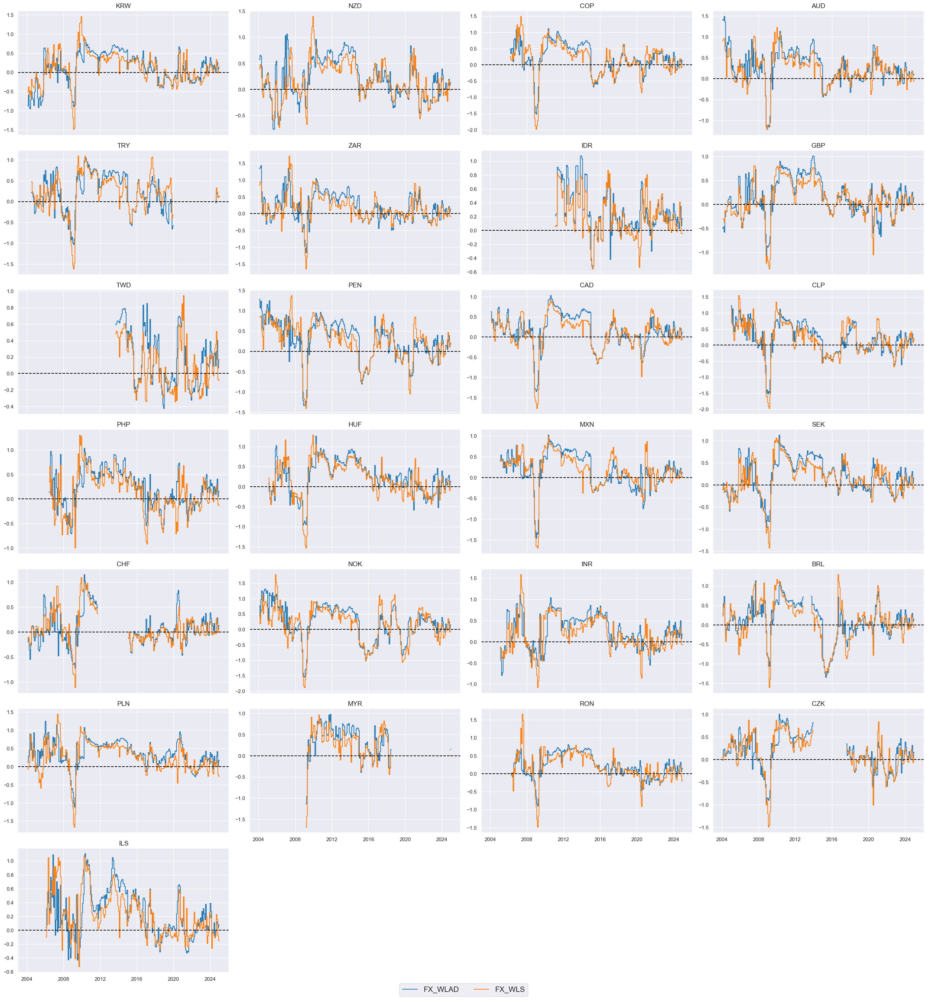

In [157]:
sigs_fx_lad = ["FX_WLAD", "FX_WLS"]
xcatx = sigs_fx_lad

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_fx,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [158]:
## Compare optimized signals with simple average z-scores

srr_fx_lad = mss.SignalReturnRelations(
    df=dfx,
    rets=["FXXR_VT10"],
    sigs=sigs_fx_lad,
    cids=cids_fx,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
    blacklist=fxblack,
)

srr_fx_lad.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal  Frequency Aggregation                                     
FXXR_VT10 FX_WLAD M         last            0.533         0.522     0.708   
          FX_WLS  M         last            0.516         0.506     0.669   

                                         pos_retr  pos_prec  neg_prec  \
Return    Signal  Frequency Aggregation                                 
FXXR_VT10 FX_WLAD M         last            0.534     0.547     0.498   
          FX_WLS  M         last            0.534     0.538     0.474   

                                         pearson  pearson_pval  kendall  \
Return    Signal  Frequency Aggregation                                   
FXXR_VT10 FX_WLAD M         last           0.020         0.126    0.024   
          FX_WLS  M         last           0.025         0.059    0.023   

                                         kendall_pval    auc  
Return    Signal  Frequency Aggregation                       
FXXR_VT10 FX_WLAD M         last                0.008  0.519  
          FX_WLS  M         last                0.008  0.505

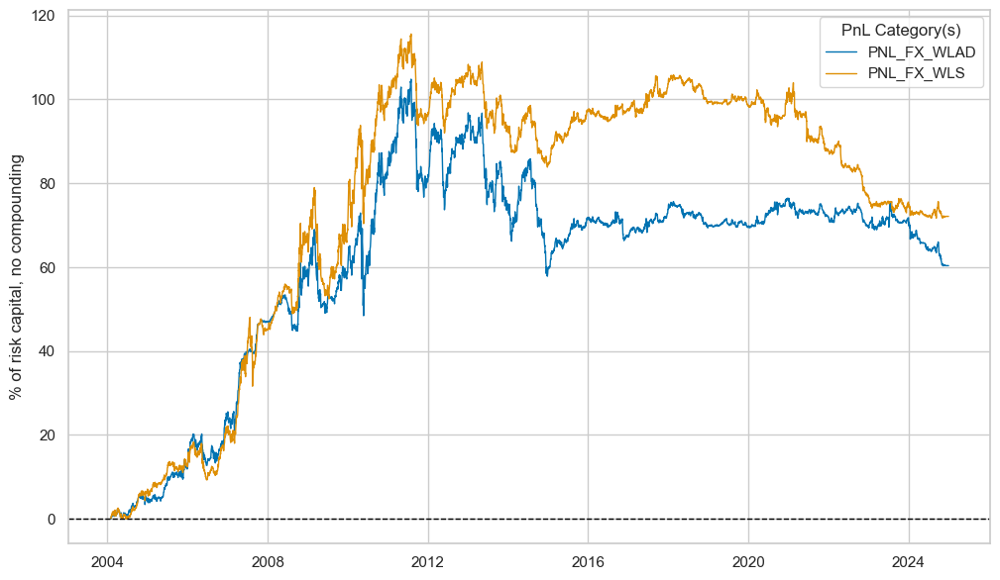

xcat,PNL_FX_WLAD,PNL_FX_WLS
Return %,2.886343,3.448236
St. Dev. %,10.0,10.0
Sharpe Ratio,0.288634,0.344824
Sortino Ratio,0.394823,0.475964
Max 21-Day Draw %,-24.49014,-23.438638
Max 6-Month Draw %,-27.067639,-20.767178
Peak to Trough Draw %,-46.981679,-43.932454
Top 5% Monthly PnL Share,1.688453,1.296978
USD_EQXR_NSA correl,0.095837,0.063389
Traded Months,252,252


In [159]:
sigs = sigs_fx_lad

pnl_fx_lad = msn.NaivePnL(
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs,
    cids=cids_fx,
    start="2004-01-01",
    bms=["USD_EQXR_NSA"],
    blacklist=fxblack,
)
for sig in sigs:
    pnl_fx_lad.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_fx_lad.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_fx_lad.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [160]:
results_fx_lad = msn.create_results_dataframe(
    title="Performance metrics, LAD vs LS, FX",
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs_fx_lad,
    cids=cids_fx,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"FX_WLS": "LS", "FX_WLAD": "LAD"},
    slip=1,
    blacklist=fxblack,
)
results_fx_lad

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LAD,0.533,0.522,0.020,0.024,0.289,0.395,0.096
LS,0.516,0.506,0.025,0.023,0.345,0.476,0.063


#### Comparison

LAD regression does not generally improve signal quality. Average accuracy and balanced accuracy for our strategy types have been higher than for least squares, but correlation and portfolio performance ratios have been smaller.

Two important empirical lessons:

* LAD is not generally a game changer for macro signals: Even though economic data and financial returns are prone to outliers these are often not large enough to bring out the full benefits of the LAD approach. This may reflect that with the low average explanatory power of features with respect to future financial returns, regressions rarely produce large coefficients in the first place and the main job of the regression is really selecting features and weighing them relative to each other. 
* LAD also likes to work with non-negativity restrictions: For all strategies the most frequently chosen LAD and LS versions use the non-negative coefficient restrictions. This is a reminder of the benefits of theoretical priors, at least in respect to direction of feature impact.

In [161]:
results_lad = (results_du_lad.data + results_eq_lad.data + results_fx_lad.data) / 3
results_lad.style.format("{:.3f}").set_caption(
    "Averaged performance metrics, LAD vs LS"
).set_table_styles(
    [
        {
            "selector": "caption",
            "props": [("text-align", "center"), ("font-weight", "bold")],
        }
    ]
)

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
LAD,0.546,0.522,0.041,0.029,0.437,0.602,0.054
LS,0.539,0.514,0.045,0.029,0.473,0.653,0.038


### KNN

All above models are linear and parametric. The KNN class of models makes predictions by averaging the nearest $k$ training samples, possibly taking a weighted average based on sample distance. In this context, this leads to return prediction based on the most similar feature constellations of the past. In the concept of macro signals, this reduces theoretical priors (and probably enhances model variance) for the sake of less model bias.

#### Duration

In [162]:
mods_du_knn = {
    "knn": KNeighborsRegressor(),
}

grid_du_knn = {
    "knn": {
        "n_neighbors": [i for i in range(1, 105, 5)],
        "weights": ["uniform", "distance"],
    },
}

As previously, the `SignalOptimizer` class allows for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_du`, and the targets in `y_du`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `DU_KNN`.

  0%|          | 0/250 [00:00<?, ?it/s]

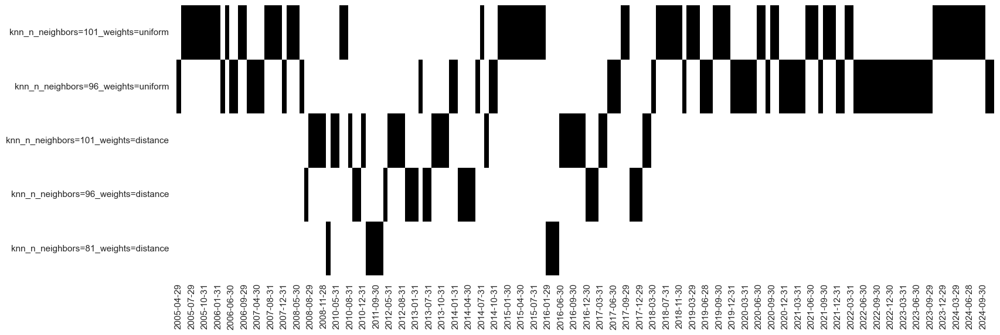

In [163]:
# Calculate predictions
so_du.calculate_predictions(
    name = "DU_KNN",
    models = mods_du_knn,
    hyperparameters = grid_du_knn,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_du.get_optimized_signals(name="DU_KNN")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_du.models_heatmap(name="DU_KNN", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `DU_KNN` and `DU_LS`.

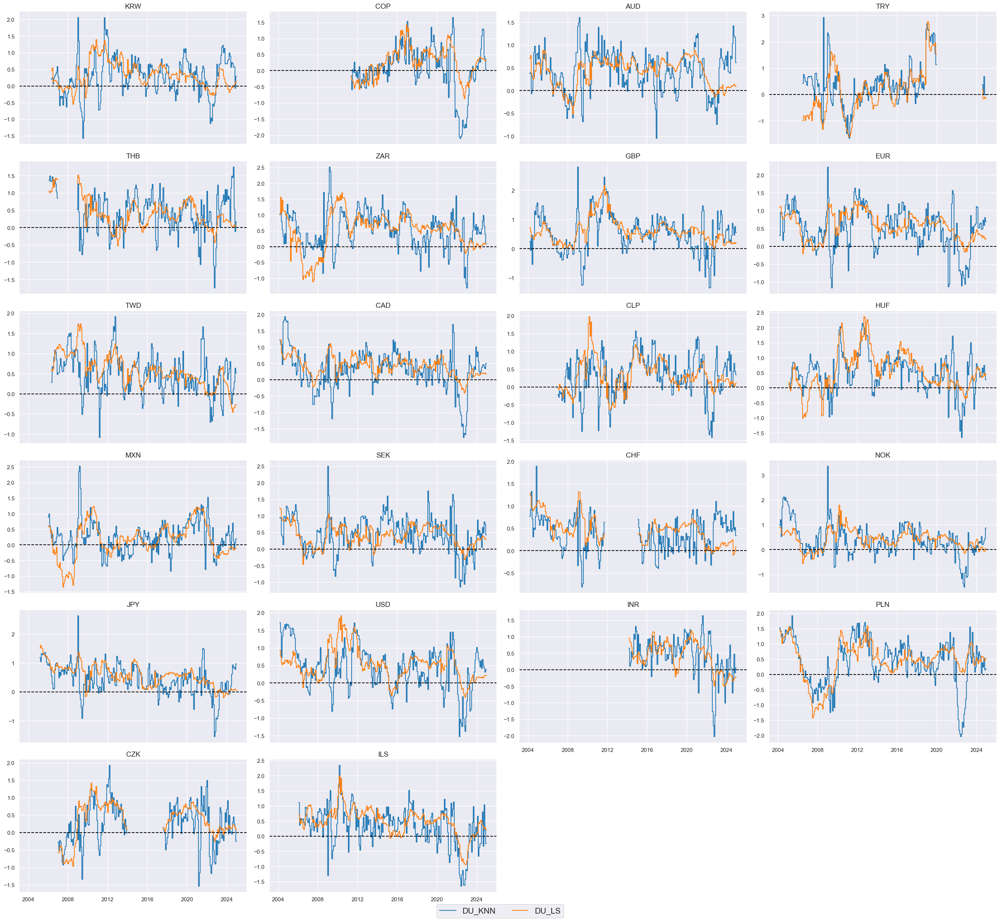

In [164]:
sigs_du_knn = ["DU_KNN", "DU_LS"]
xcatx = sigs_du_knn

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_dux,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [165]:
## Compare optimized signals with simple average z-scores
sigs = sigs_du_knn

srr_du_knn = mss.SignalReturnRelations(
    df=dfx,
    rets=["DU05YXR_VT10"],
    sigs=sigs,
    cids=cids_dux,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
    blacklist=fxblack,
)

srr_du_knn.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return       Signal Frequency Aggregation                                     
DU05YXR_VT10 DU_KNN M         last            0.530         0.514     0.778   
             DU_LS  M         last            0.533         0.514     0.849   

                                           pos_retr  pos_prec  neg_prec  \
Return       Signal Frequency Aggregation                                 
DU05YXR_VT10 DU_KNN M         last            0.537     0.543     0.485   
             DU_LS  M         last            0.537     0.541     0.488   

                                           pearson  pearson_pval  kendall  \
Return       Signal Frequency Aggregation                                   
DU05YXR_VT10 DU_KNN M         last           0.034         0.019    0.017   
             DU_LS  M         last           0.048         0.001    0.028   

                                           kendall_pval    auc  
Return       Signal Frequency Aggregation                       
DU05YXR_VT10 DU_KNN M         last                0.079  0.510  
             DU_LS  M         last                0.003  0.507

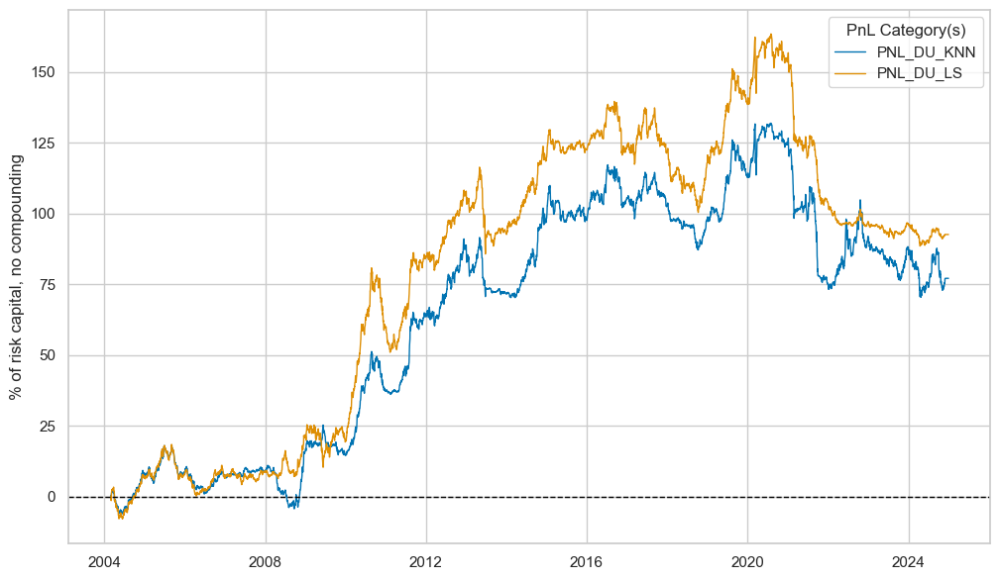

xcat,PNL_DU_KNN,PNL_DU_LS
Return %,3.699091,4.442978
St. Dev. %,10.0,10.0
Sharpe Ratio,0.369909,0.444298
Sortino Ratio,0.510598,0.611872
Max 21-Day Draw %,-25.977495,-26.619051
Max 6-Month Draw %,-35.508238,-36.608636
Peak to Trough Draw %,-61.564275,-74.963419
Top 5% Monthly PnL Share,1.579329,1.341364
USD_GB10YXR_NSA correl,0.338984,0.469051
Traded Months,251,251


In [166]:
pnl_du_knn = msn.NaivePnL(
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs,
    cids=cids_dux,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_GB10YXR_NSA"],
)
for sig in sigs:
    pnl_du_knn.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_du_knn.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_du_knn.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [167]:
results_du_knn = msn.create_results_dataframe(
    title="Performance metrics, KNN vs LS, duration",
    df=dfx,
    ret="DU05YXR_VT10",
    sigs=sigs_du_knn,
    cids=cids_dux,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_GB10YXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"DU_LS": "LS", "DU_KNN": "KNN"},
    slip=1,
    blacklist=fxblack,
)
results_du_knn

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
KNN,0.530,0.514,0.034,0.017,0.370,0.511,0.339
LS,0.533,0.514,0.048,0.028,0.444,0.612,0.469


#### Equity

In [168]:
mods_eq_knn = {
    "knn": KNeighborsRegressor(),
}

grid_eq_knn = {
    "knn": {
        "n_neighbors": [i for i in range(1, 101, 5)],
        "weights": ["uniform", "distance"],
    },
}

As previously, the `SignalOptimizer` class allows for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_eq`, and the targets in `y_eq`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `EQ_KNN`.

  0%|          | 0/254 [00:00<?, ?it/s]

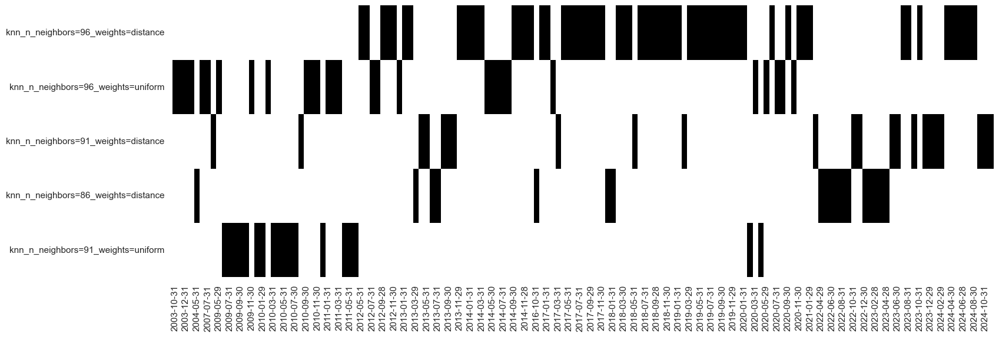

In [169]:
# Calculate predictions
so_eq.calculate_predictions(
    name = "EQ_KNN",
    models = mods_eq_knn,
    hyperparameters = grid_eq_knn,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_eq.get_optimized_signals(name="EQ_KNN")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_eq.models_heatmap(name="EQ_KNN", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `EQ_KNN` and `EQ_LS`.

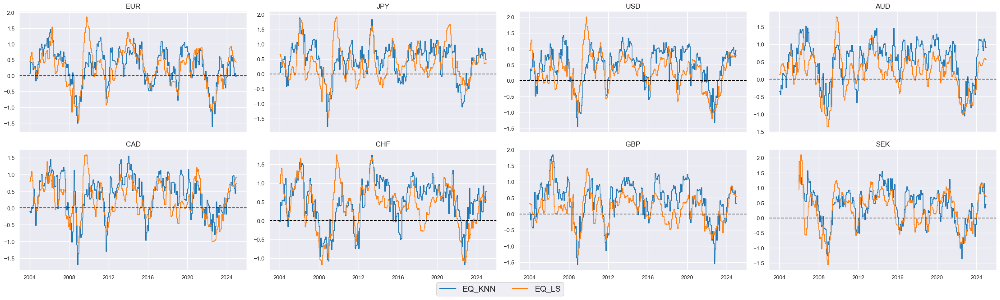

In [170]:
sigs_eq_knn = ["EQ_KNN", "EQ_LS"]
xcatx = sigs_eq_knn

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_eq,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [171]:
## Compare optimized signals with simple average z-scores
sigs = sigs_eq_knn

srr_eq_knn = mss.SignalReturnRelations(
    df=dfx,
    rets=["EQXR_VT10"],
    sigs=sigs,
    cids=cids_eq,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
)

srr_eq_knn.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal Frequency Aggregation                                     
EQXR_VT10 EQ_KNN M         last            0.583         0.520     0.791   
          EQ_LS  M         last            0.567         0.522     0.703   

                                        pos_retr  pos_prec  neg_prec  pearson  \
Return    Signal Frequency Aggregation                                          
EQXR_VT10 EQ_KNN M         last            0.619     0.628     0.413    0.019   
          EQ_LS  M         last            0.619     0.632     0.412    0.064   

                                        pearson_pval  kendall  kendall_pval  \
Return    Signal Frequency Aggregation                                        
EQXR_VT10 EQ_KNN M         last                0.388    0.009         0.556   
          EQ_LS  M         last                0.004    0.036         0.017   

                                          auc  
Return    Signal Frequency Aggregation         
EQXR_VT10 EQ_KNN M         last         0.514  
          EQ_LS  M         last         0.519

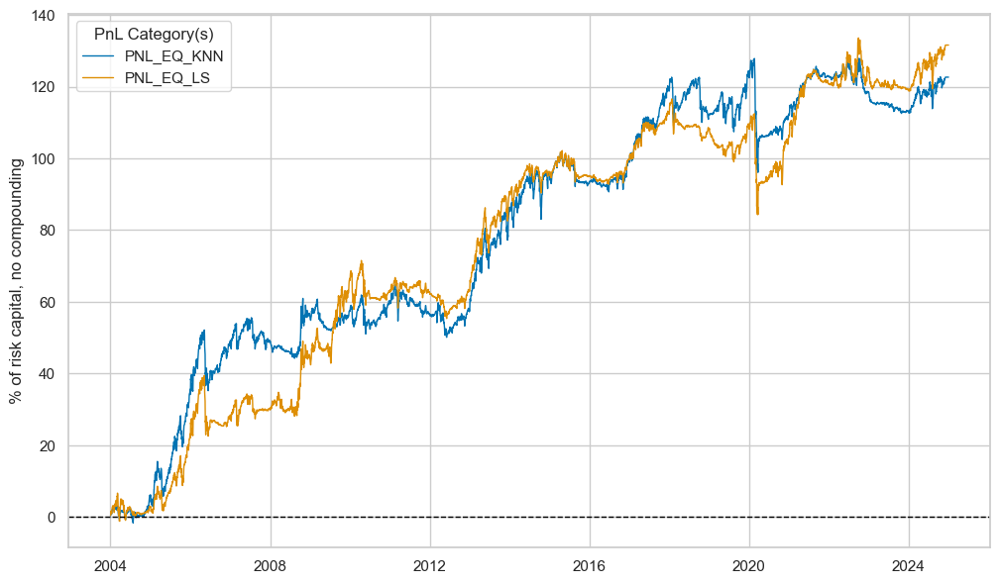

xcat,PNL_EQ_KNN,PNL_EQ_LS
Return %,5.842969,6.269198
St. Dev. %,10.0,10.0
Sharpe Ratio,0.584297,0.62692
Sortino Ratio,0.792041,0.863988
Max 21-Day Draw %,-30.686248,-27.193386
Max 6-Month Draw %,-20.407673,-19.239694
Peak to Trough Draw %,-31.755398,-32.236223
Top 5% Monthly PnL Share,0.633262,0.670943
USD_EQXR_NSA correl,0.273347,0.184682
Traded Months,252,252


In [172]:
pnl_eq_knn = msn.NaivePnL(
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs,
    cids=cids_eq,
    start="2004-01-01",
    bms=["USD_EQXR_NSA"],
)
for sig in sigs:
    pnl_eq_knn.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_eq_knn.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_eq_knn.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [173]:
results_eq_knn = msn.create_results_dataframe(
    title="Performance metrics, KNN vs LS, equity",
    df=dfx,
    ret="EQXR_VT10",
    sigs=sigs_eq_knn,
    cids=cids_eq,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"EQ_LS": "LS", "EQ_KNN": "KNN"},
    slip=1,
)
results_eq_knn

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
KNN,0.583,0.520,0.019,0.009,0.584,0.792,0.273
LS,0.567,0.522,0.064,0.036,0.627,0.864,0.185


#### FX

In [174]:
mods_fx_knn = {
    "knn": KNeighborsRegressor(),
}

grid_fx_knn = {
    "knn": {
        "n_neighbors": [i for i in range(1, 105, 5)],
        "weights": ["uniform", "distance"],
    },
}

As previously, the `SignalOptimizer` class allows for sequential optimization of raw signals based on quantamental features. The features are lagged quantamental indicators, collected in the dataframe `X_fx`, and the targets in `y_fx`, are cumulative returns at the native frequency. Please read [here](https://github.com/macrosynergy/macrosynergy/blob/develop/macrosynergy/learning/signal_optimizer.py) for detailed descriptions and examples. The derived signal is labeled `FX_KNN`.

  0%|          | 0/251 [00:00<?, ?it/s]

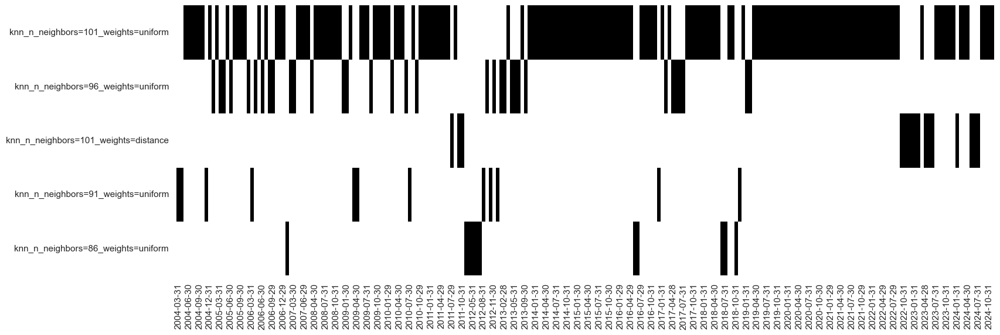

In [175]:
# Calculate predictions
so_fx.calculate_predictions(
    name = "FX_KNN",
    models = mods_fx_knn,
    hyperparameters = grid_fx_knn,
    scorers = {"R2": scorer},
    inner_splitters = {"Rolling": splitter},
    search_type="grid",
    normalize_fold_results=False,
    cv_summary="mean",
    min_cids=4,
    min_periods=36,
    test_size=1,
    n_jobs_outer = -1,
)

# Get optimized signals
dfa = so_fx.get_optimized_signals(name="FX_KNN")
dfx = msm.update_df(dfx, dfa)

# Display model selection heatmap
so_fx.models_heatmap(name="FX_KNN", figsize=(18, 6))

The [`view_timelines()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#visualize-panel-time-series-with-view-timelines) method from the `macrosynergy` package displays both signals `FX_KNN` and `FX_LS`.

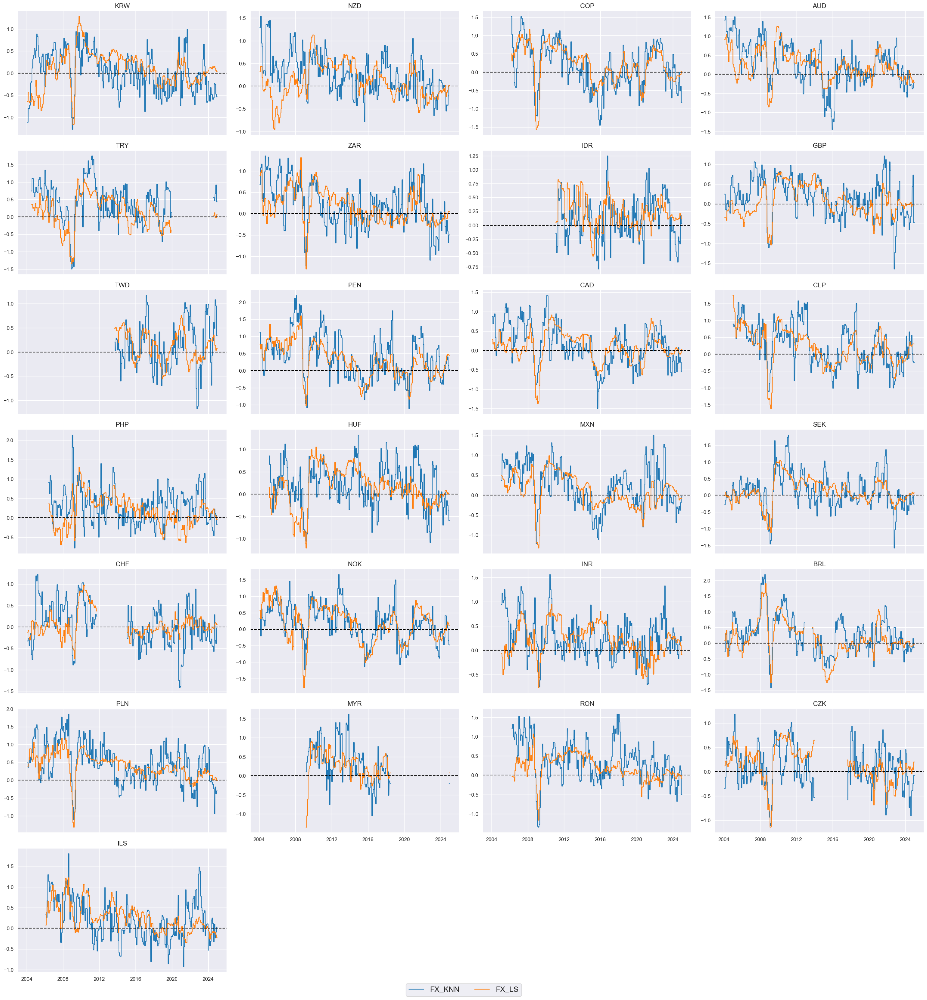

In [176]:
sigs_fx_knn = ["FX_KNN", "FX_LS"]
xcatx = sigs_fx_knn

msp.view_timelines(
    dfx,
    xcats=xcatx,
    cids=cids_fx,
    ncol=4,
    start="2004-01-01",
    title=None,
    title_fontsize=30,
    same_y=False,
    cs_mean=False,
    xcat_labels=None,
    legend_fontsize=16,
)

##### Value checks

The [`SignalReturnRelations`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#signalreturnrelations) class of the `macrosynergy` package facilitates a quick assessment of the power of a signal category in predicting the direction of subsequent returns for data in JPMaQS format.

The [`NaivePnl()`](https://academy.macrosynergy.com/academy/Introductions/Introduction%20to%20Macrosynergy%20package/_build/html/Introduction%20to%20Macrosynergy%20package.php#naivepnl) class is specifically designed to offer a quick and straightforward overview of a simplified Profit and Loss (PnL) profile associated with a set of trading signals. The term "naive" is used because the methods within this class do not factor in transaction costs or position limitations, which may include considerations related to risk management. This omission is intentional because the impact of costs and limitations varies widely depending on factors such as trading size, institutional rules, and regulatory requirements.

For a comparative overview of the signal-return relationship across both signals, one can use the `signals_table()` method.

In [177]:
## Compare optimized signals with simple average z-scores
sigs = sigs_fx_knn

srr_fx_knn = mss.SignalReturnRelations(
    df=dfx,
    rets=["FXXR_VT10"],
    sigs=sigs,
    cids=cids_fx,
    cosp=True,
    freqs=["M"],
    agg_sigs=["last"],
    start="2004-01-01",
    slip=1,
    blacklist=fxblack,
)

srr_fx_knn.signals_table().astype("float").round(3)

accuracy  bal_accuracy  pos_sigr  \
Return    Signal Frequency Aggregation                                     
FXXR_VT10 FX_KNN M         last            0.521         0.512     0.657   
          FX_LS  M         last            0.523         0.514     0.663   

                                        pos_retr  pos_prec  neg_prec  pearson  \
Return    Signal Frequency Aggregation                                          
FXXR_VT10 FX_KNN M         last            0.534     0.542     0.481    0.026   
          FX_LS  M         last            0.534     0.543     0.484    0.022   

                                        pearson_pval  kendall  kendall_pval  \
Return    Signal Frequency Aggregation                                        
FXXR_VT10 FX_KNN M         last                0.051    0.021         0.021   
          FX_LS  M         last                0.104    0.024         0.007   

                                          auc  
Return    Signal Frequency Aggregation         
FXXR_VT10 FX_KNN M         last         0.510  
          FX_LS  M         last         0.512

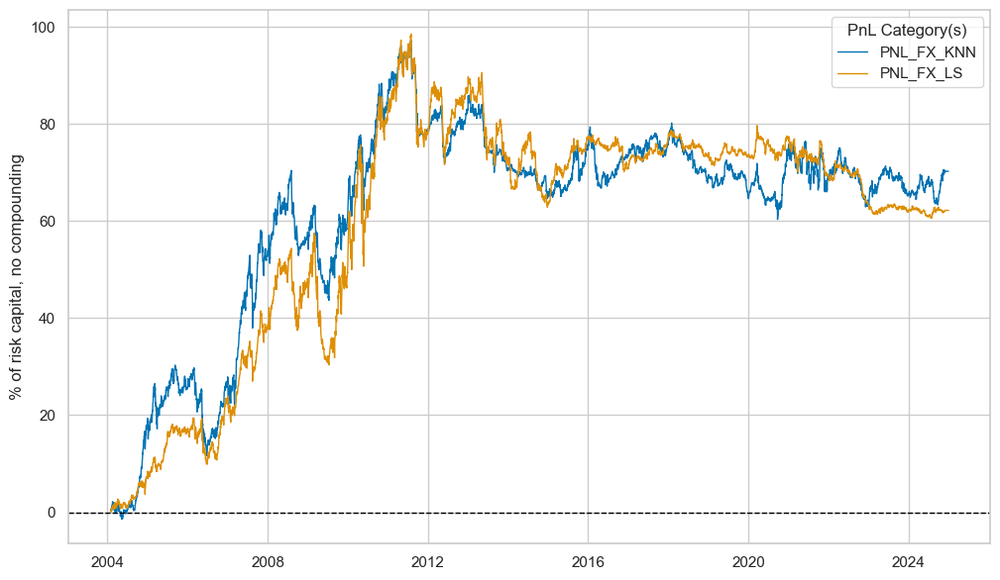

xcat,PNL_FX_KNN,PNL_FX_LS
Return %,3.358268,2.973921
St. Dev. %,10.0,10.0
Sharpe Ratio,0.335827,0.297392
Sortino Ratio,0.458494,0.408613
Max 21-Day Draw %,-15.508816,-24.941009
Max 6-Month Draw %,-17.908257,-23.668059
Peak to Trough Draw %,-36.862212,-37.957949
Top 5% Monthly PnL Share,1.311295,1.501754
USD_EQXR_NSA correl,0.132854,0.100501
Traded Months,252,252


In [178]:
pnl_fx_knn = msn.NaivePnL(
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs,
    cids=cids_fx,
    start="2004-01-01",
    blacklist=fxblack,
    bms=["USD_EQXR_NSA"],
)
for sig in sigs:
    pnl_fx_knn.make_pnl(
        sig=sig,
        sig_op="zn_score_pan",
        rebal_freq="monthly",
        neutral="zero",
        rebal_slip=1,
        vol_scale=10,
        thresh=2,
    )

pnl_fx_knn.plot_pnls(
    title=None,
    title_fontsize=14,
    xcat_labels=None,
)

pnl_fx_knn.evaluate_pnls(pnl_cats=["PNL_" + sig for sig in sigs])

In [179]:
results_fx_knn = msn.create_results_dataframe(
    title="Performance metrics, KNN vs LS, FX",
    df=dfx,
    ret="FXXR_VT10",
    sigs=sigs_fx_knn,
    cids=cids_fx,
    sig_ops="zn_score_pan",
    sig_adds=0,
    neutrals="zero",
    threshs=2,
    bm="USD_EQXR_NSA",
    cosp=True,
    start="2004-01-01",
    freqs="M",
    agg_sigs="last",
    sigs_renamed={"FX_LS": "LS", "FX_KNN": "KNN"},
    slip=1,
    blacklist=fxblack,
)
results_fx_knn

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
KNN,0.521,0.512,0.026,0.021,0.336,0.458,0.133
LS,0.523,0.514,0.022,0.024,0.297,0.409,0.101


#### Comparison

Signals of KNN-based learning are very different from the least squares-based signals. Average performance metrics are worse than for least squares-based signals.

* KNN is for the case of few theoretical clues: KNN-based learning operates with little theory and restrictions: Moreover, key hyperparameters, such as the number of neighbours, lack clear theoretical guidance. This explains why its regression signals are more at the mercy of past experiences and optimal model is changing often. 
* Good features always matter: KNN may be very different from linear regression, but the signals of these two learning methods are still highly correlated and their PnL profiles similar. This hammers home the truth that the detection of a good plausible set of predictors is often far more important than the applied learning method and emphasizes the paramount importance of data quality.

In [180]:
results_knn = (results_du_knn.data + results_eq_knn.data + results_fx_knn.data) / 3
results_knn.style.format("{:.3f}").set_caption(
    "Averaged performance metrics, KNN vs LS"
).set_table_styles(
    [
        {
            "selector": "caption",
            "props": [("text-align", "center"), ("font-weight", "bold")],
        }
    ]
)

,Accuracy,Bal. Accuracy,Pearson,Kendall,Sharpe,Sortino,Market corr.
KNN,0.545,0.515,0.026,0.016,0.430,0.587,0.248
LS,0.541,0.517,0.045,0.029,0.456,0.628,0.252
